<a href="https://colab.research.google.com/github/bominkm/Weather-BigData-Contest/blob/jbeen2/20_LSTM_Sex_Region_hr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# LSTM

## 0. Data Load

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
os.chdir('/content/drive/MyDrive/Projects/weather')

In [3]:
import numpy as np
import pandas as pd
import datetime
from datetime import timedelta
from tqdm.notebook import tqdm
tqdm.pandas()

import random
from functools import reduce

import matplotlib.pyplot as plt
from matplotlib import rc
import seaborn as sns
%matplotlib inline

rc('font', family='MalgunGothic')
plt.rcParams['axes.unicode_minus'] = False

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, LSTM
from sklearn.metrics import mean_squared_error

/usr/local/lib/python3.7/dist-packages/tqdm/std.py:658: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [4]:
import tensorflow as tf

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


In [5]:
import torch 

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
n_gpu = torch.cuda.device_count()
torch.cuda.get_device_name(0)

'Tesla P100-PCIE-16GB'

In [6]:
%%time
df_st = pd.read_csv('stationary_causality.csv', encoding='CP949')    # 정상
df_final = pd.read_csv('final_0622.csv', encoding='CP949')           # 날씨지수
weather = pd.read_csv('weather_final2.csv', encoding='CP949')        # 지역별 날씨
loc_weight = pd.read_csv("population_weight.csv", encoding="CP949")  # 지역별 가중치

CPU times: user 15.7 s, sys: 1.56 s, total: 17.2 s
Wall time: 21.6 s


In [7]:
df_st.head(2)

,sm_cat,avg_ta,hm_max,max_pa,max_ta,min_ta,PM10,PM25,avg_ws,sum_ss_hr,total
0,가스온수기,None,None,None,None,None,causality,None,None,None,1
1,가자미,causality,None,None,None,None,None,None,None,None,1


In [8]:
df_final.head(2)

,date,sex,big_cat,sm_cat,qty,ratio,오늘날씨,미세먼지,오늘 비,기상정보,태풍정보,avg_ta,max_ta,min_ta,rn_day,rn_hr1,avg_ws,PM10,PM25,hm_max,sum_ss_hr,max_pa,공휴일여부,주말여부,연_2019,월_2,월_3,월_4,월_5,월_6,월_7,월_8,월_9,월_10,월_11,월_12,분기_2,분기_3,분기_4,요일_1,요일_2,요일_3,요일_4,요일_5,요일_6,봄,여름,가을,겨울,cnt,age_20,age_30,age_40,age_50,age_60
0,2018-01-01,1,식품,가공란,37.0,0.0,10.69387,4.09137,0.0,0.00000,0.04440,0.885198,5.464146,-2.88074,0.0,0.0,2.157094,44.015611,21.477208,61.923313,52.276365,1020.592385,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0.480964,1,0,0,0,0
1,2018-01-01,1,식품,가공란,16.0,0.0,12.42969,6.35294,0.0,0.51282,0.42417,0.885198,5.464146,-2.88074,0.0,0.0,2.157094,44.015611,21.477208,61.923313,52.276365,1020.592385,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0.480964,0,1,0,0,0


In [9]:
weather.head(2)

,날짜,지점번호,평균기온,최고기온,최저기온,일별강수량,1시간최대강수량,평균풍속,지역,PM10,PM25,1시간최대습도,일조시간합,최고현지기압,연,월,일,분기,요일,공휴일명,공휴일여부,주말여부,계절,체감온도,열지수,폭염여부,강수여부,year,month
0,2018-01-01,105,1.3,5.7,-2.1,0.0,0.0,3.7,강릉,20.066667,13.400000,25.4,57.9,1023.0,2018,1,1,1,0,1월1일,1,0,3,7.502056,-39.701524,0,0,2018,1
1,2018-01-01,112,-0.3,2.7,-2.7,0.0,0.0,1.6,인천,37.518681,18.641758,67.2,53.8,1020.3,2018,1,1,1,0,1월1일,1,0,3,9.992379,-42.924922,0,0,2018,1


In [10]:
loc_weight.head(2)

,시도,final_가중치
0,수도권,0.50
1,강원,0.03


In [11]:
df_st['sm_cat'].unique()

array(['가스온수기', '가자미', '감/홍시', '감말랭이', '갓김치', '건강즙/녹용', '건어물 멸치',
       '건어물 황태', '건자두', '견과류', '견과류 땅콩', '견과류 마카다미아', '견과류 잣/은행',
       '견과류 캐슈넛', '견과류 호두', '계란', '공기정화 용품', '공기청정기', '곶감/반건시',
       '과채 음료/주스', '기능성 링클케어 화장품', '기능성 영양보습 화장품', '기초 화장용 에센스',
       '기초 화장용 오일/앰플', '기타 농산물', '기타 한방/환제품', '나물', '남성 메이크업', '남성 스킨',
       '남성 에센스', '남성 크림', '남성 클렌징', '냉풍기', '네일 메이크업 용품', '네일리무버', '네일세트',
       '네일아트', '네일컬러', '네일케어', '녹차', '닭 양념육', '더치커피', '도라지/더덕', '돈풍기',
       '랍스타', '레몬/자몽', '린스', '립앤아이 리무버', '멀티형 에어컨', '메이크업 박스', '무/배추',
       '바나나/파인애플/망고', '바디 세트', '바디케어용 때비누', '바디케어용 슬리밍', '반건조고구마', '반찬류',
       '배/포도/과일즙', '백김치', '베이스 메이크업 세트', '베이스 메이크업용 BB크림',
       '베이스 메이크업용 CC크림', '베이스 메이크업용 메이크업베이스', '베이스 메이크업용 컨실러',
       '베이스 메이크업용 쿠션팩트', '벽걸이형 냉온풍기', '보일러', '뷰티 속눈썹/쌍꺼풀', '뷰티용 기름종이',
       '뷰티용 뷰러', '뷰티용 여드름압출기', '삼치', '색조 메이크업 립글로스', '색조 메이크업 립스틱',
       '색조 메이크업 마스카라', '색조 메이크업 볼터치', '색조 메이크업 속눈썹영양제',
       '색조 메이크업 쉐딩/하이라이터', '색조 메이크업 아이라이너', '생닭/닭부분육', '생선류'

## 1. LSTM

In [12]:
df_final = df_final.fillna(0)

In [13]:
df_final = df_final.rename(columns={"미세먼지" : "미세먼지검색량"})
weather = weather.rename(columns={"PM10" : "미세먼지"})
weather = weather.rename(columns={"PM25" : "초미세먼지"})

In [14]:
# causality 하나라도 있는 소품목만 선택
df_causal = df_st[df_st['total']!=0].reset_index(drop=True)
df_filter = df_final[df_final.sm_cat.isin(df_causal['sm_cat'])].reset_index(drop=True)
df_causal.drop(['total'], axis=1, inplace=True)

In [15]:
# 데이터 형변환
df_lstm = df_filter.copy()
df_group = df_lstm.groupby(['date','sex','age_20','age_30','age_40','age_50','age_60','sm_cat']).mean().reset_index()
df_group.index = pd.to_datetime(df_group['date'], format='%Y-%m-%d')

In [16]:
def MAPE(y_test, y_pred):
	return np.mean(np.abs((y_test - y_pred) / y_test)) * 100 

In [17]:
def region_weather(loc):
    weather_true = weather.drop(['연', '월', '일', '분기', '요일', '공휴일명', '공휴일여부', '주말여부', '계절', 'year', 'month', '지점번호'], axis=1) 
    weather1 = pd.pivot_table(weather_true[weather_true['지역'] == loc], index='날짜', columns='지역').reset_index(level=0)
    weather1.columns = weather1.columns.get_level_values(0)
    return weather1

In [18]:
def loc_weighted_sum(df1, df2, df3, df4, df5, df6, df7, df8, df9) : 
    df = np.sum([np.multiply(df1, loc_weight.loc[0]["final_가중치"]), np.multiply(df2, loc_weight.loc[1]["final_가중치"]), np.multiply(df3, loc_weight.loc[2]["final_가중치"]), 
                 np.multiply(df4, loc_weight.loc[3]["final_가중치"]), np.multiply(df5, loc_weight.loc[4]["final_가중치"]), np.multiply(df6, loc_weight.loc[5]["final_가중치"]), 
                 np.multiply(df7, loc_weight.loc[6]["final_가중치"]), np.multiply(df8, loc_weight.loc[7]["final_가중치"]), np.multiply(df9, loc_weight.loc[8]["final_가중치"])], axis=0)   
    return df

In [19]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols[::-1], axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

In [20]:
# 지역별 pred 함수
def sm_cat_region_lstm(smcat):
    print('소분류: ', smcat)

    ## 데이터 전처리 ##
    # 각 소분류에 대하여
    df_ex = df_group[df_group['sm_cat']==smcat]

    for regions in ['서울','강릉','대구','부산','광주','전주','대전','청주','제주']:
        # 사용할 변수만 선택
        df_ex = df_ex.rename(columns={"date" : "날짜"})
        default = ['qty', 'ratio','오늘날씨','미세먼지검색량','오늘 비', '기상정보', '태풍정보', 'cnt', '공휴일여부', '주말여부', '날짜']
        causal = []
        df_var = df_causal[df_causal['sm_cat']==smcat]
        for cols in df_var.columns.tolist():
            if len(df_var[df_var[cols]=='causality'])>=1:
                causal.append(cols)
        default.extend(causal)
        df_use = df_ex[default]

        # 지역
        df_merge = df_use.merge(region_weather(regions), on="날짜", how='left')
        df_merge.index = df_merge['날짜']
        df_merge = df_merge.drop(['날짜'], axis=1)

        # 스케일링
        scaler = MinMaxScaler(feature_range=(0, 1))
        df_scale = scaler.fit_transform(df_merge)

        # 데이터 프레임
        n_hours = 7; n_features = df_merge.shape[1]
        df_reframe = series_to_supervised(df_scale, n_hours, 1)

        # 트테분리
        values = df_reframe.values
        n_train_hours = 730 - 90
        train = values[:n_train_hours, :]
        test = values[n_train_hours:, :]
        # split into input and outputs
        n_obs = n_hours * n_features
        train_X, train_y = train[:, :n_obs], train[:, -n_features]
        test_X, test_y = test[:, :n_obs], test[:, -n_features]
        # reshape input to be 3D [samples, timesteps, features]
        train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
        test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
        
        ## 모델링 ##
        # design network
        model = Sequential()
        model.add(LSTM(50, input_shape=(train_X.shape[1], train_X.shape[2])))
        model.add(Dense(1))
        model.compile(loss='mae', optimizer='adam')

        # fit network
        # verbose = 0: 결과 출력 안하는 옵션
        history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=0, shuffle=False)

        # make a prediction
        yhat = model.predict(test_X)
        test_X = test_X.reshape((test_X.shape[0], n_hours*n_features))
        # invert scaling for forecast
        inv_yhat = np.concatenate((yhat, test_X[:, -(n_features-1):]), axis=1)
        inv_yhat = scaler.inverse_transform(inv_yhat)
        inv_yhat = inv_yhat[:,0]
        locals()['pred_'+regions] = inv_yhat
        # invert scaling for actual
        test_y = test_y.reshape((len(test_y), 1))
        inv_y = np.concatenate((test_y, test_X[:, -(n_features-1):]), axis=1)
        inv_y = scaler.inverse_transform(inv_y)
        inv_y = inv_y[:,0]

    # 지역별 가중치 합
    y_pred = loc_weighted_sum(pred_서울, pred_강릉, pred_대구, pred_부산, pred_광주, pred_전주, pred_대전, pred_청주, pred_제주)

    # calculate RMSE
    mse = mean_squared_error(inv_y, y_pred)
    rmse = np.sqrt(mean_squared_error(inv_y, y_pred))
    mape = MAPE(inv_y, y_pred)
    
    # plot predict
    plt.figure(figsize=(15,6))
    plt.plot(df_use.iloc[:n_train_hours,:]['qty'])
    plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, inv_y, label='true')
    plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, y_pred, label='pred')
    plt.legend()
    plt.show()
    print('Test MSE: %.3f' % mse)
    print('Test RMSE: %.3f' % rmse)
    print('Test MAPE: %.3f' % mape)
    print('=========='*10)

In [21]:
date = []; sex_ls = []; age_ls = []; sm_cat = []; pred = []

In [22]:
mse_ls = []; rmse_ls = []; mape_ls = []

In [23]:
# 혜린
df_lstm['sm_cat'].unique()[:29]

array(['가스온수기', '가자미', '감말랭이', '갓김치', '건강즙/녹용', '건어물 멸치', '건어물 황태', '건자두',
       '견과류', '견과류 땅콩', '견과류 마카다미아', '견과류 잣/은행', '견과류 호두', '공기정화 용품',
       '공기청정기', '과채 음료/주스', '기능성 링클케어 화장품', '기능성 영양보습 화장품',
       '기초 화장용 오일/앰플', '기타 농산물', '기타 한방/환제품', '나물', '남성 스킨', '남성 크림',
       '남성 클렌징', '네일리무버', '네일세트', '네일아트', '네일컬러'], dtype=object)

In [24]:
# 재빈
df_lstm['sm_cat'].unique()[29:58]

array(['녹차', '닭 양념육', '더치커피', '돈풍기', '랍스타', '레몬/자몽', '린스', '메이크업 박스',
       '무/배추', '바나나/파인애플/망고', '바디 세트', '반건조고구마', '배/포도/과일즙', '백김치',
       '베이스 메이크업용 BB크림', '베이스 메이크업용 CC크림', '베이스 메이크업용 메이크업베이스',
       '벽걸이형 냉온풍기', '보일러', '뷰티 속눈썹/쌍꺼풀', '뷰티용 기름종이', '뷰티용 뷰러',
       '뷰티용 여드름압출기', '삼치', '색조 메이크업 립글로스', '색조 메이크업 마스카라', '색조 메이크업 볼터치',
       '색조 메이크업 쉐딩/하이라이터', '생수'], dtype=object)

In [25]:
# 보민
df_lstm['sm_cat'].unique()[58:]

array(['샤워코롱', '선크림', '소고기 등심/안심', '수산 생물', '스킨케어 코팩', '아몬드유/코코넛밀크',
       '에이드', '옻/칡/쑥즙', '의류건조기', '이온음료', '인스턴트커피', '전복 생물', '절임배추/김치속',
       '젓갈류', '제습기', '차/곡물 음료', '천장형 에어컨', '카페 푸드', '클렌징 크림', '클렌징 폼',
       '태닝용 선크림', '팩도구', '표고버섯', '풋워시/스크럽', '풋크림', '해조류 다시마',
       '헤어스타일링용 펌제', '헤어케어세트', '홍어', '화장 비누', '멀티형 에어컨'], dtype=object)

In [26]:
df_lstm['sm_cat'].unique()

array(['가스온수기', '가자미', '감말랭이', '갓김치', '건강즙/녹용', '건어물 멸치', '건어물 황태', '건자두',
       '견과류', '견과류 땅콩', '견과류 마카다미아', '견과류 잣/은행', '견과류 호두', '공기정화 용품',
       '공기청정기', '과채 음료/주스', '기능성 링클케어 화장품', '기능성 영양보습 화장품',
       '기초 화장용 오일/앰플', '기타 농산물', '기타 한방/환제품', '나물', '남성 스킨', '남성 크림',
       '남성 클렌징', '네일리무버', '네일세트', '네일아트', '네일컬러', '녹차', '닭 양념육', '더치커피',
       '돈풍기', '랍스타', '레몬/자몽', '린스', '메이크업 박스', '무/배추', '바나나/파인애플/망고',
       '바디 세트', '반건조고구마', '배/포도/과일즙', '백김치', '베이스 메이크업용 BB크림',
       '베이스 메이크업용 CC크림', '베이스 메이크업용 메이크업베이스', '벽걸이형 냉온풍기', '보일러',
       '뷰티 속눈썹/쌍꺼풀', '뷰티용 기름종이', '뷰티용 뷰러', '뷰티용 여드름압출기', '삼치',
       '색조 메이크업 립글로스', '색조 메이크업 마스카라', '색조 메이크업 볼터치', '색조 메이크업 쉐딩/하이라이터',
       '생수', '샤워코롱', '선크림', '소고기 등심/안심', '수산 생물', '스킨케어 코팩', '아몬드유/코코넛밀크',
       '에이드', '옻/칡/쑥즙', '의류건조기', '이온음료', '인스턴트커피', '전복 생물', '절임배추/김치속',
       '젓갈류', '제습기', '차/곡물 음료', '천장형 에어컨', '카페 푸드', '클렌징 크림', '클렌징 폼',
       '태닝용 선크림', '팩도구', '표고버섯', '풋워시/스크럽', '풋크림', '해조류 다시마',
       '헤어스타일링용 펌제', '헤어케어세트', '홍어',

소분류:  가스온수기
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
findfont: Font family ['MalgunGothic'] not found. Falling back to DejaVu Sans.


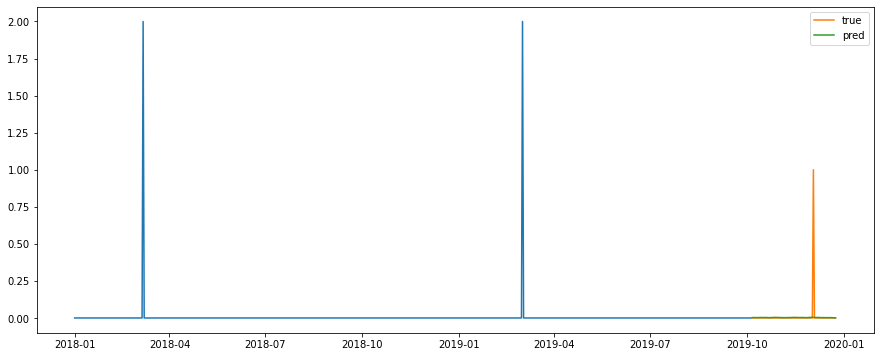

Test MSE: 0.012
Test RMSE: 0.111
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


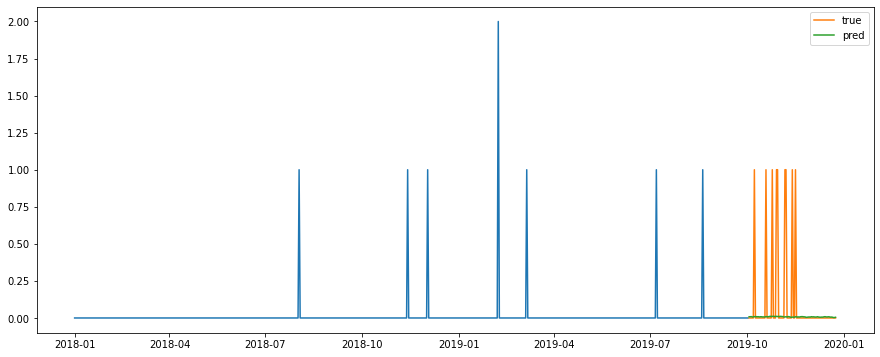

Test MSE: 0.107
Test RMSE: 0.326
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


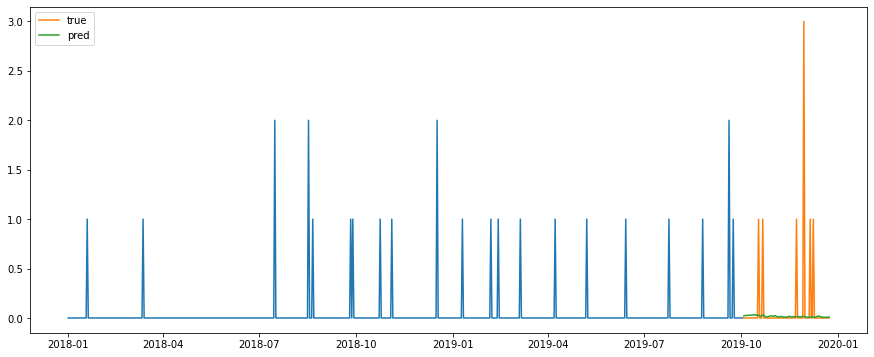

Test MSE: 0.168
Test RMSE: 0.410
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


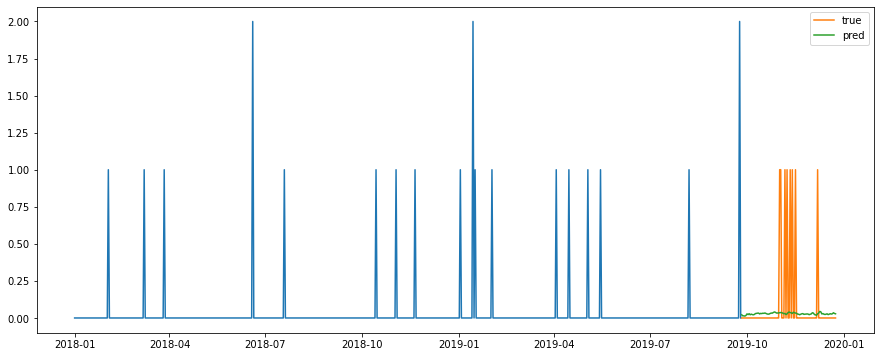

Test MSE: 0.084
Test RMSE: 0.290
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


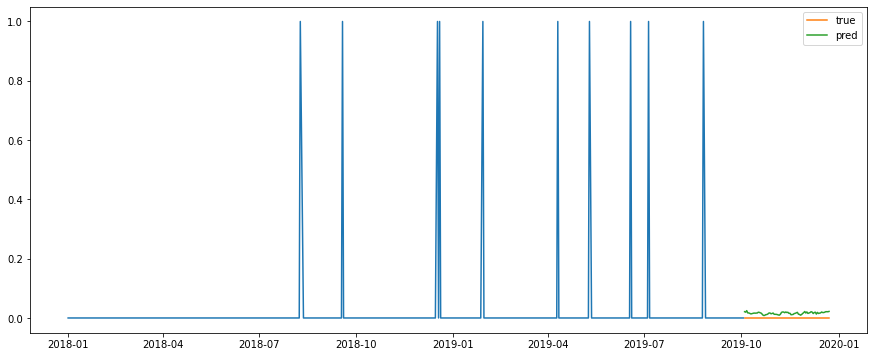

Test MSE: 0.000
Test RMSE: 0.017
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


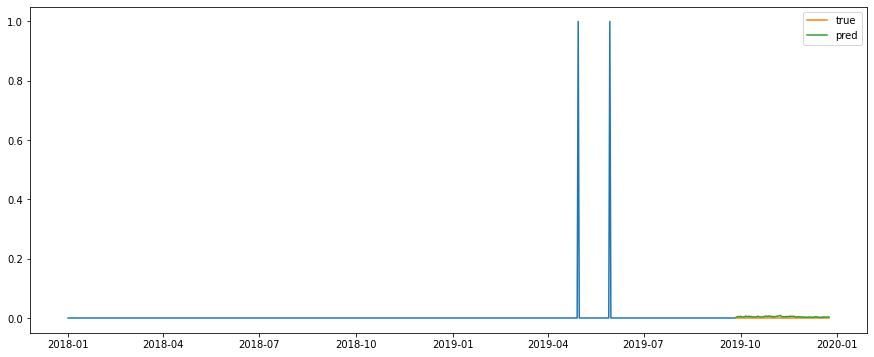

Test MSE: 0.000
Test RMSE: 0.004
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


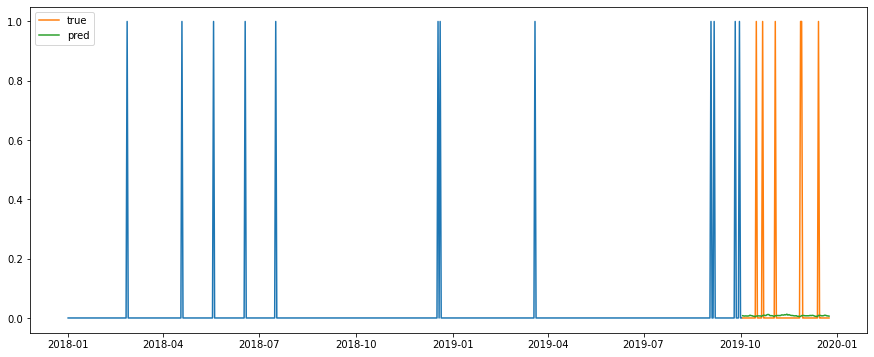

Test MSE: 0.071
Test RMSE: 0.267
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


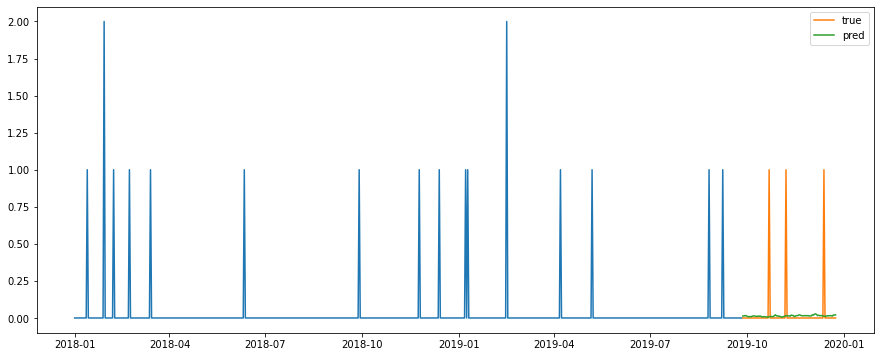

Test MSE: 0.033
Test RMSE: 0.182
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


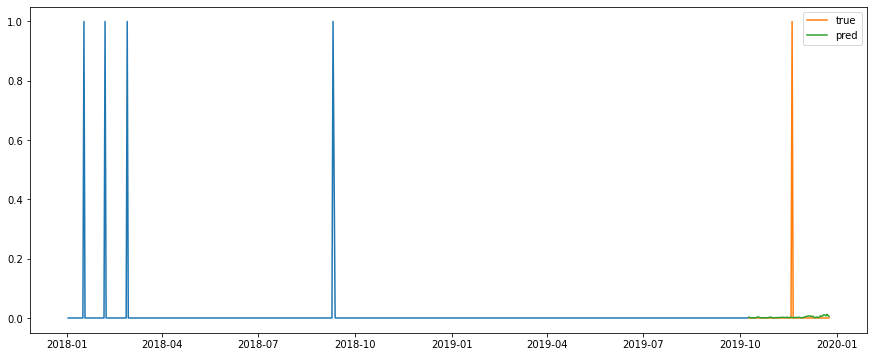

Test MSE: 0.014
Test RMSE: 0.116
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


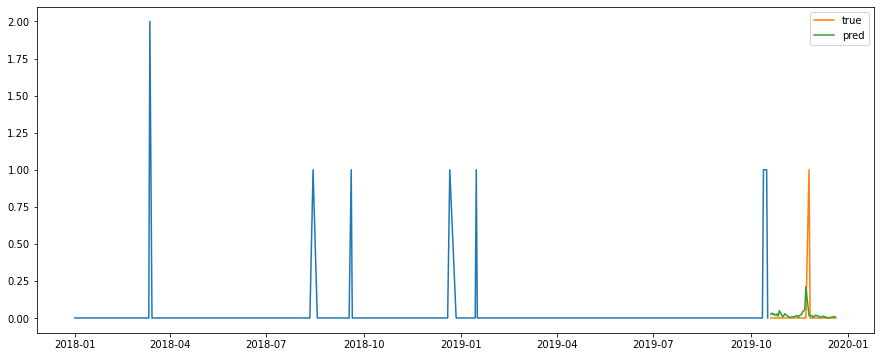

Test MSE: 0.025
Test RMSE: 0.157
Test MAPE: inf
소분류:  가자미
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


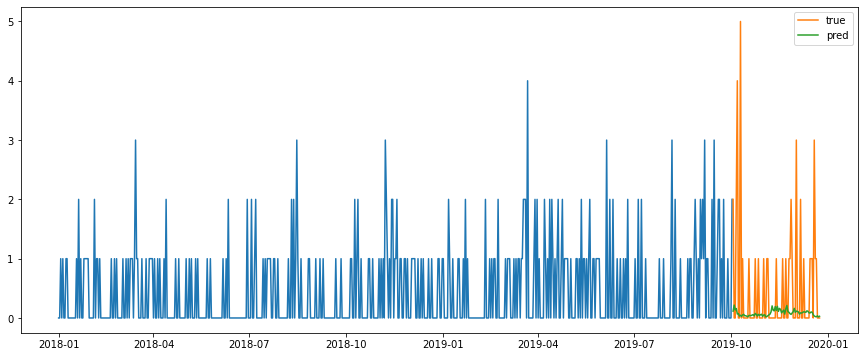

Test MSE: 1.065
Test RMSE: 1.032
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


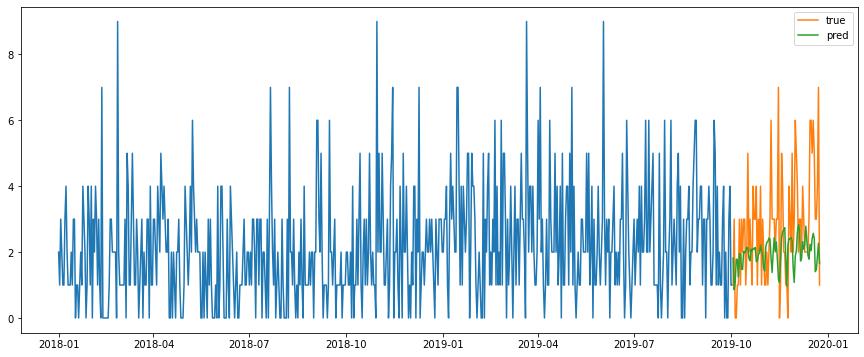

Test MSE: 3.156
Test RMSE: 1.776
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


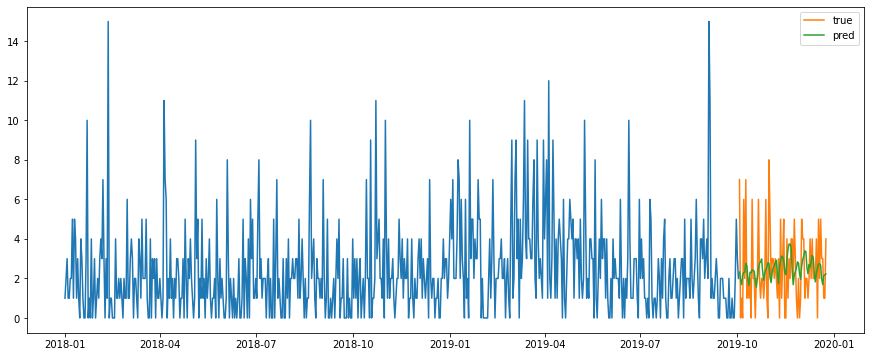

Test MSE: 3.496
Test RMSE: 1.870
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


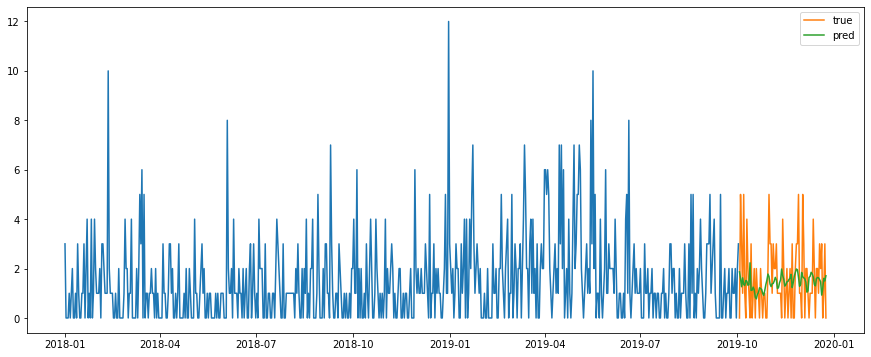

Test MSE: 2.037
Test RMSE: 1.427
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


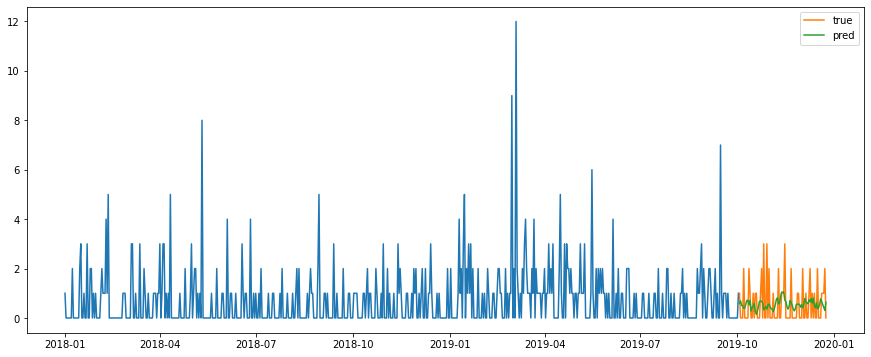

Test MSE: 0.743
Test RMSE: 0.862
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


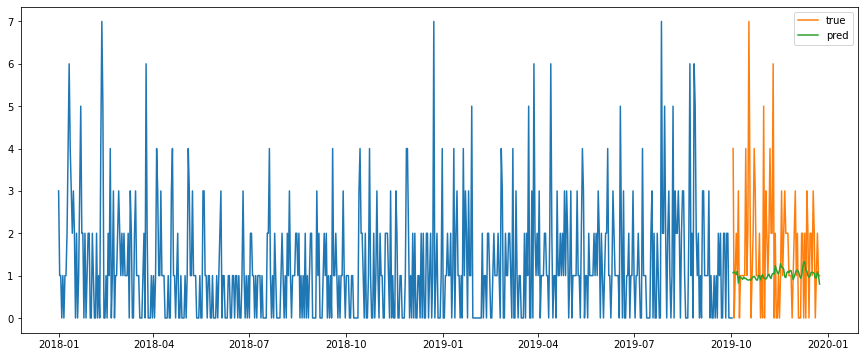

Test MSE: 2.306
Test RMSE: 1.518
Test MAPE: inf
성별:  여성  , 연령:  30대


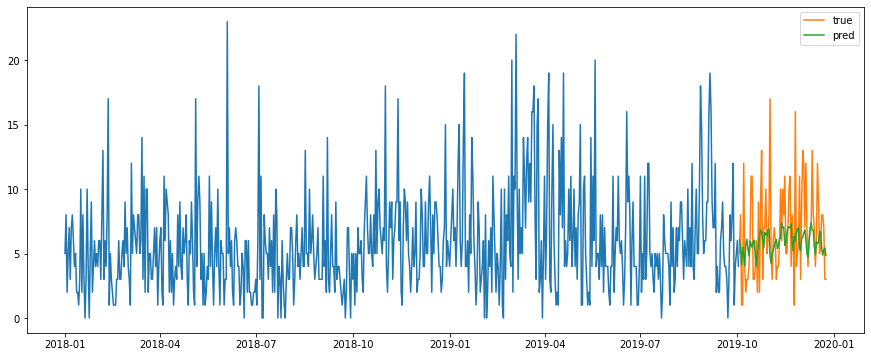

Test MSE: 12.111
Test RMSE: 3.480
Test MAPE: 55.767
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


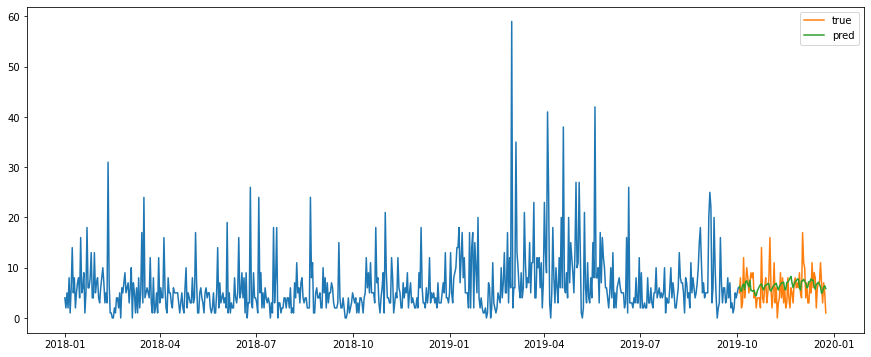

Test MSE: 10.313
Test RMSE: 3.211
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


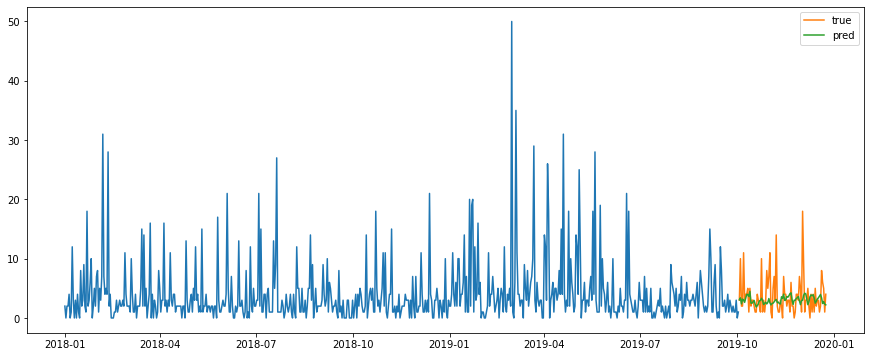

Test MSE: 10.888
Test RMSE: 3.300
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


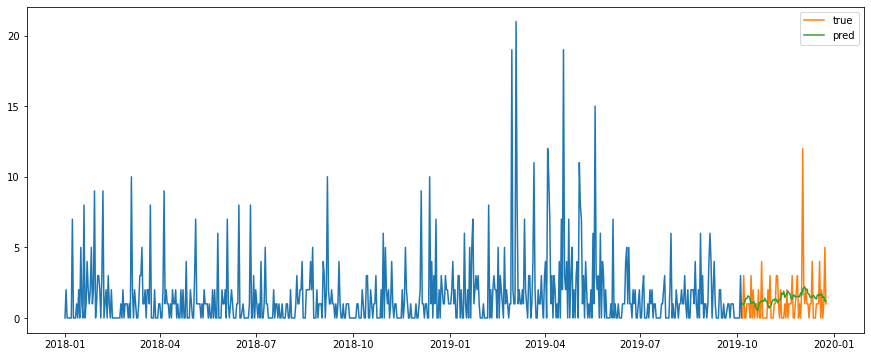

Test MSE: 2.931
Test RMSE: 1.712
Test MAPE: inf
소분류:  감말랭이
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


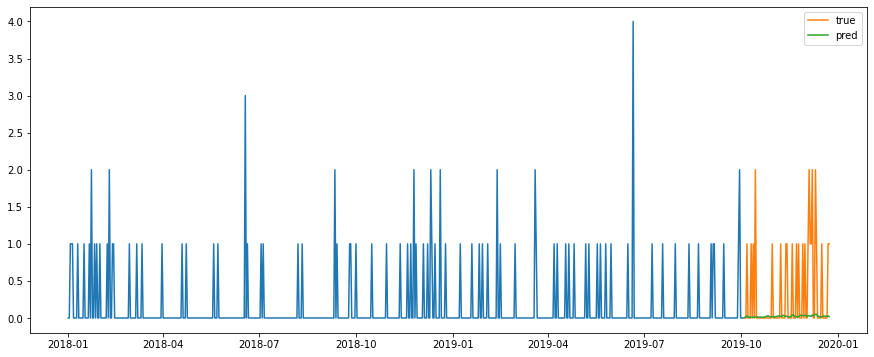

Test MSE: 0.415
Test RMSE: 0.644
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


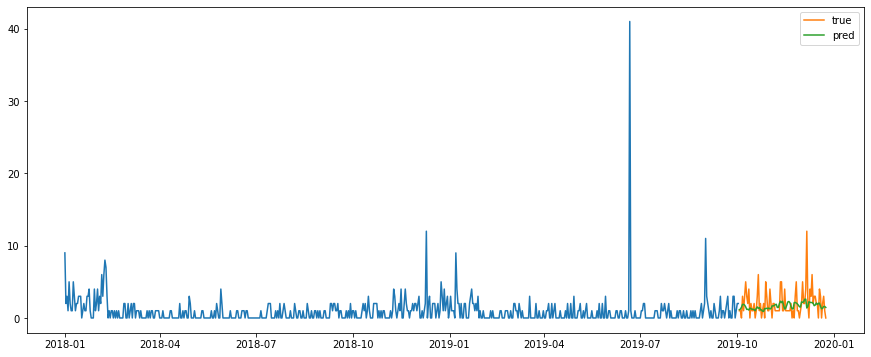

Test MSE: 3.754
Test RMSE: 1.938
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


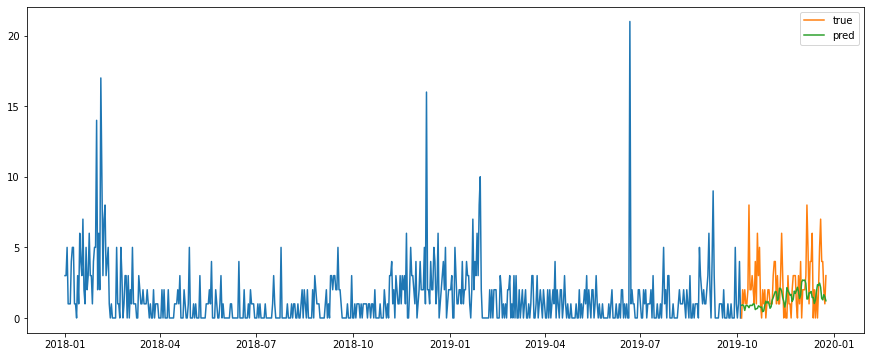

Test MSE: 4.438
Test RMSE: 2.107
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


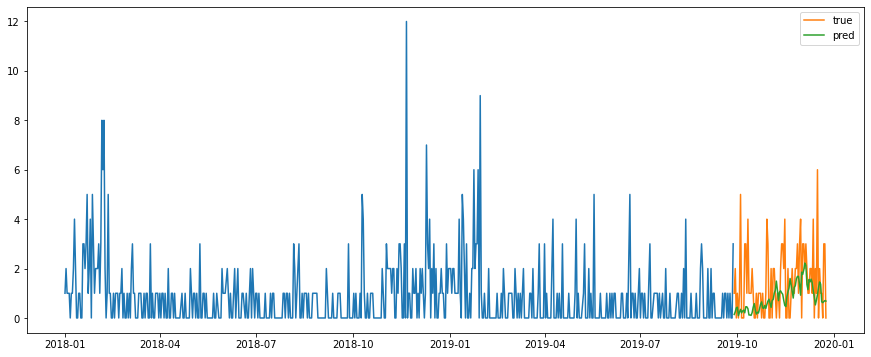

Test MSE: 2.215
Test RMSE: 1.488
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


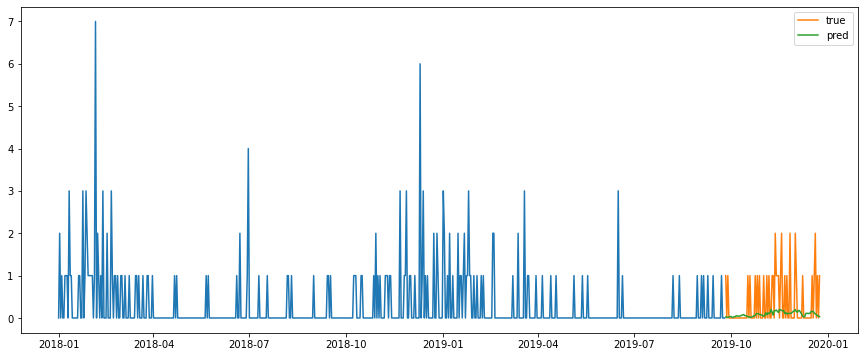

Test MSE: 0.419
Test RMSE: 0.647
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


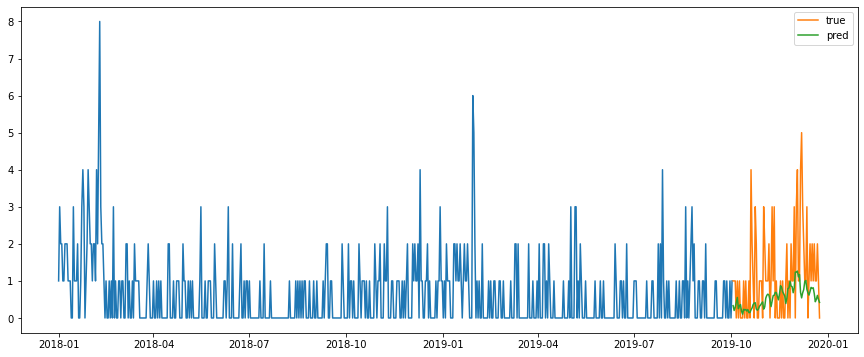

Test MSE: 1.648
Test RMSE: 1.284
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


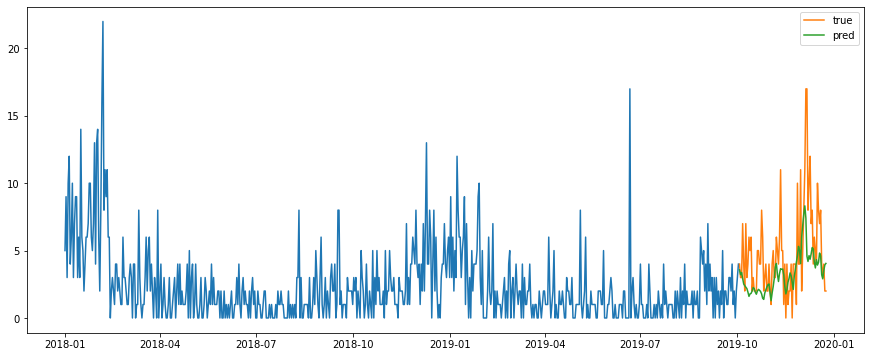

Test MSE: 10.431
Test RMSE: 3.230
Test MAPE: inf
성별:  여성  , 연령:  40대


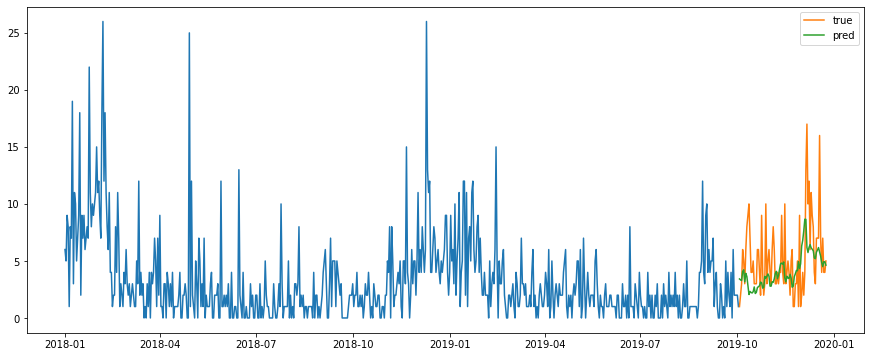

Test MSE: 10.917
Test RMSE: 3.304
Test MAPE: 57.876
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


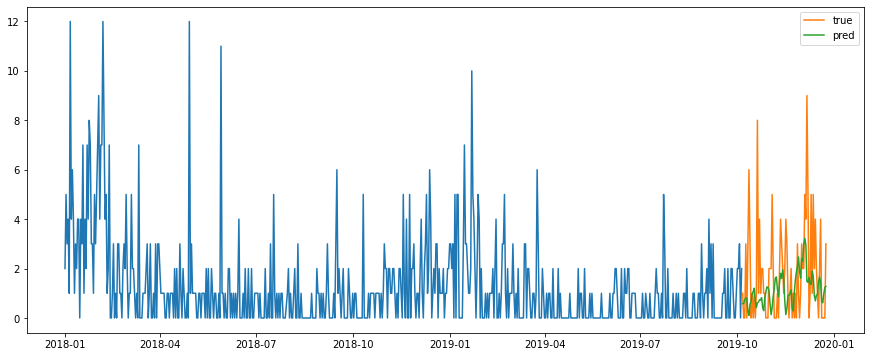

Test MSE: 4.293
Test RMSE: 2.072
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


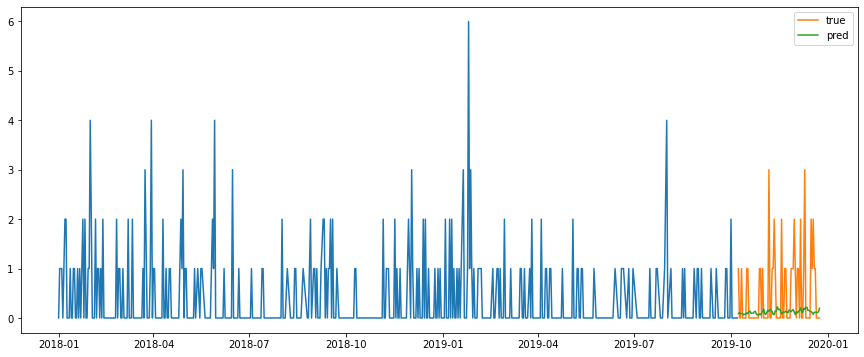

Test MSE: 0.714
Test RMSE: 0.845
Test MAPE: inf
소분류:  갓김치
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


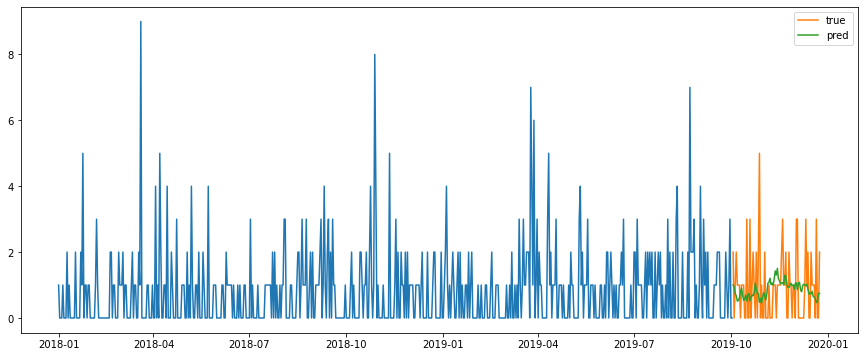

Test MSE: 1.202
Test RMSE: 1.097
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


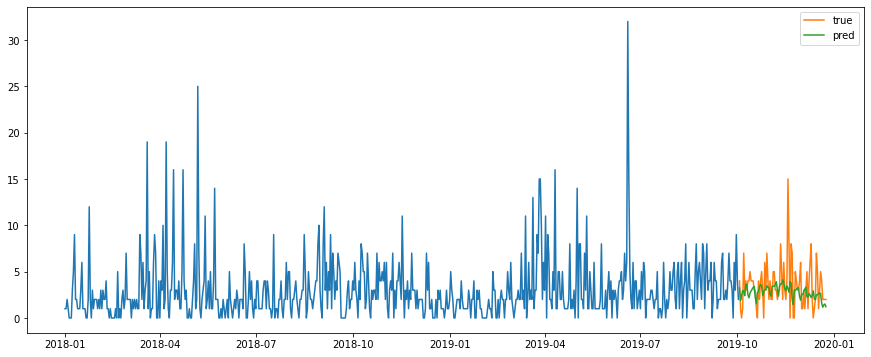

Test MSE: 6.145
Test RMSE: 2.479
Test MAPE: inf
성별:  남성 , 연령:  40대


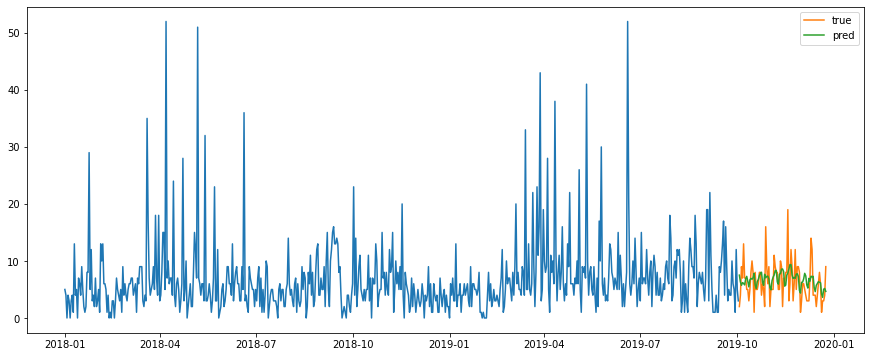

Test MSE: 10.380
Test RMSE: 3.222
Test MAPE: 64.148
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


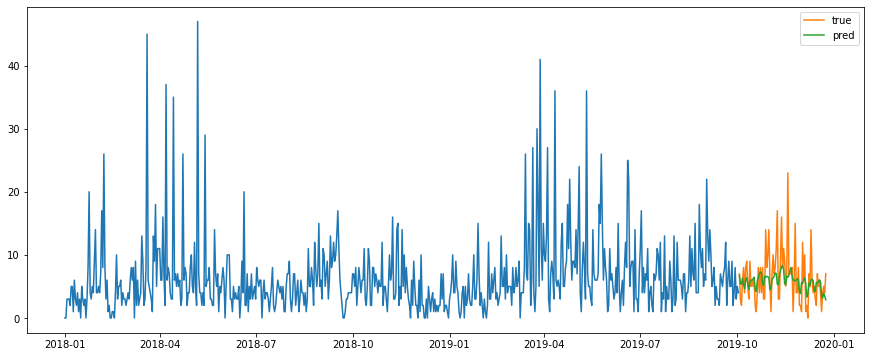

Test MSE: 14.159
Test RMSE: 3.763
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


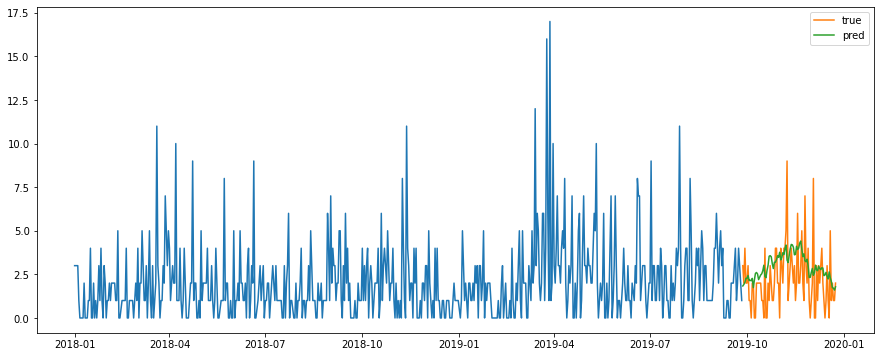

Test MSE: 3.277
Test RMSE: 1.810
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


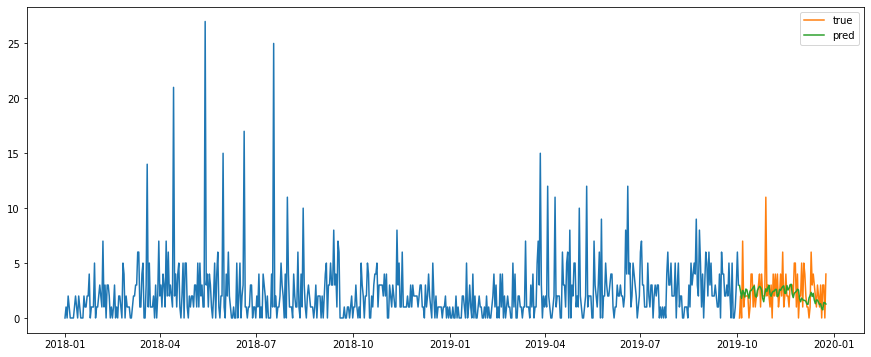

Test MSE: 3.260
Test RMSE: 1.806
Test MAPE: inf
성별:  여성  , 연령:  30대


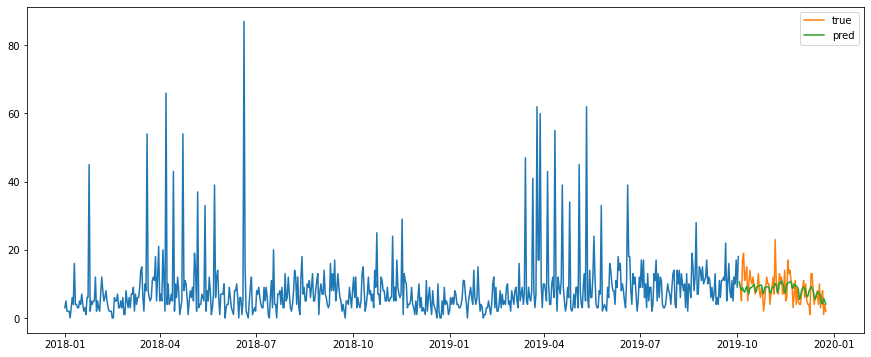

Test MSE: 12.684
Test RMSE: 3.561
Test MAPE: 51.125
성별:  여성  , 연령:  40대


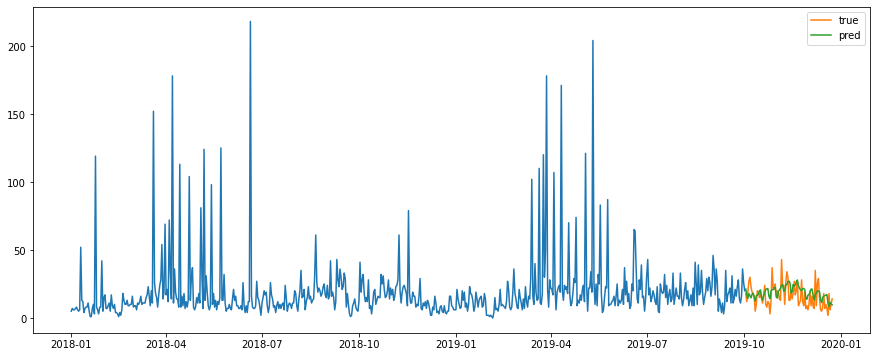

Test MSE: 61.631
Test RMSE: 7.851
Test MAPE: 61.747
성별:  여성  , 연령:  50대


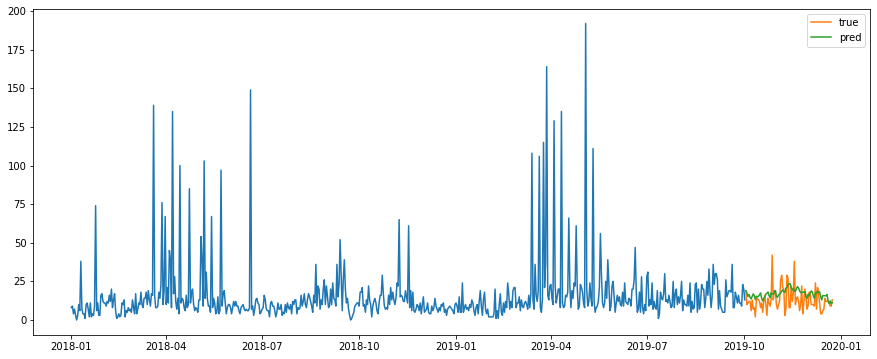

Test MSE: 60.455
Test RMSE: 7.775
Test MAPE: 79.116
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


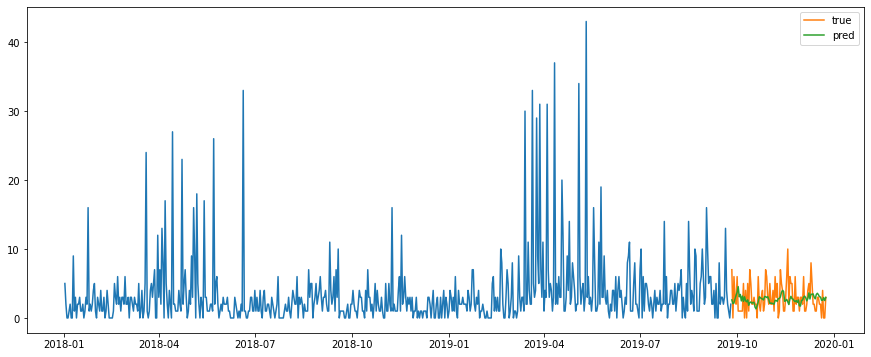

Test MSE: 5.023
Test RMSE: 2.241
Test MAPE: inf
소분류:  건강즙/녹용
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


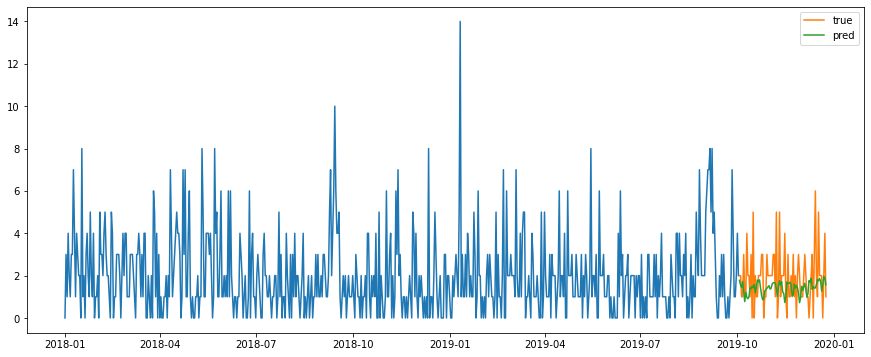

Test MSE: 1.984
Test RMSE: 1.409
Test MAPE: inf
성별:  남성 , 연령:  30대


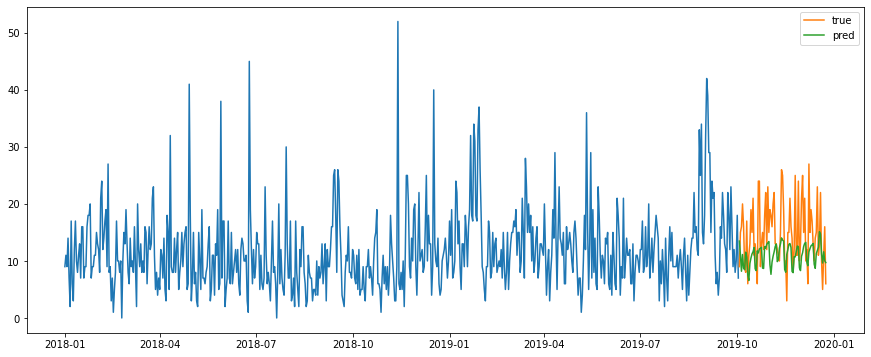

Test MSE: 41.251
Test RMSE: 6.423
Test MAPE: 34.366
성별:  남성 , 연령:  40대


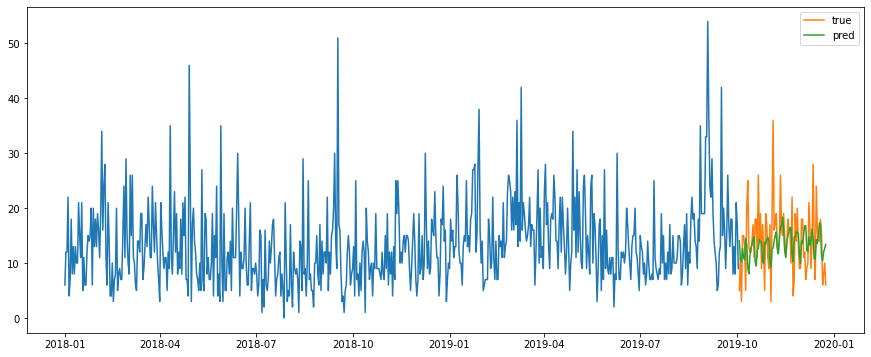

Test MSE: 35.861
Test RMSE: 5.988
Test MAPE: 41.772
성별:  남성 , 연령:  50대


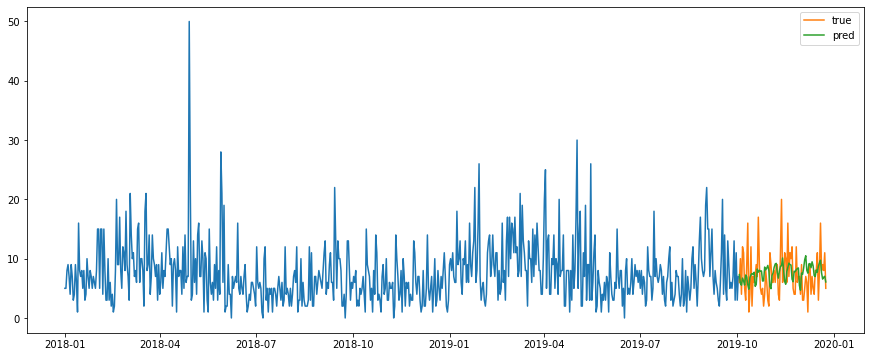

Test MSE: 15.184
Test RMSE: 3.897
Test MAPE: 66.573
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


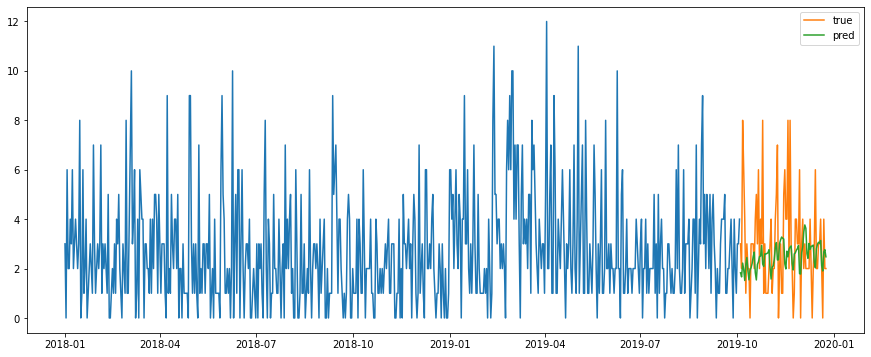

Test MSE: 4.277
Test RMSE: 2.068
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


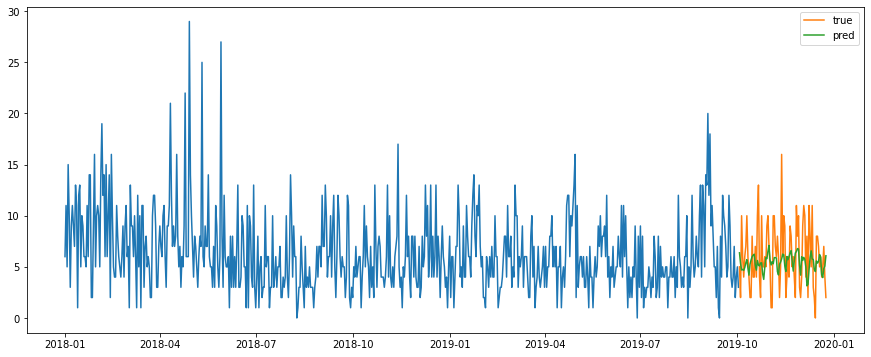

Test MSE: 9.777
Test RMSE: 3.127
Test MAPE: inf
성별:  여성  , 연령:  30대


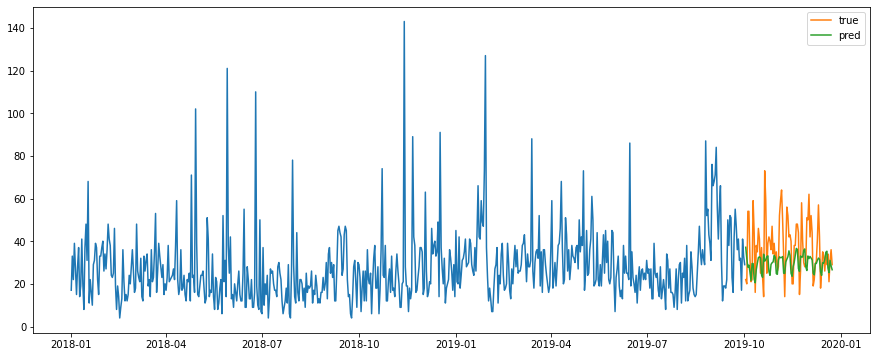

Test MSE: 206.248
Test RMSE: 14.361
Test MAPE: 29.656
성별:  여성  , 연령:  40대


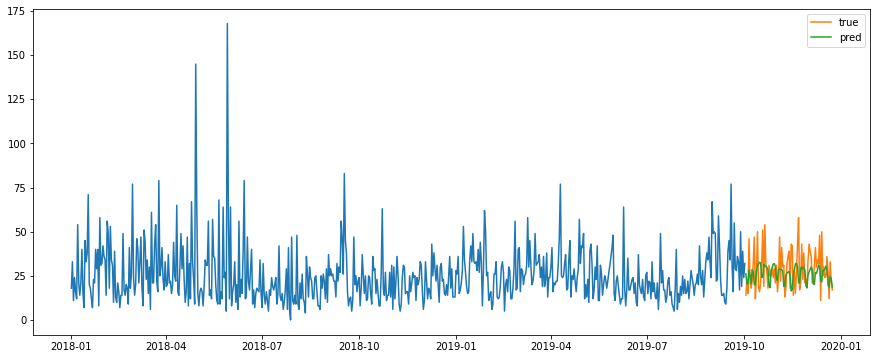

Test MSE: 139.570
Test RMSE: 11.814
Test MAPE: 33.413
성별:  여성  , 연령:  50대


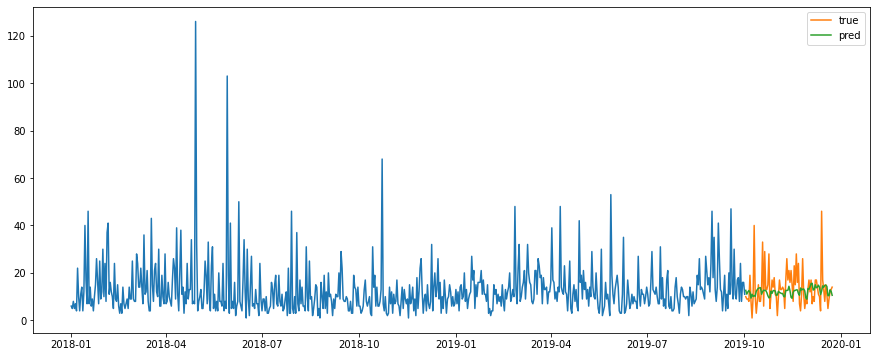

Test MSE: 64.733
Test RMSE: 8.046
Test MAPE: 59.726
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


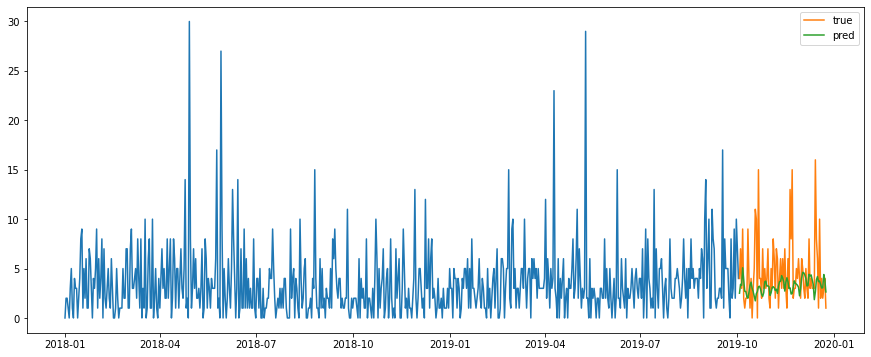

Test MSE: 13.899
Test RMSE: 3.728
Test MAPE: inf
소분류:  건어물 멸치
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


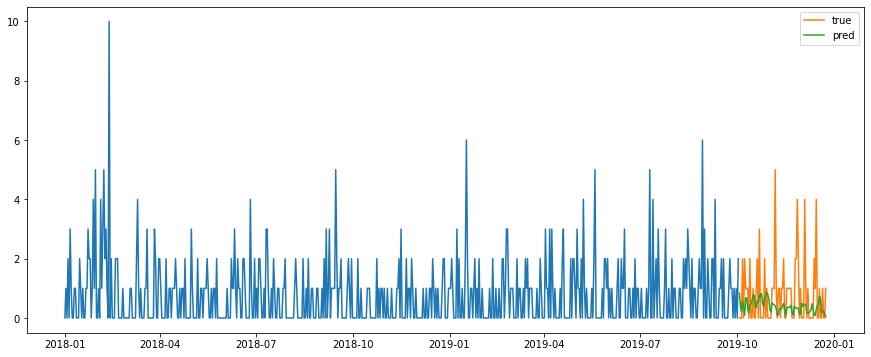

Test MSE: 1.337
Test RMSE: 1.156
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


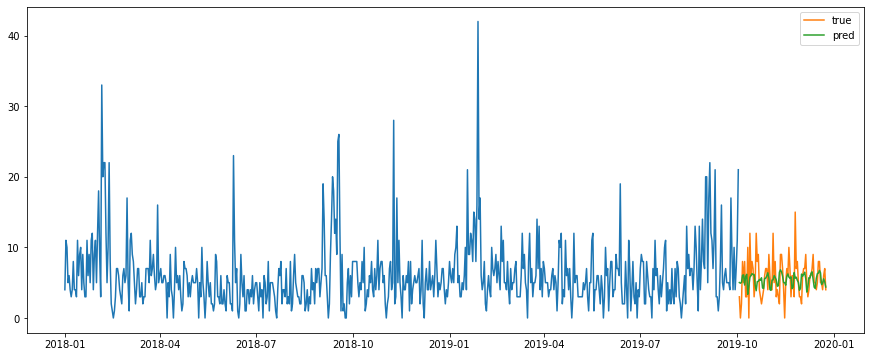

Test MSE: 7.901
Test RMSE: 2.811
Test MAPE: inf
성별:  남성 , 연령:  40대


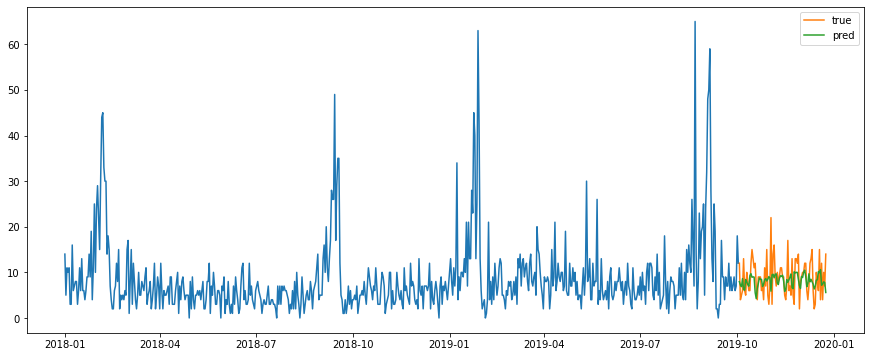

Test MSE: 16.937
Test RMSE: 4.115
Test MAPE: 47.009
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


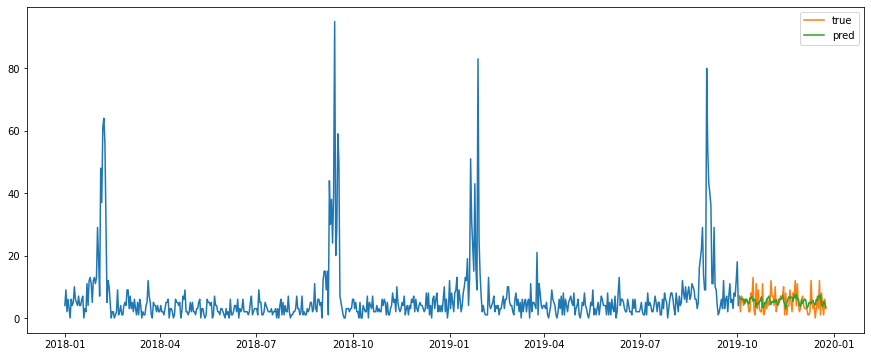

Test MSE: 11.445
Test RMSE: 3.383
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


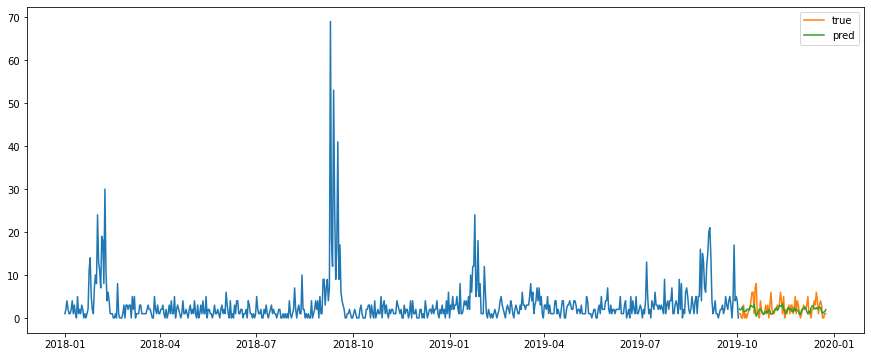

Test MSE: 3.653
Test RMSE: 1.911
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


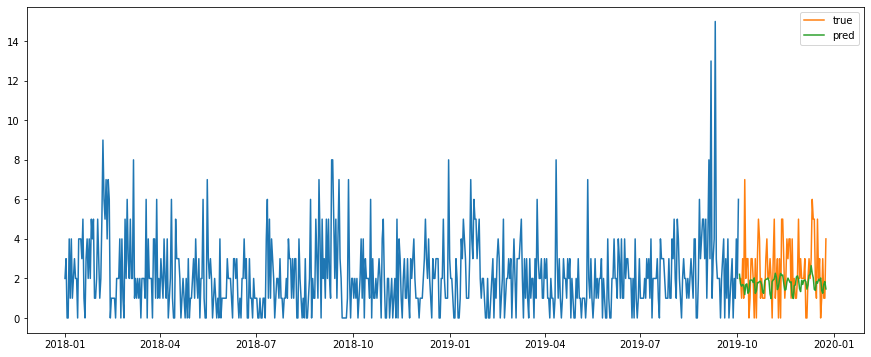

Test MSE: 2.846
Test RMSE: 1.687
Test MAPE: inf
성별:  여성  , 연령:  30대


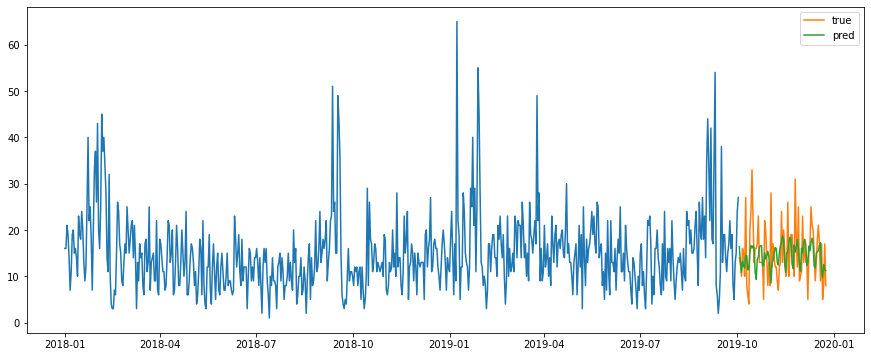

Test MSE: 34.600
Test RMSE: 5.882
Test MAPE: 35.983
성별:  여성  , 연령:  40대


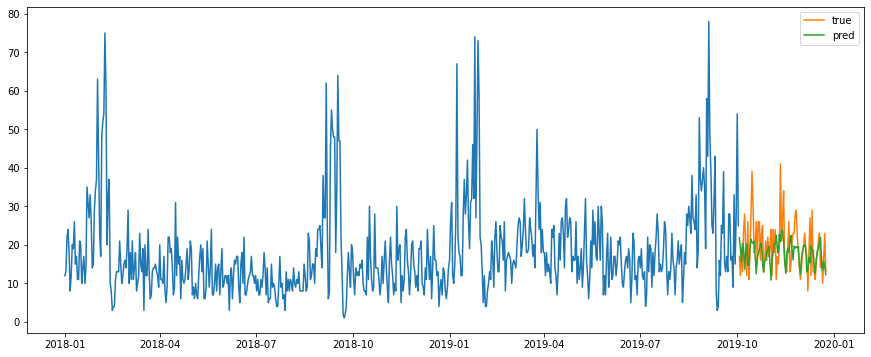

Test MSE: 43.003
Test RMSE: 6.558
Test MAPE: 25.121
성별:  여성  , 연령:  50대


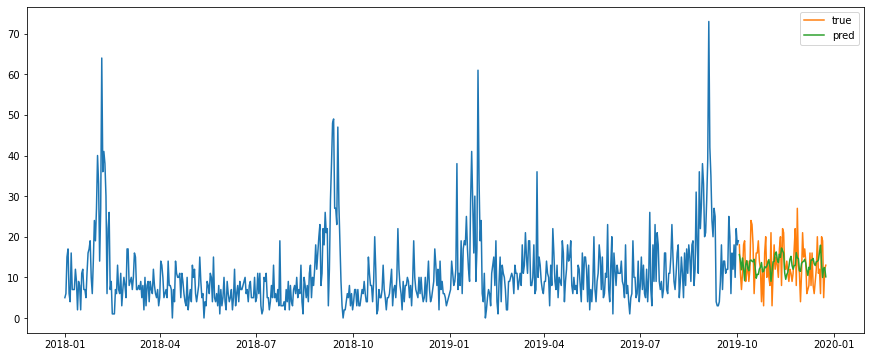

Test MSE: 30.005
Test RMSE: 5.478
Test MAPE: 47.717
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


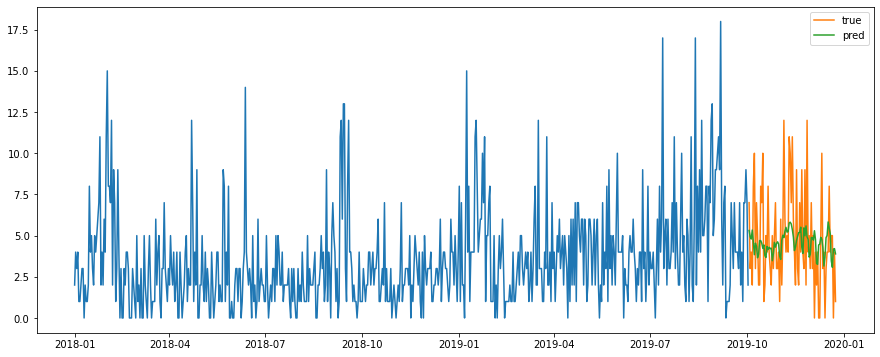

Test MSE: 8.102
Test RMSE: 2.846
Test MAPE: inf
소분류:  건어물 황태
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


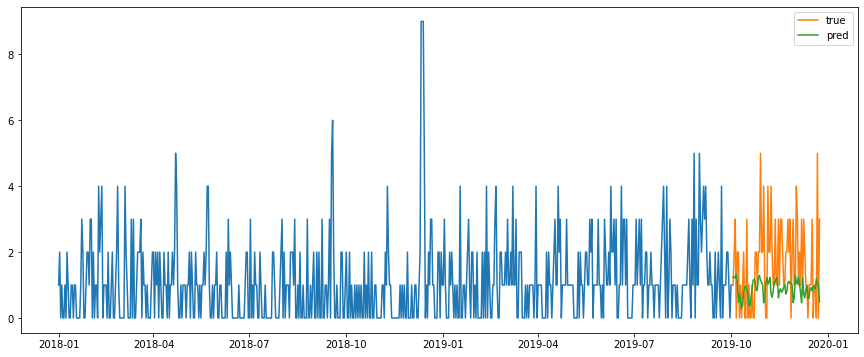

Test MSE: 2.150
Test RMSE: 1.466
Test MAPE: inf
성별:  남성 , 연령:  30대


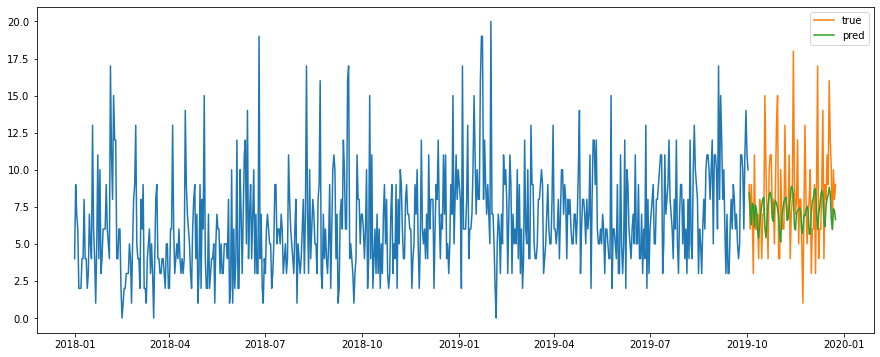

Test MSE: 11.797
Test RMSE: 3.435
Test MAPE: 39.478
성별:  남성 , 연령:  40대


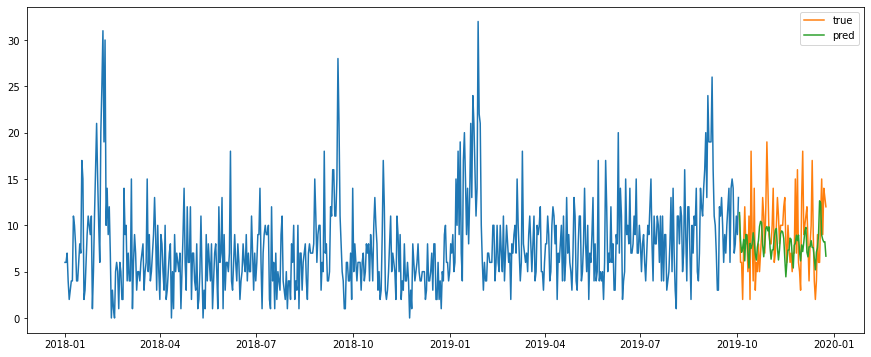

Test MSE: 16.405
Test RMSE: 4.050
Test MAPE: 42.542
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


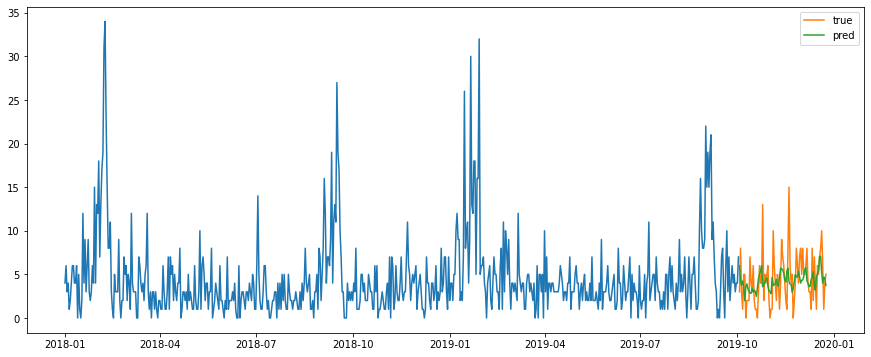

Test MSE: 8.066
Test RMSE: 2.840
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


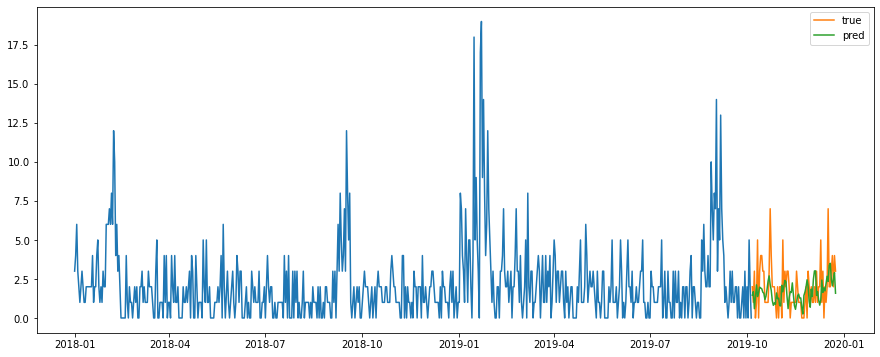

Test MSE: 2.482
Test RMSE: 1.576
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


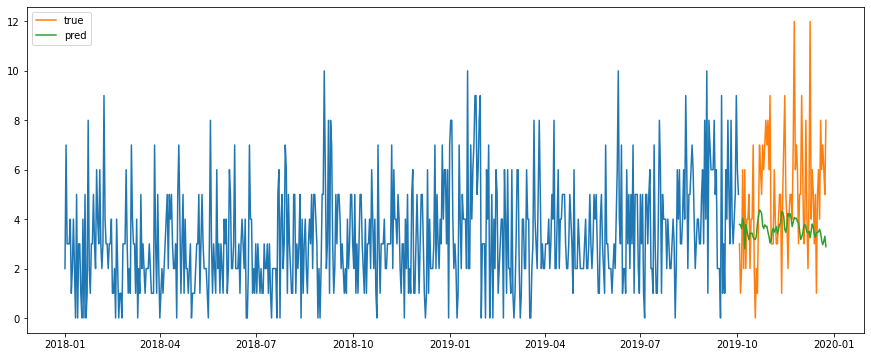

Test MSE: 7.415
Test RMSE: 2.723
Test MAPE: inf
성별:  여성  , 연령:  30대


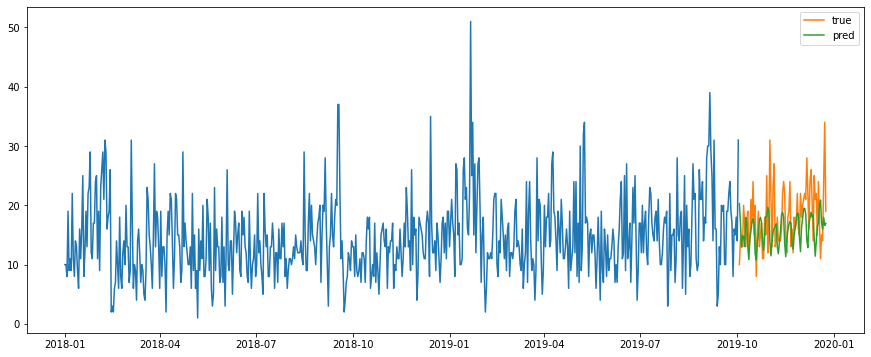

Test MSE: 32.560
Test RMSE: 5.706
Test MAPE: 23.367
성별:  여성  , 연령:  40대


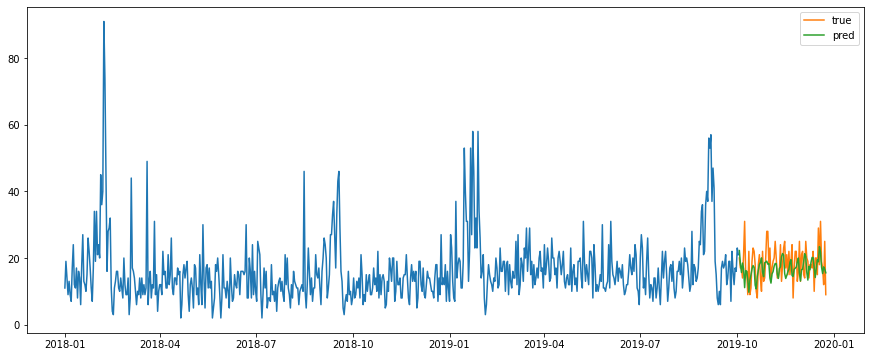

Test MSE: 31.583
Test RMSE: 5.620
Test MAPE: 25.945
성별:  여성  , 연령:  50대


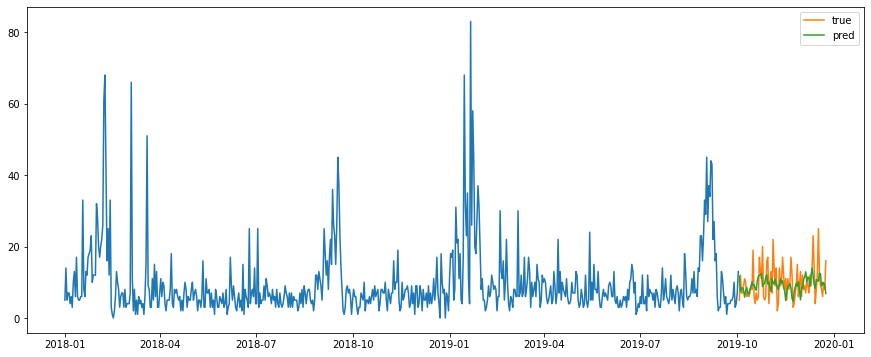

Test MSE: 23.229
Test RMSE: 4.820
Test MAPE: 44.297
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


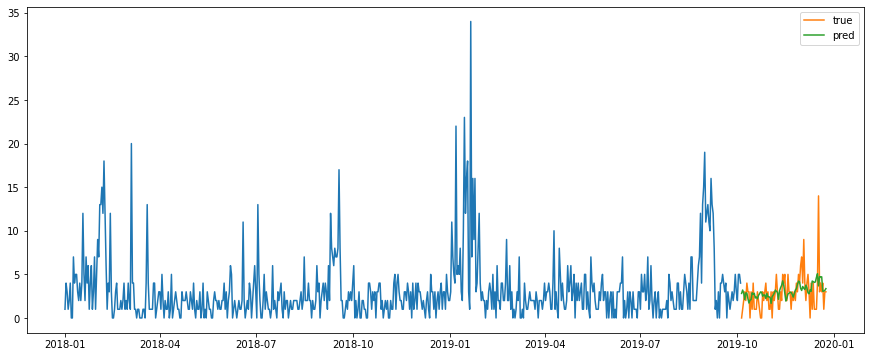

Test MSE: 4.209
Test RMSE: 2.052
Test MAPE: inf
소분류:  건자두
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


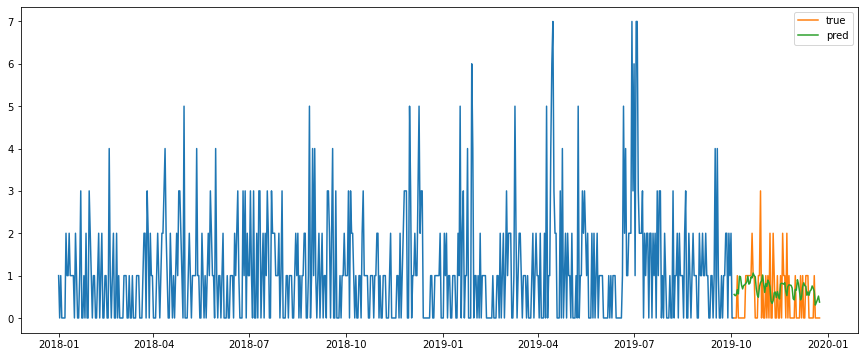

Test MSE: 0.460
Test RMSE: 0.678
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


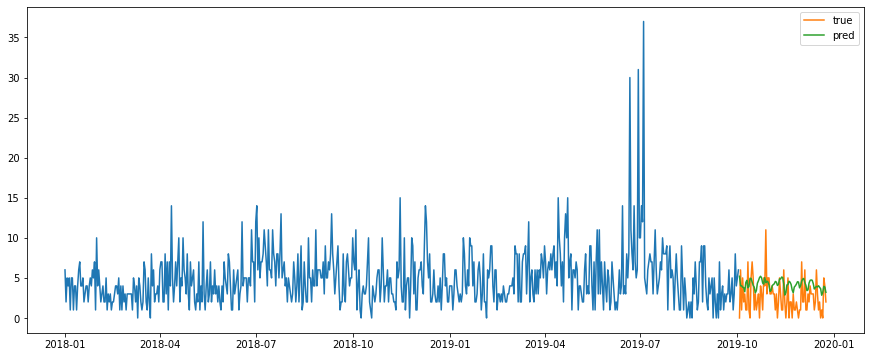

Test MSE: 6.694
Test RMSE: 2.587
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


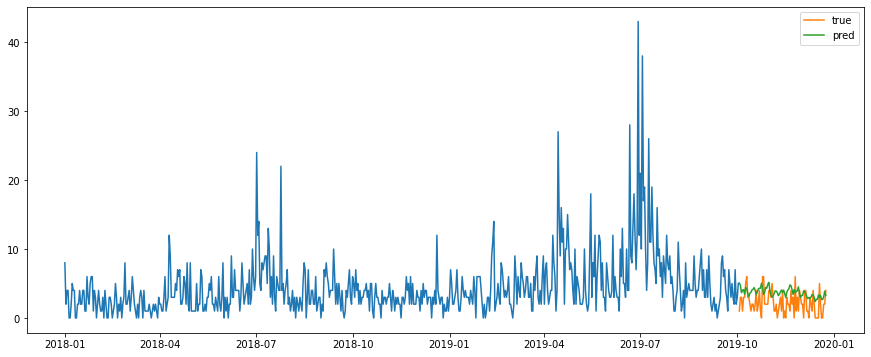

Test MSE: 4.937
Test RMSE: 2.222
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


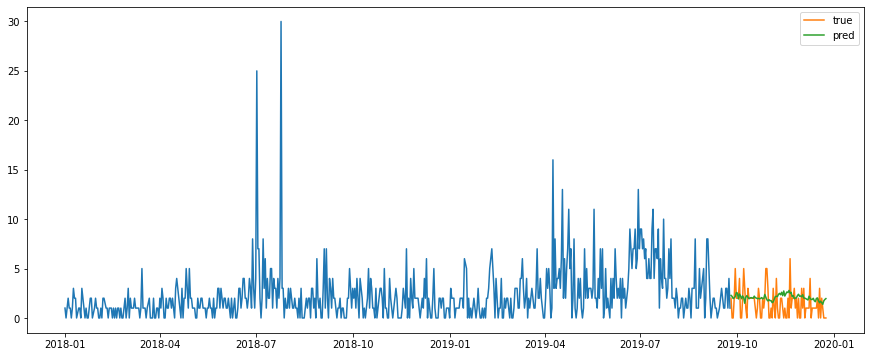

Test MSE: 2.483
Test RMSE: 1.576
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


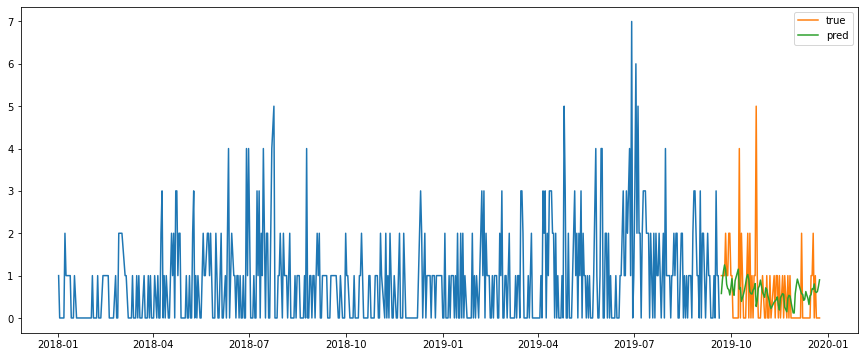

Test MSE: 0.854
Test RMSE: 0.924
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


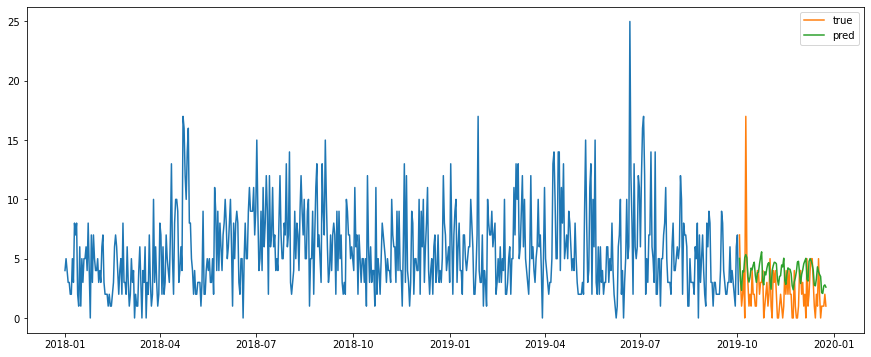

Test MSE: 6.964
Test RMSE: 2.639
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


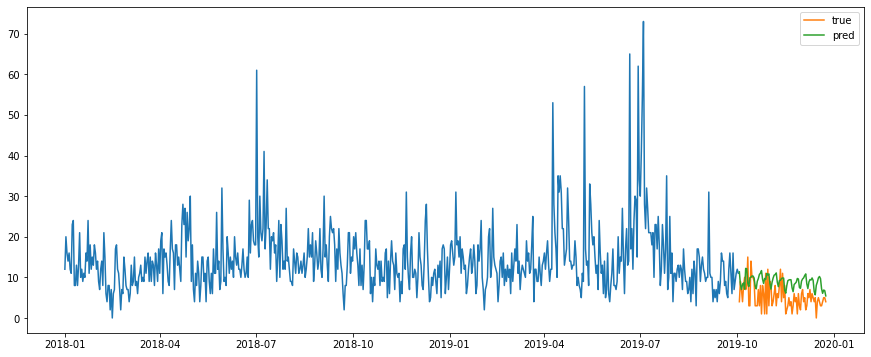

Test MSE: 23.384
Test RMSE: 4.836
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


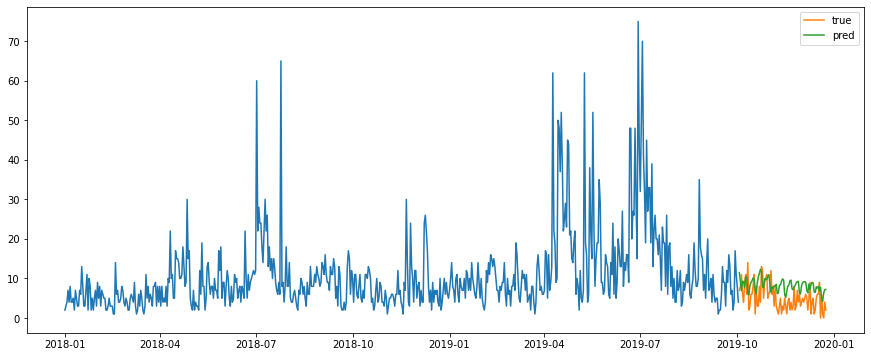

Test MSE: 19.646
Test RMSE: 4.432
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


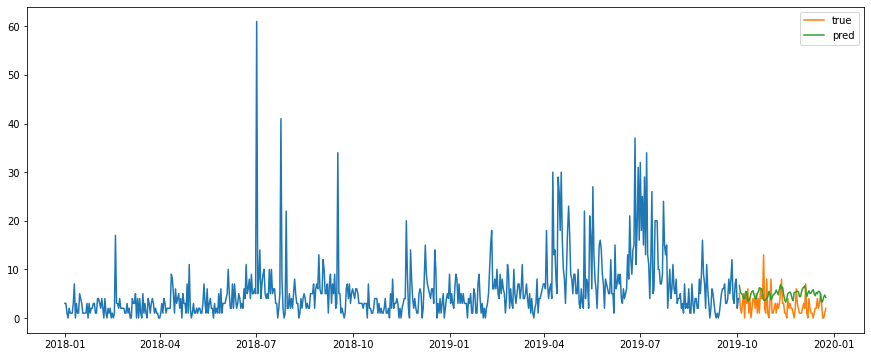

Test MSE: 10.597
Test RMSE: 3.255
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


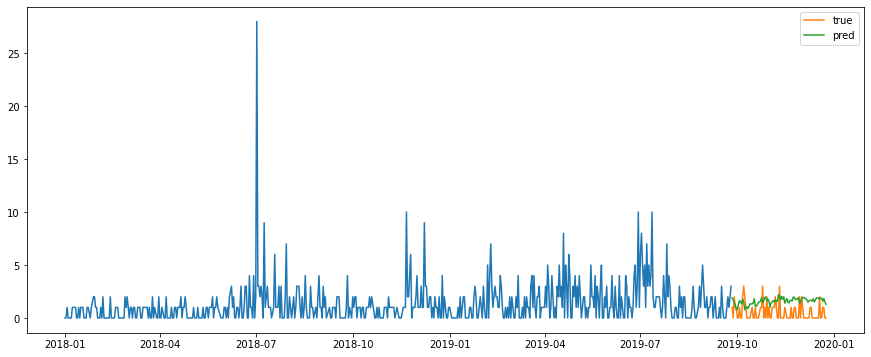

Test MSE: 1.779
Test RMSE: 1.334
Test MAPE: inf
소분류:  견과류
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


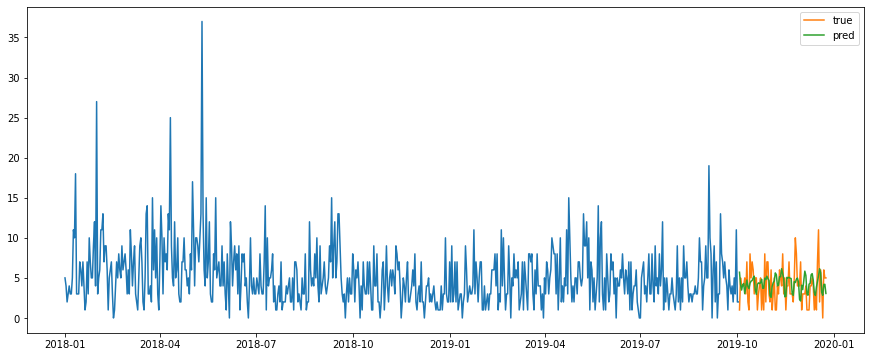

Test MSE: 5.270
Test RMSE: 2.296
Test MAPE: inf
성별:  남성 , 연령:  30대


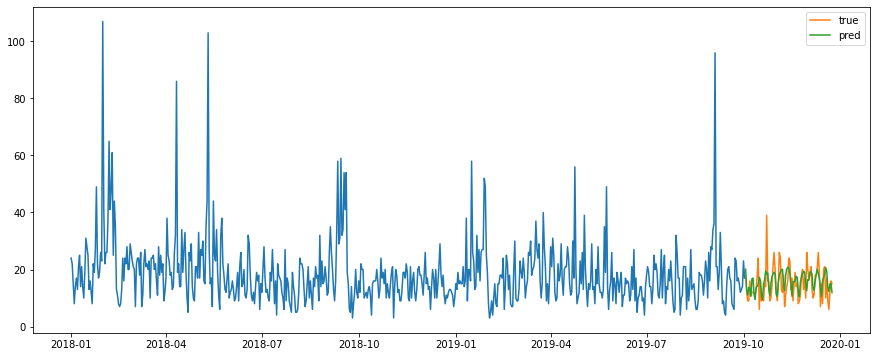

Test MSE: 26.569
Test RMSE: 5.154
Test MAPE: 30.990
성별:  남성 , 연령:  40대


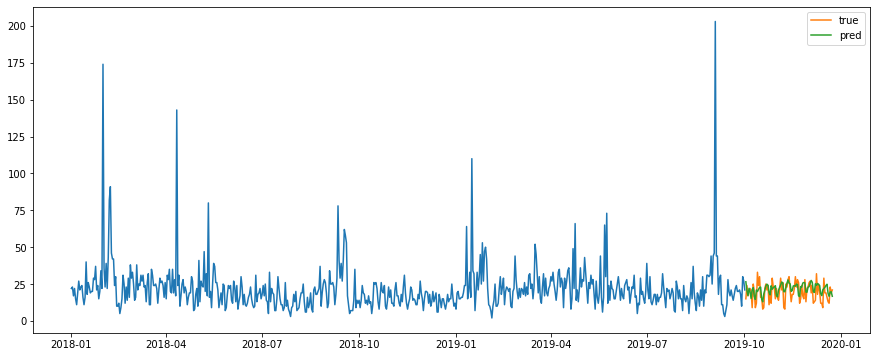

Test MSE: 37.709
Test RMSE: 6.141
Test MAPE: 33.578
성별:  남성 , 연령:  50대


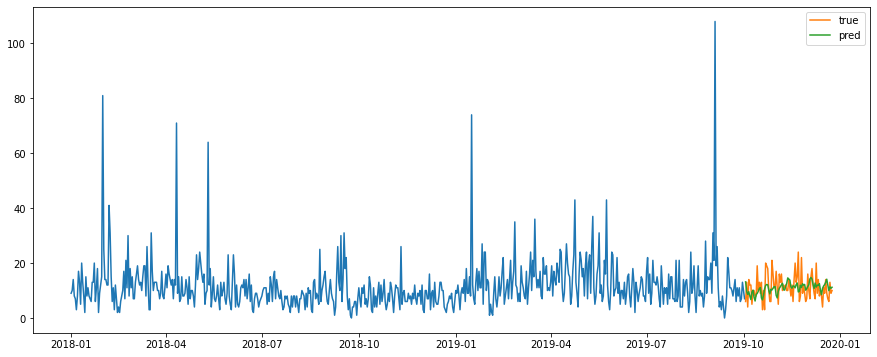

Test MSE: 22.130
Test RMSE: 4.704
Test MAPE: 39.812
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


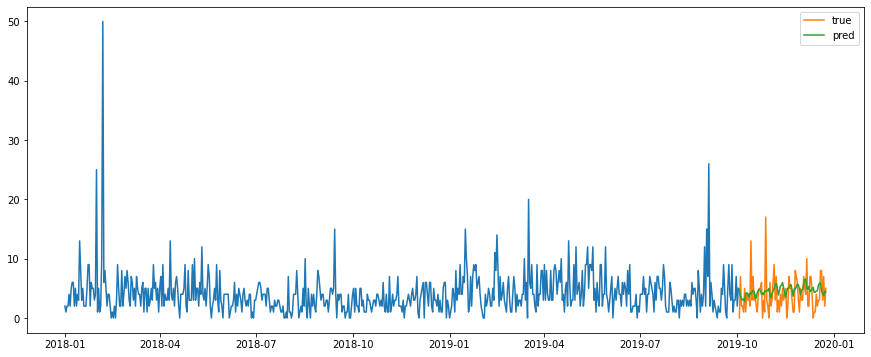

Test MSE: 9.099
Test RMSE: 3.016
Test MAPE: inf
성별:  여성  , 연령:  20대


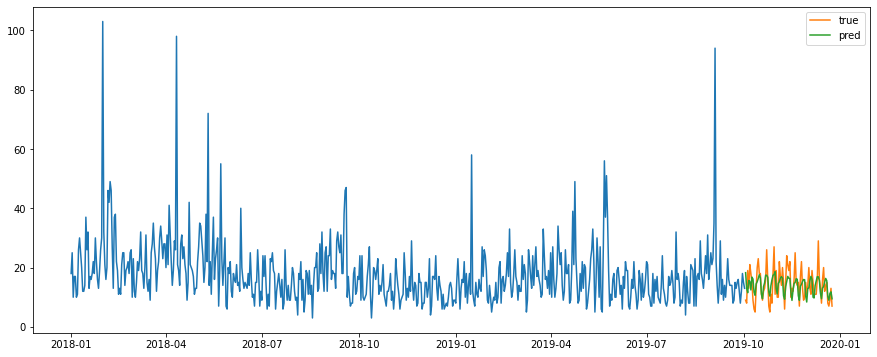

Test MSE: 21.706
Test RMSE: 4.659
Test MAPE: 29.993
성별:  여성  , 연령:  30대


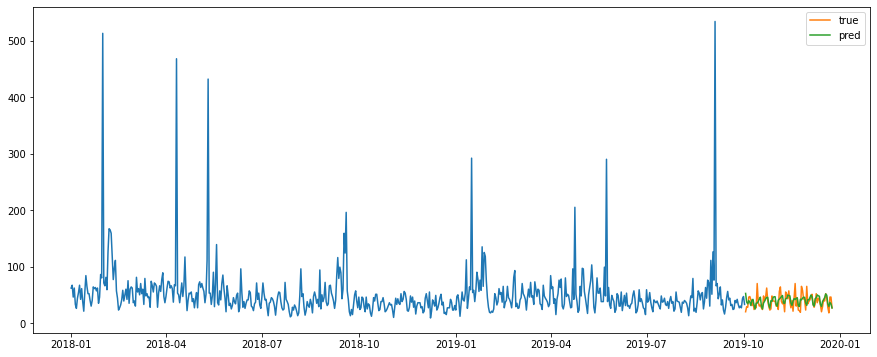

Test MSE: 136.822
Test RMSE: 11.697
Test MAPE: 26.421
성별:  여성  , 연령:  40대


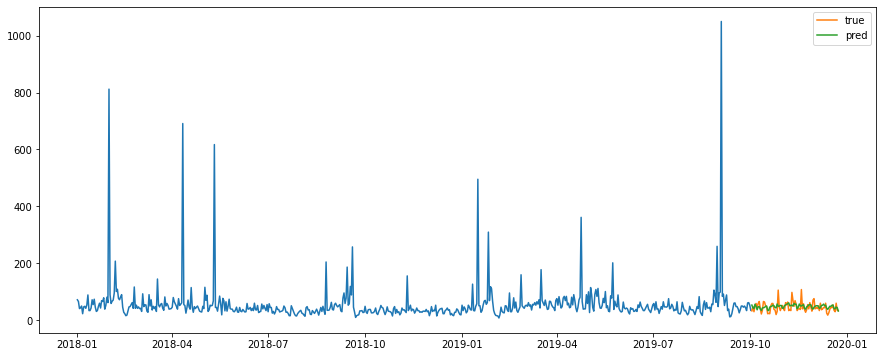

Test MSE: 267.064
Test RMSE: 16.342
Test MAPE: 30.794
성별:  여성  , 연령:  50대


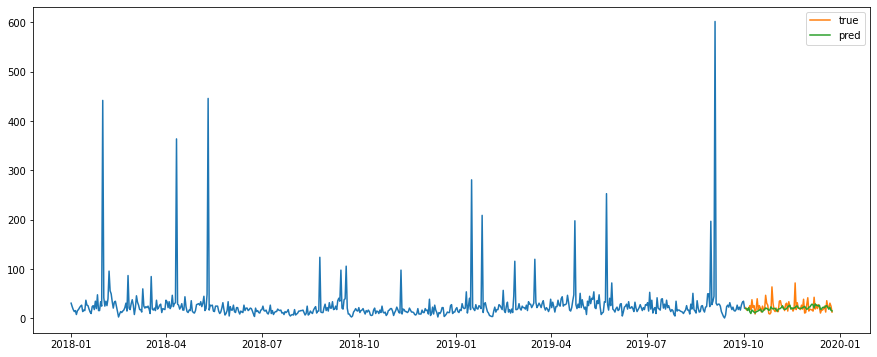

Test MSE: 136.690
Test RMSE: 11.691
Test MAPE: 33.778
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


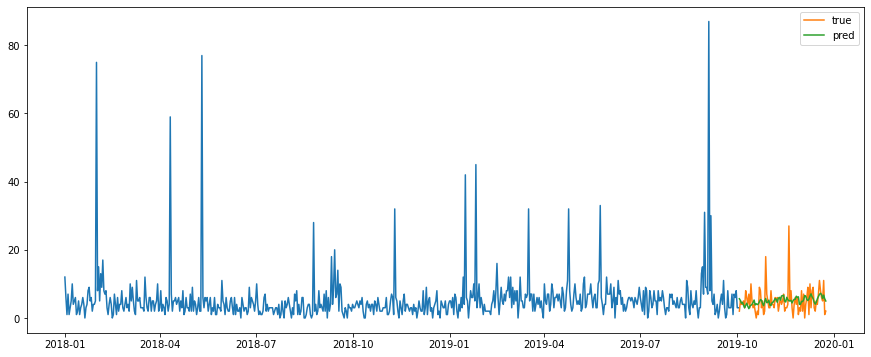

Test MSE: 14.527
Test RMSE: 3.811
Test MAPE: inf
소분류:  견과류 땅콩
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


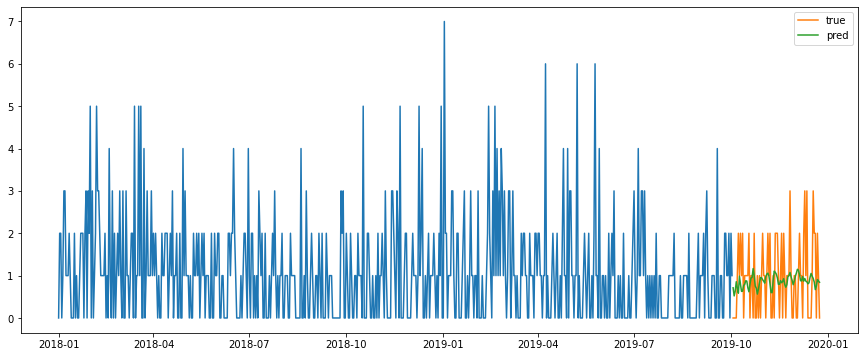

Test MSE: 0.754
Test RMSE: 0.868
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


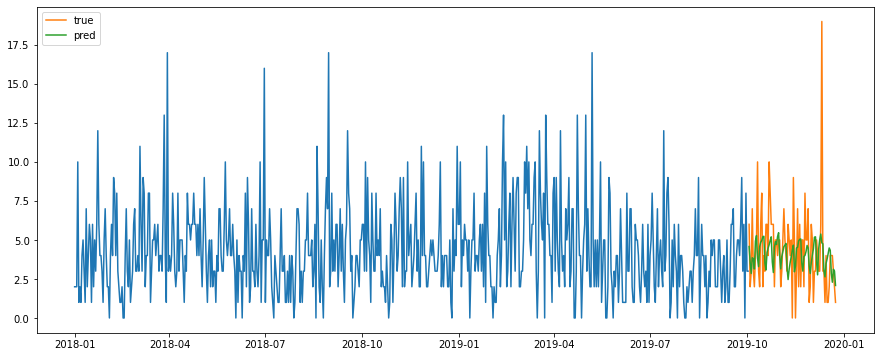

Test MSE: 6.995
Test RMSE: 2.645
Test MAPE: inf
성별:  남성 , 연령:  40대


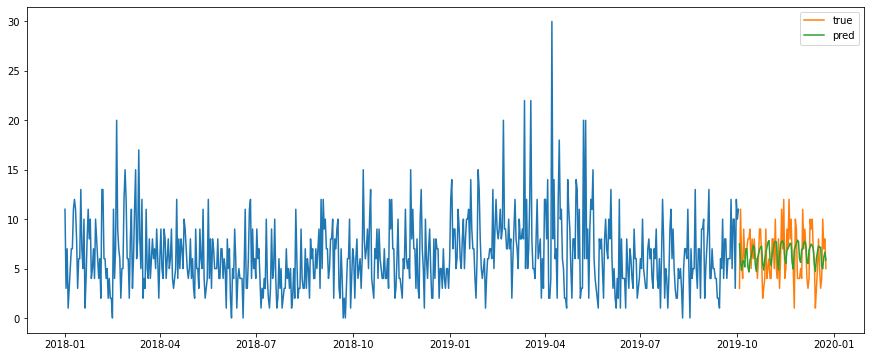

Test MSE: 6.090
Test RMSE: 2.468
Test MAPE: 47.721
성별:  남성 , 연령:  50대


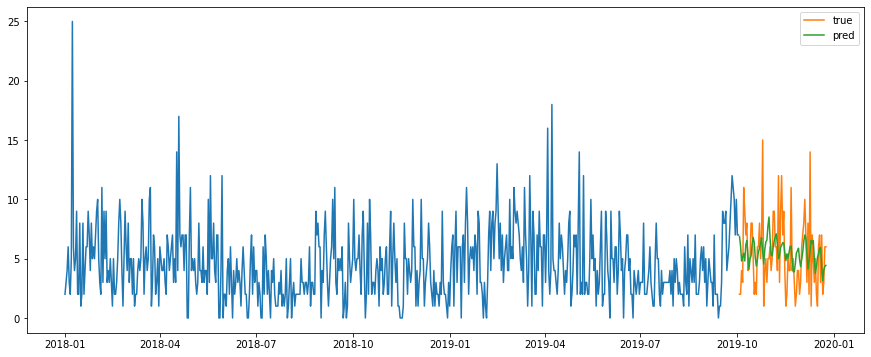

Test MSE: 8.694
Test RMSE: 2.949
Test MAPE: 72.783
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


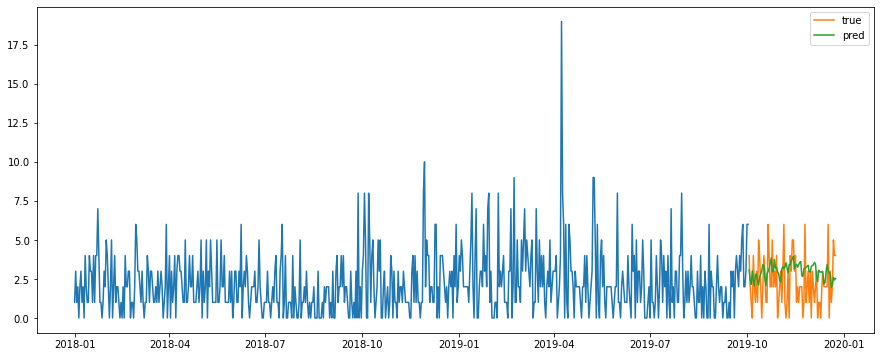

Test MSE: 3.118
Test RMSE: 1.766
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


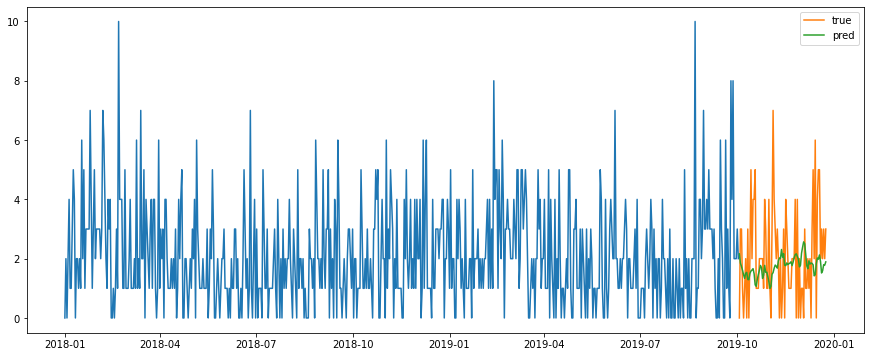

Test MSE: 2.840
Test RMSE: 1.685
Test MAPE: inf
성별:  여성  , 연령:  30대


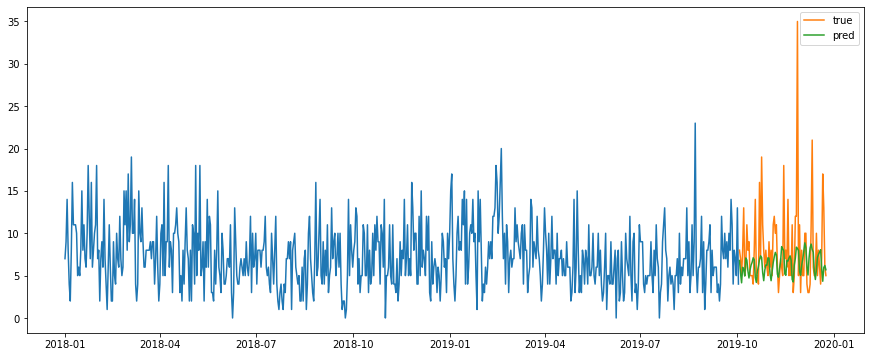

Test MSE: 25.271
Test RMSE: 5.027
Test MAPE: 36.656
성별:  여성  , 연령:  40대


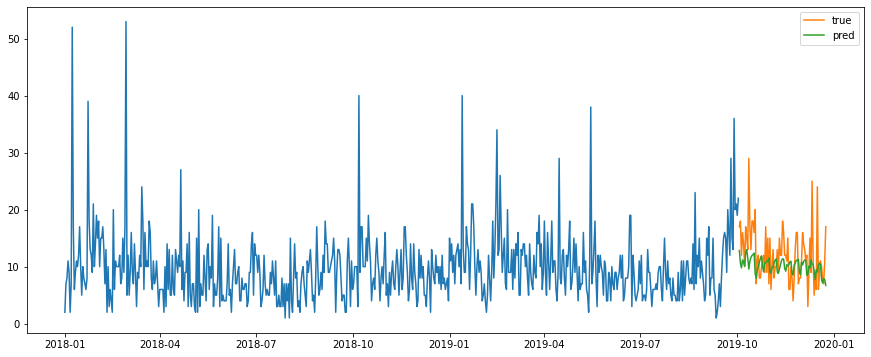

Test MSE: 23.807
Test RMSE: 4.879
Test MAPE: 30.703
성별:  여성  , 연령:  50대


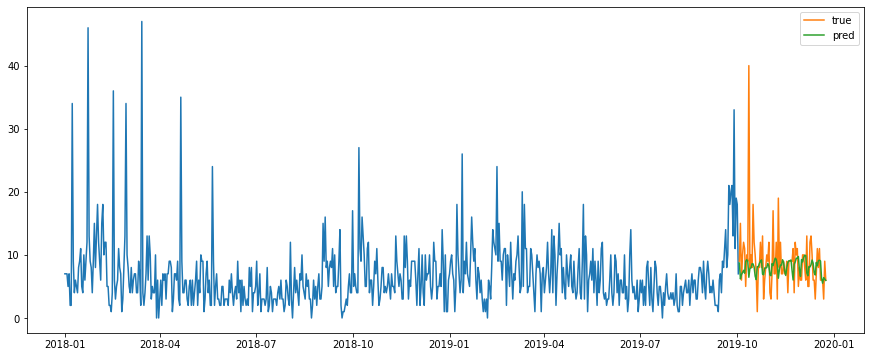

Test MSE: 25.726
Test RMSE: 5.072
Test MAPE: 42.805
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


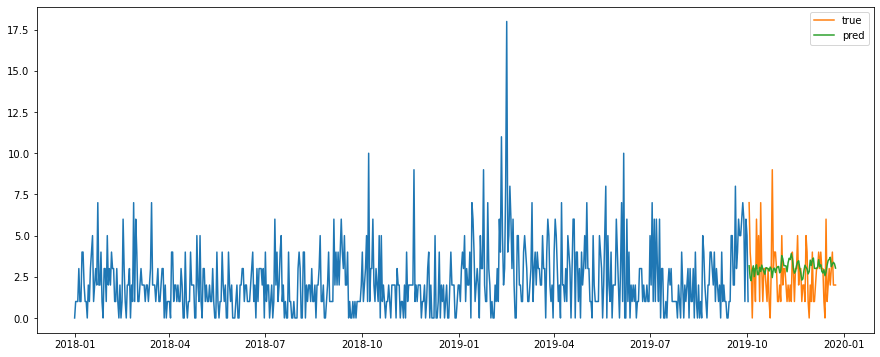

Test MSE: 3.150
Test RMSE: 1.775
Test MAPE: inf
소분류:  견과류 마카다미아
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


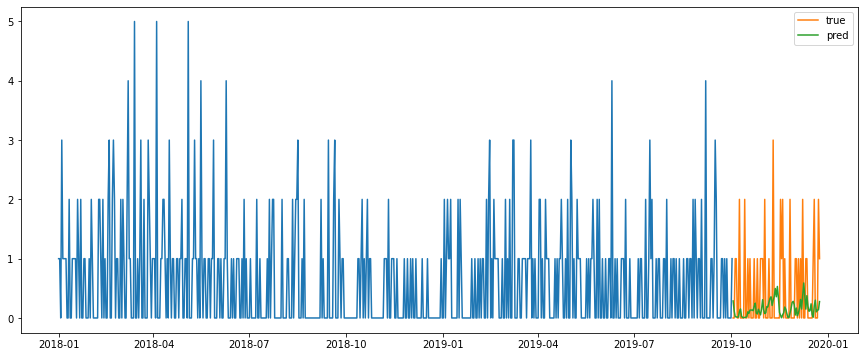

Test MSE: 0.682
Test RMSE: 0.826
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


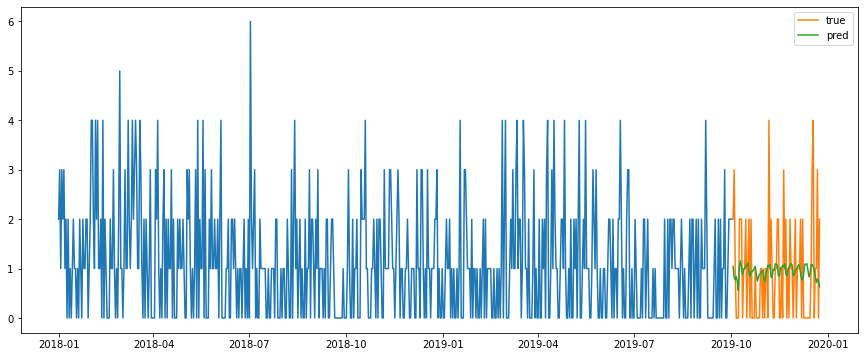

Test MSE: 0.998
Test RMSE: 0.999
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


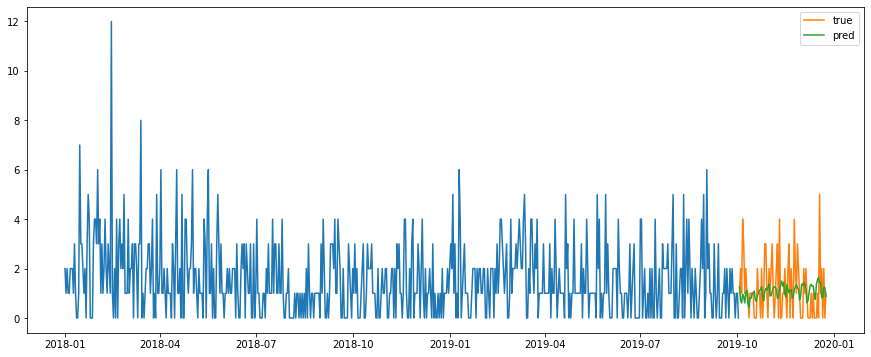

Test MSE: 1.382
Test RMSE: 1.176
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


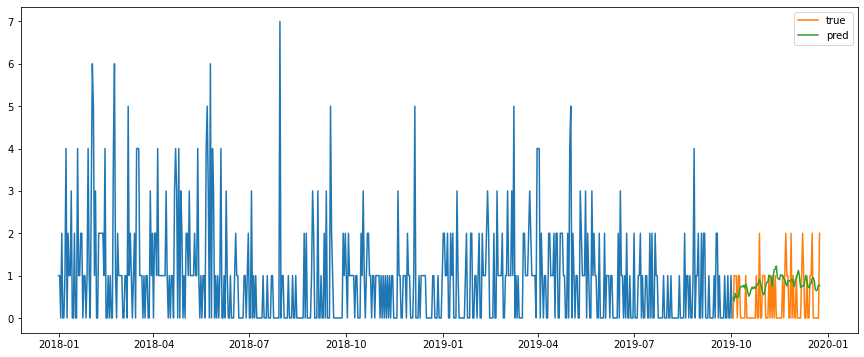

Test MSE: 0.549
Test RMSE: 0.741
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


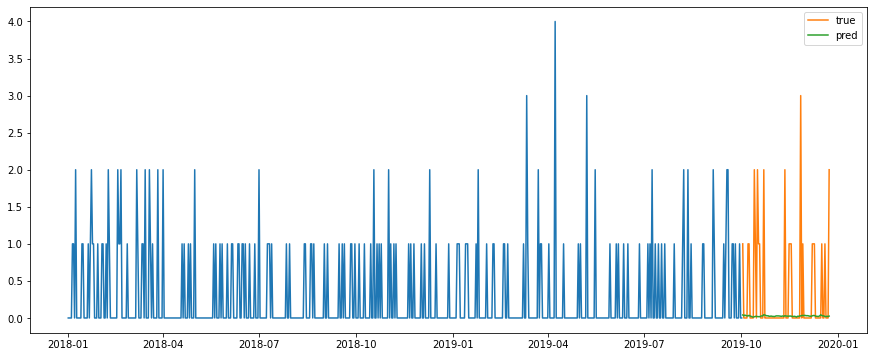

Test MSE: 0.512
Test RMSE: 0.716
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


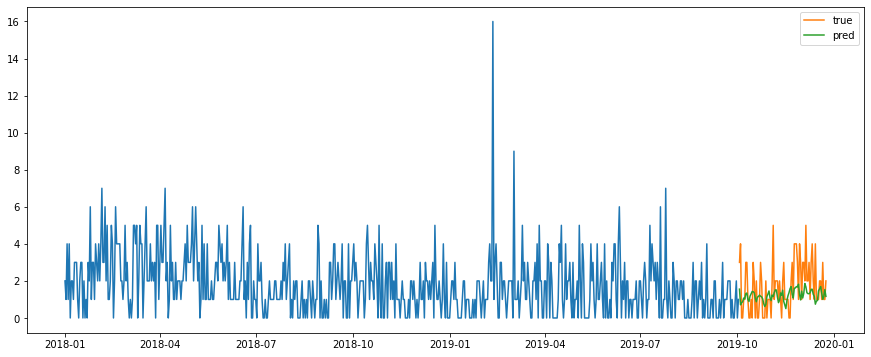

Test MSE: 1.828
Test RMSE: 1.352
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


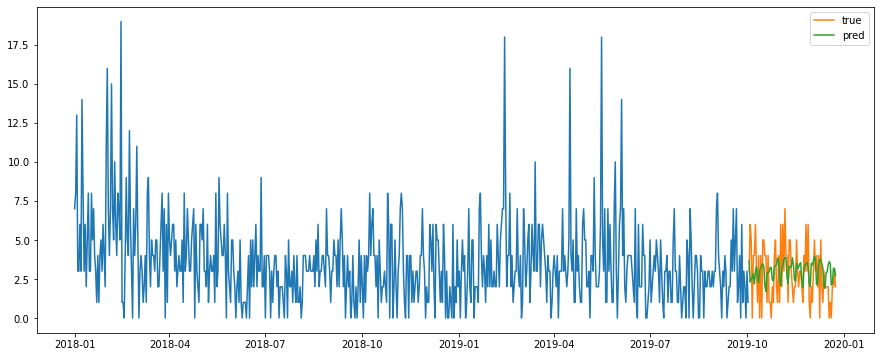

Test MSE: 3.250
Test RMSE: 1.803
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


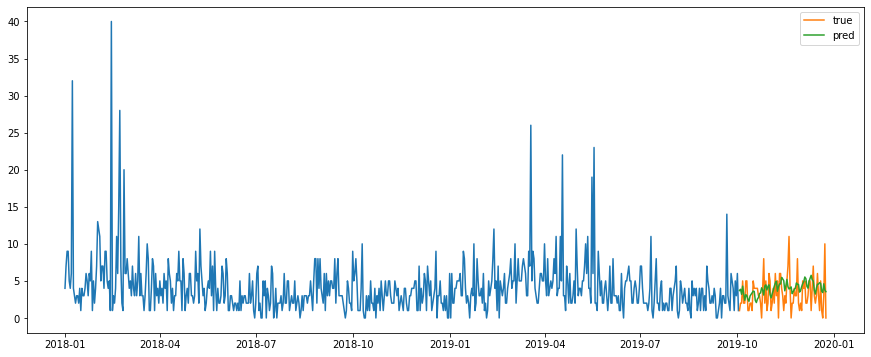

Test MSE: 5.324
Test RMSE: 2.307
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


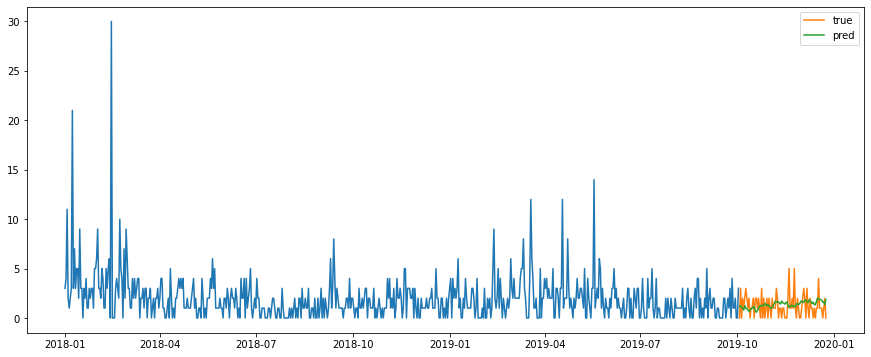

Test MSE: 1.481
Test RMSE: 1.217
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


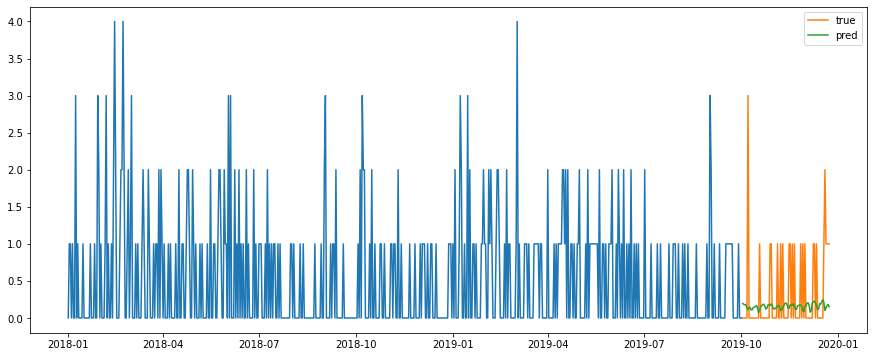

Test MSE: 0.341
Test RMSE: 0.584
Test MAPE: inf
소분류:  견과류 잣/은행
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


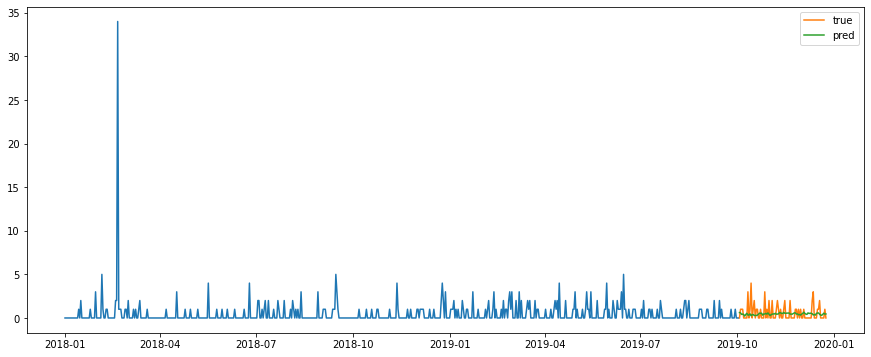

Test MSE: 0.861
Test RMSE: 0.928
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


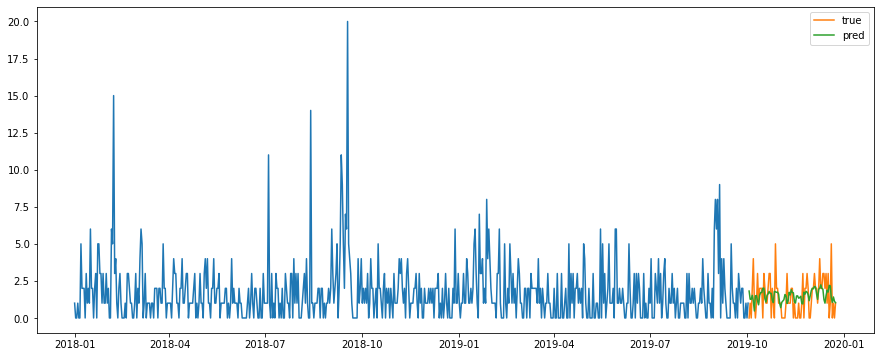

Test MSE: 1.462
Test RMSE: 1.209
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


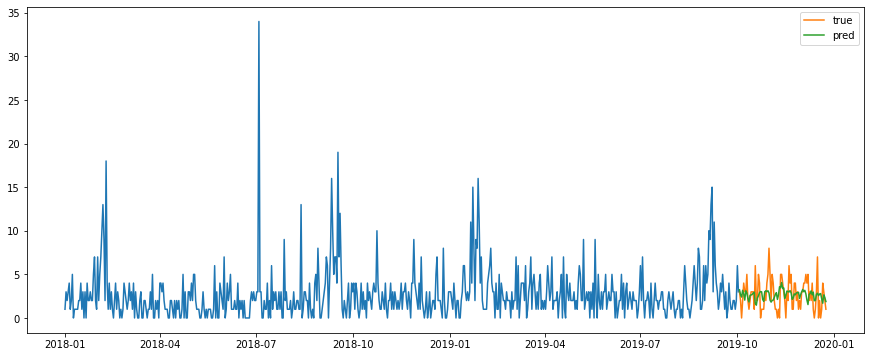

Test MSE: 3.093
Test RMSE: 1.759
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


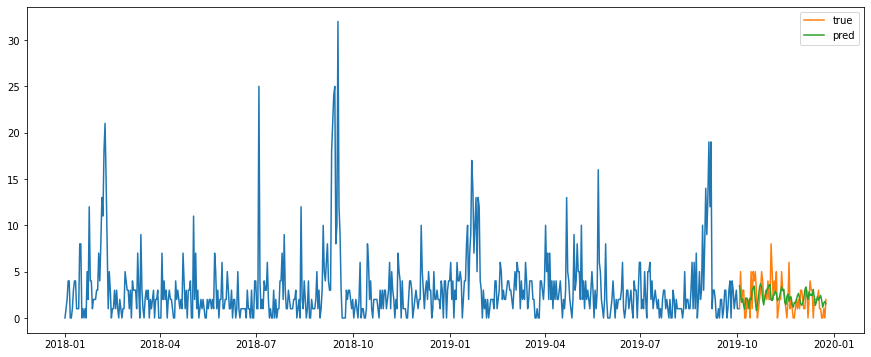

Test MSE: 2.614
Test RMSE: 1.617
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


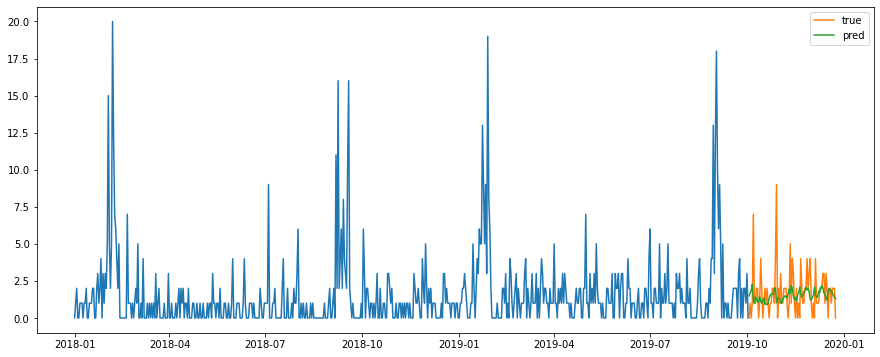

Test MSE: 2.594
Test RMSE: 1.611
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


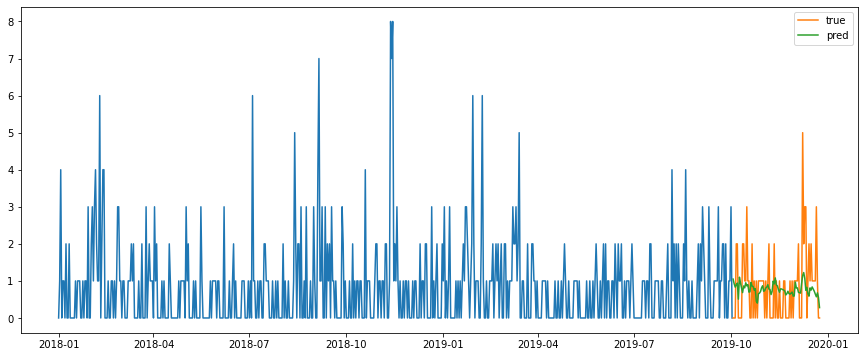

Test MSE: 0.887
Test RMSE: 0.942
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


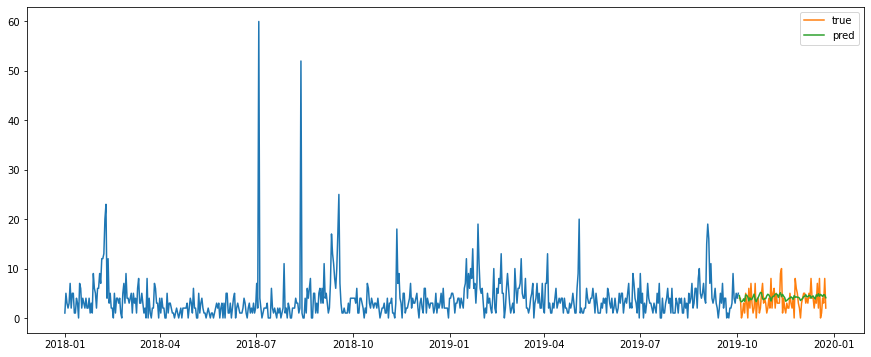

Test MSE: 5.625
Test RMSE: 2.372
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


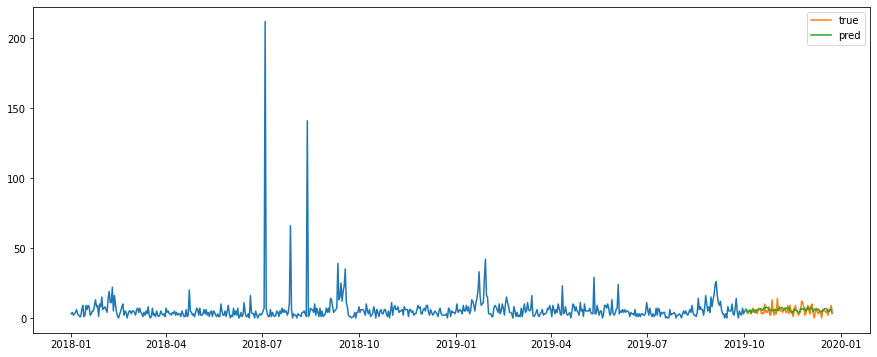

Test MSE: 7.533
Test RMSE: 2.745
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


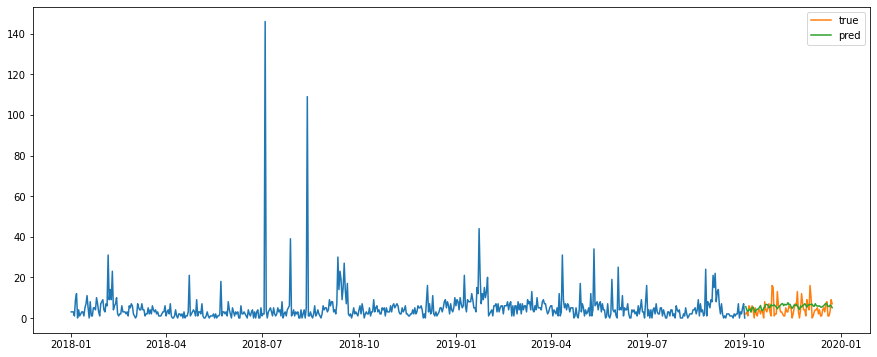

Test MSE: 14.219
Test RMSE: 3.771
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


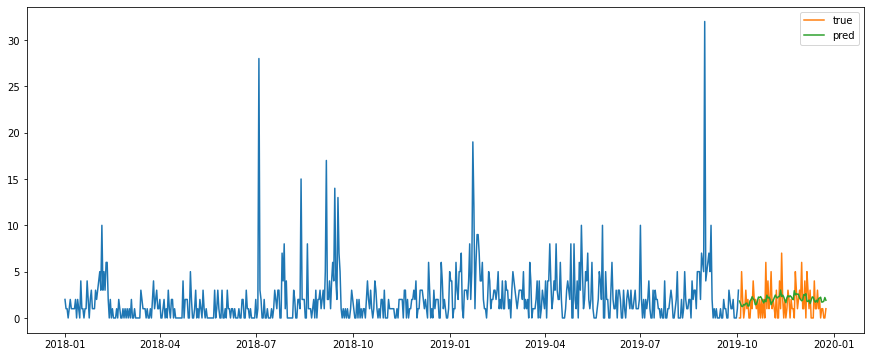

Test MSE: 3.108
Test RMSE: 1.763
Test MAPE: inf
소분류:  견과류 호두
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


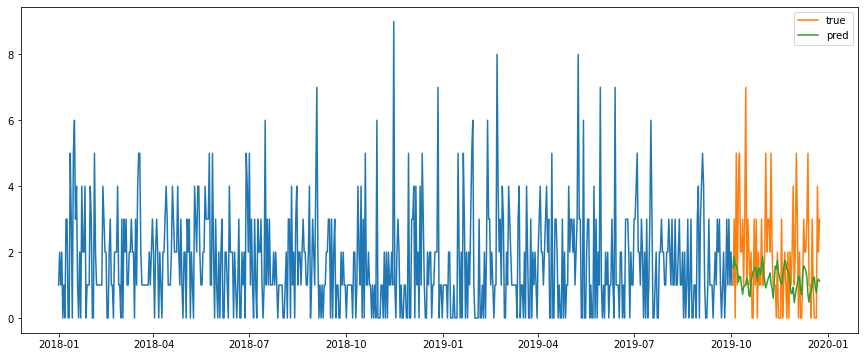

Test MSE: 2.976
Test RMSE: 1.725
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


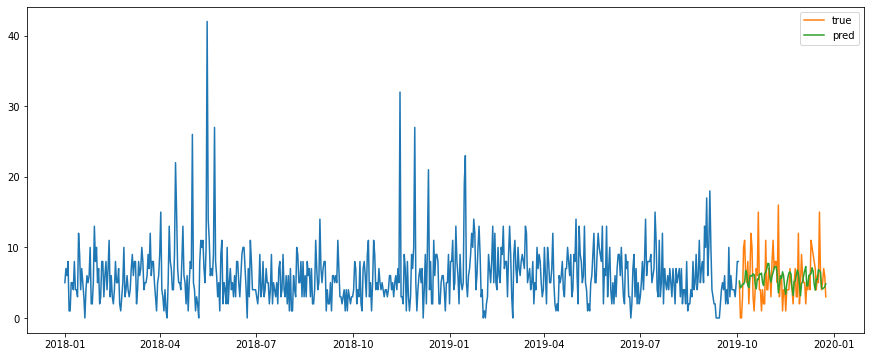

Test MSE: 11.240
Test RMSE: 3.353
Test MAPE: inf
성별:  남성 , 연령:  40대


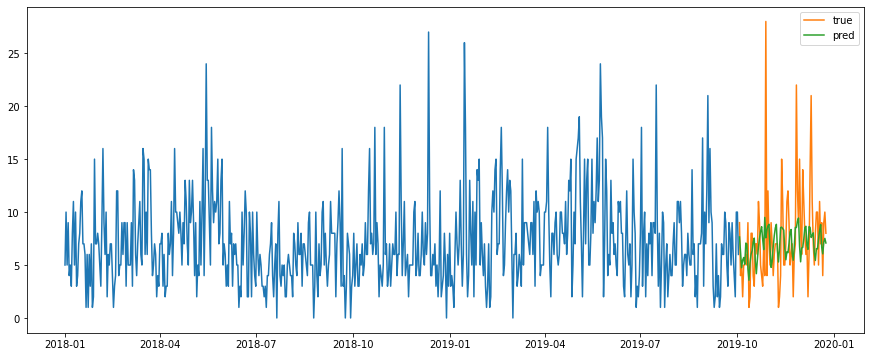

Test MSE: 18.911
Test RMSE: 4.349
Test MAPE: 55.895
성별:  남성 , 연령:  50대


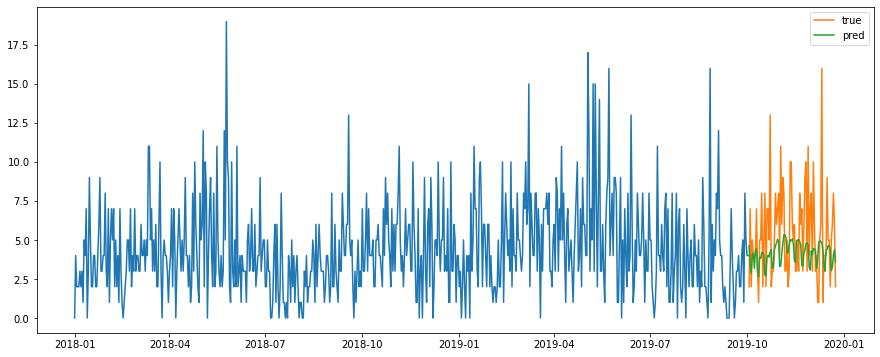

Test MSE: 9.529
Test RMSE: 3.087
Test MAPE: 52.186
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


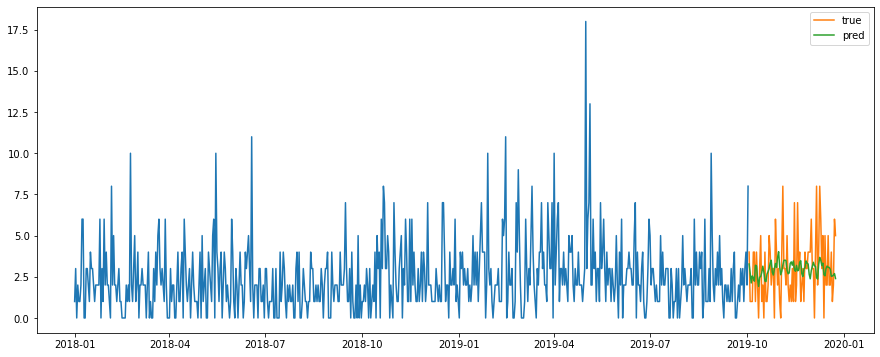

Test MSE: 3.802
Test RMSE: 1.950
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


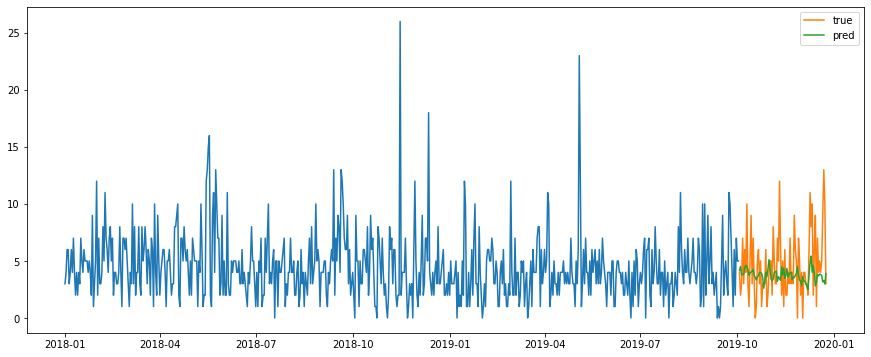

Test MSE: 8.869
Test RMSE: 2.978
Test MAPE: inf
성별:  여성  , 연령:  30대


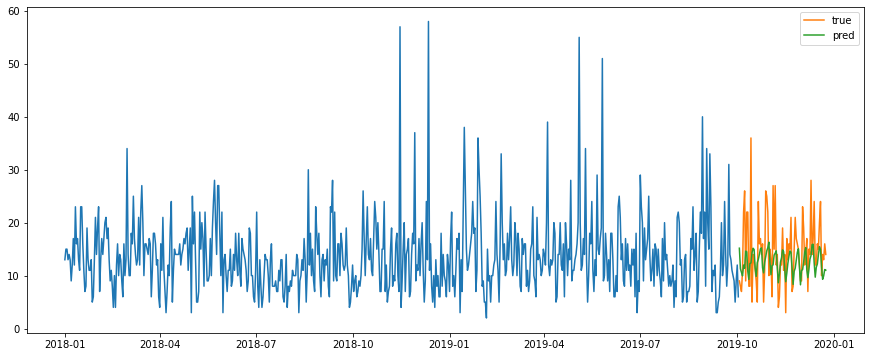

Test MSE: 41.355
Test RMSE: 6.431
Test MAPE: 35.854
성별:  여성  , 연령:  40대


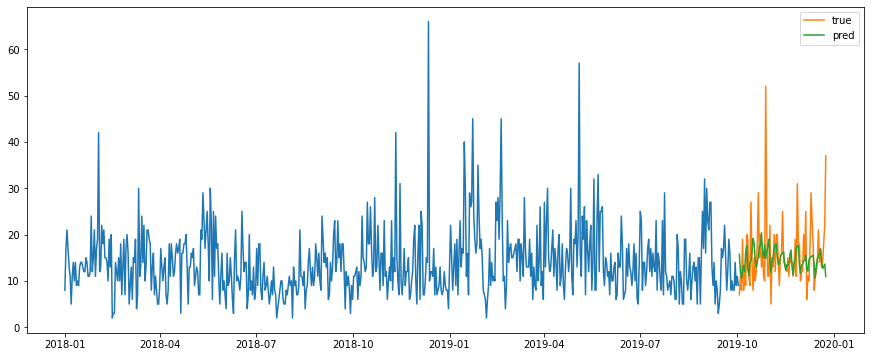

Test MSE: 52.296
Test RMSE: 7.232
Test MAPE: 30.654
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


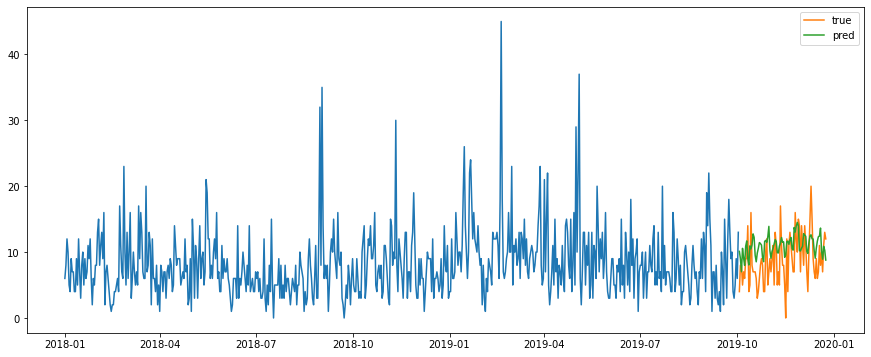

Test MSE: 16.398
Test RMSE: 4.049
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


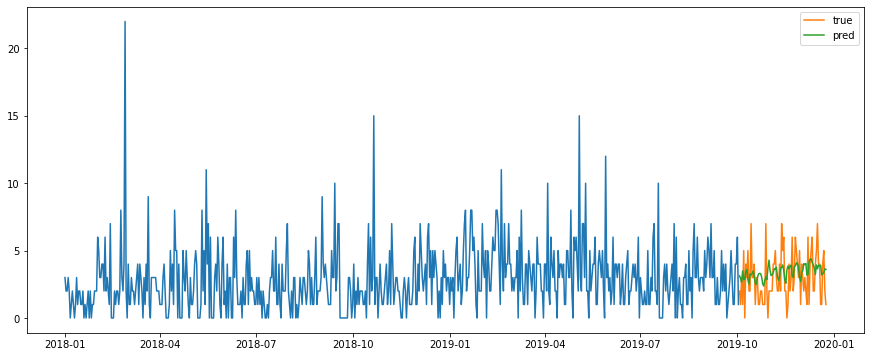

Test MSE: 3.234
Test RMSE: 1.798
Test MAPE: inf
소분류:  공기정화 용품
성별:  남성 , 연령:  20대


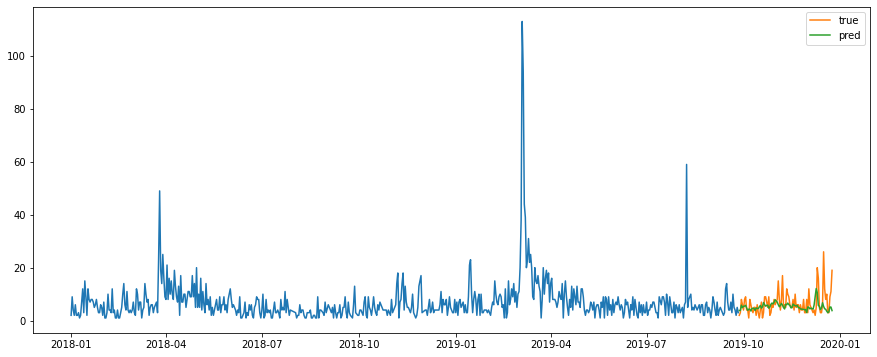

Test MSE: 19.521
Test RMSE: 4.418
Test MAPE: 54.435
성별:  남성 , 연령:  30대


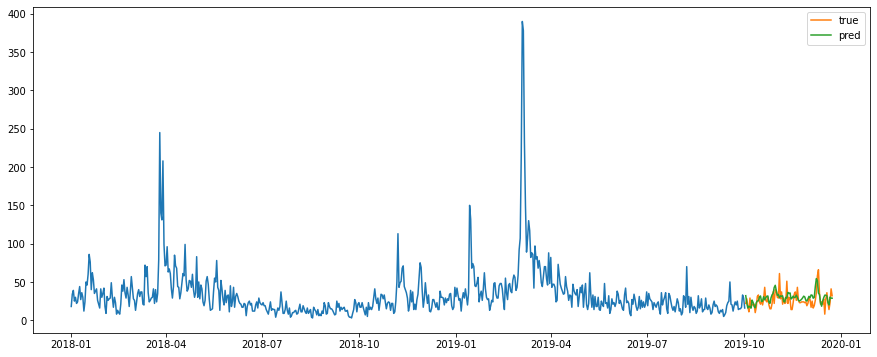

Test MSE: 98.552
Test RMSE: 9.927
Test MAPE: 33.404
성별:  남성 , 연령:  40대


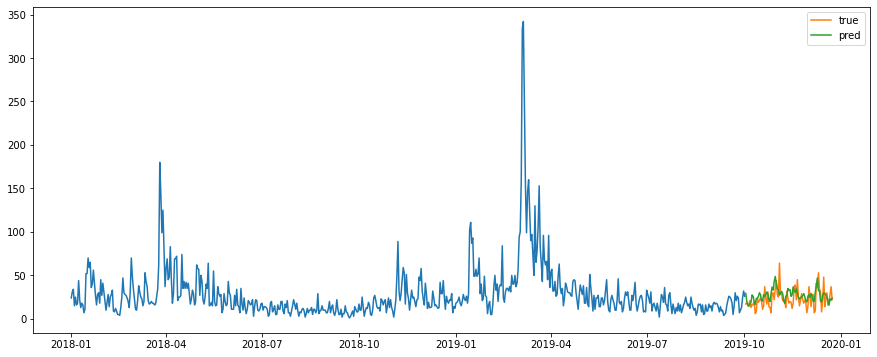

Test MSE: 114.311
Test RMSE: 10.692
Test MAPE: 50.387
성별:  남성 , 연령:  50대


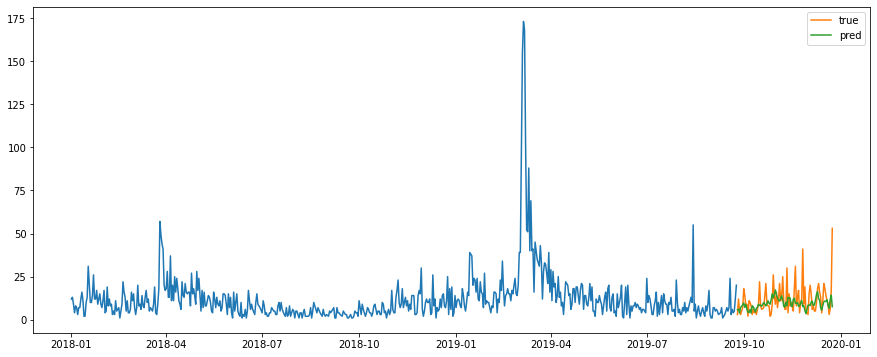

Test MSE: 77.298
Test RMSE: 8.792
Test MAPE: 55.748
성별:  남성 , 연령:  60대


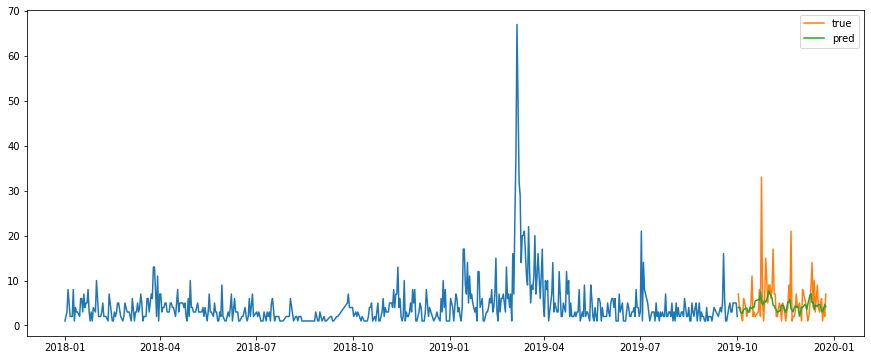

Test MSE: 23.358
Test RMSE: 4.833
Test MAPE: 69.741
성별:  여성  , 연령:  20대


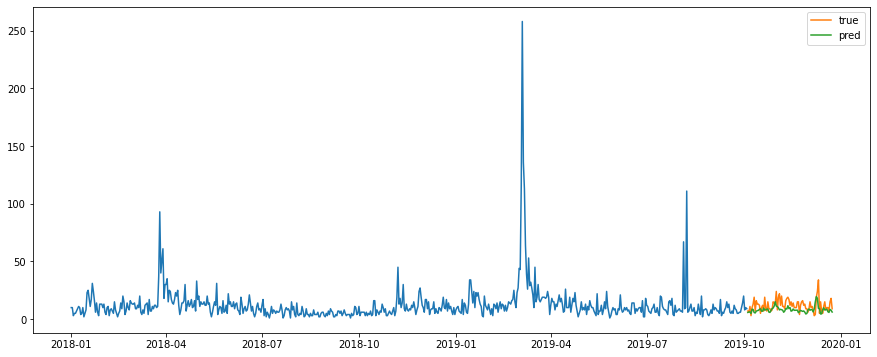

Test MSE: 41.494
Test RMSE: 6.442
Test MAPE: 42.510
성별:  여성  , 연령:  30대


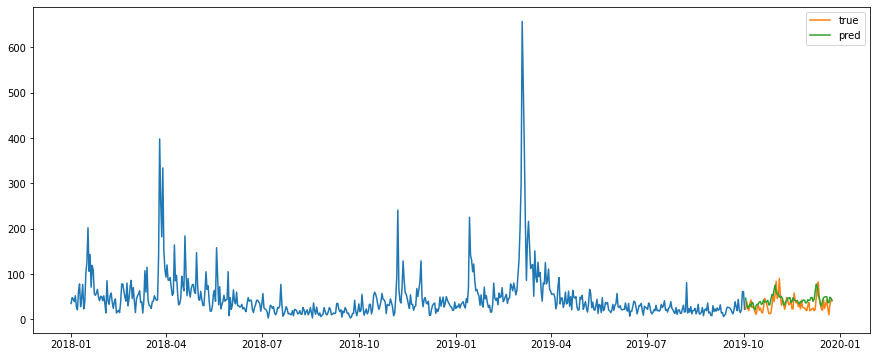

Test MSE: 269.255
Test RMSE: 16.409
Test MAPE: 54.698
성별:  여성  , 연령:  40대


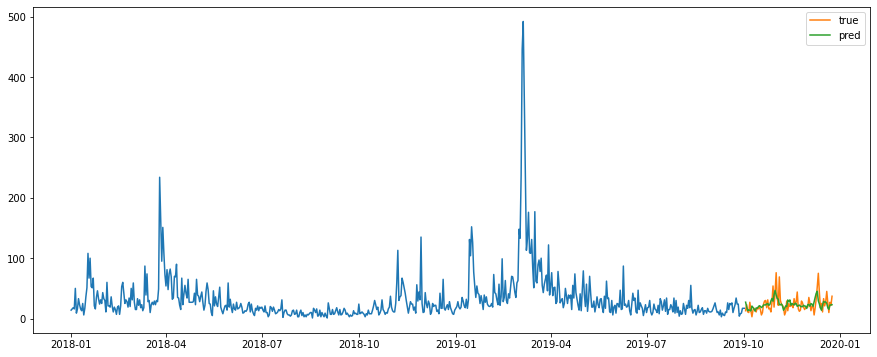

Test MSE: 156.336
Test RMSE: 12.503
Test MAPE: 50.668
성별:  여성  , 연령:  50대


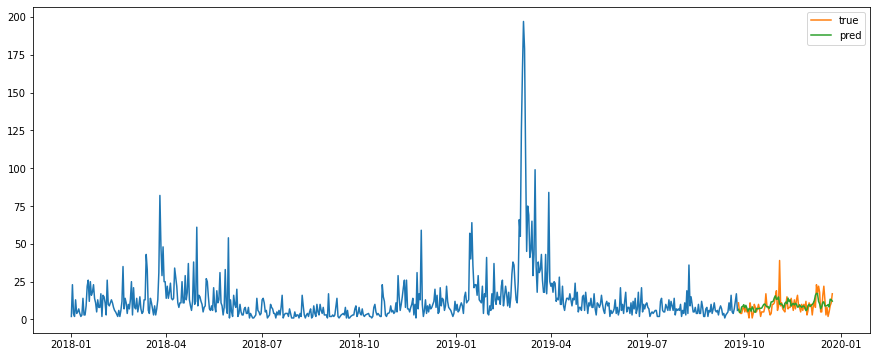

Test MSE: 27.413
Test RMSE: 5.236
Test MAPE: 66.140
성별:  여성  , 연령:  60대


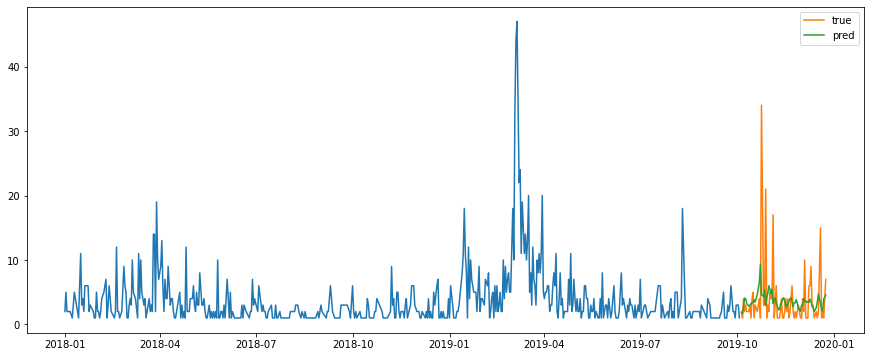

Test MSE: 25.970
Test RMSE: 5.096
Test MAPE: 112.638
소분류:  공기청정기
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


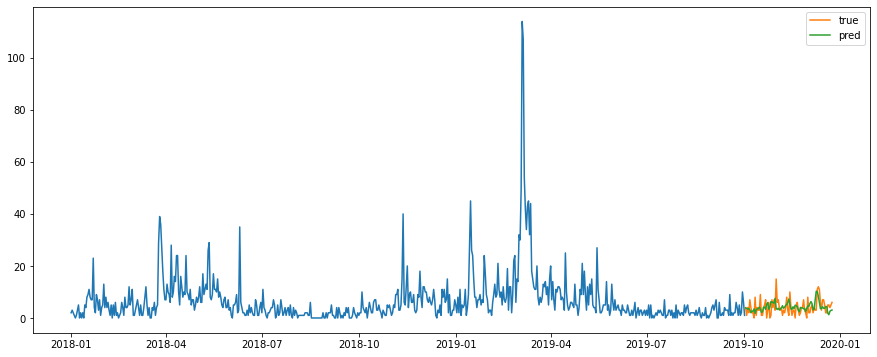

Test MSE: 9.418
Test RMSE: 3.069
Test MAPE: inf
성별:  남성 , 연령:  30대


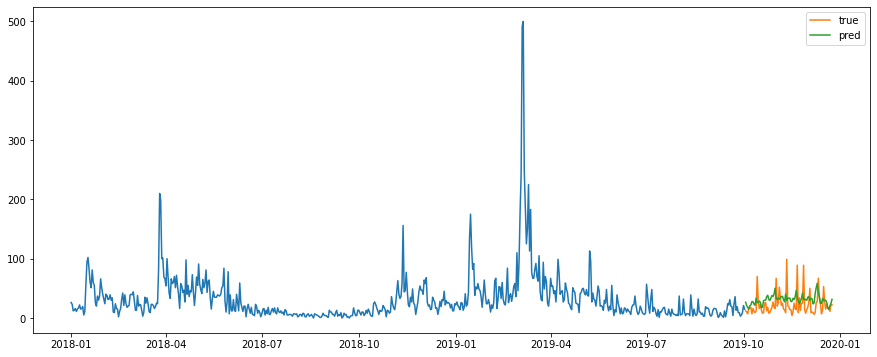

Test MSE: 444.298
Test RMSE: 21.078
Test MAPE: 112.685
성별:  남성 , 연령:  40대


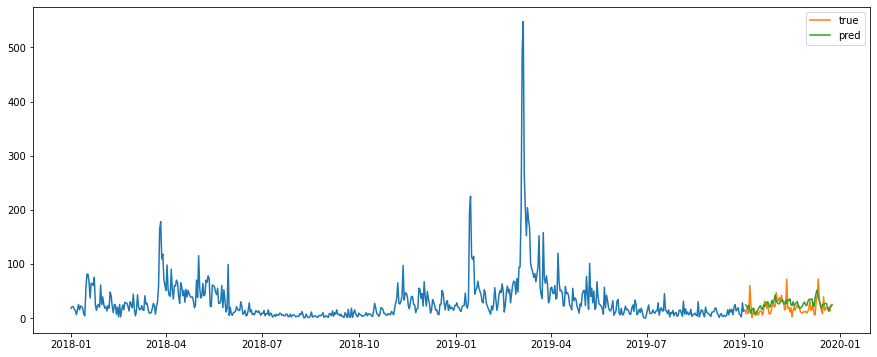

Test MSE: 200.603
Test RMSE: 14.163
Test MAPE: 107.073
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


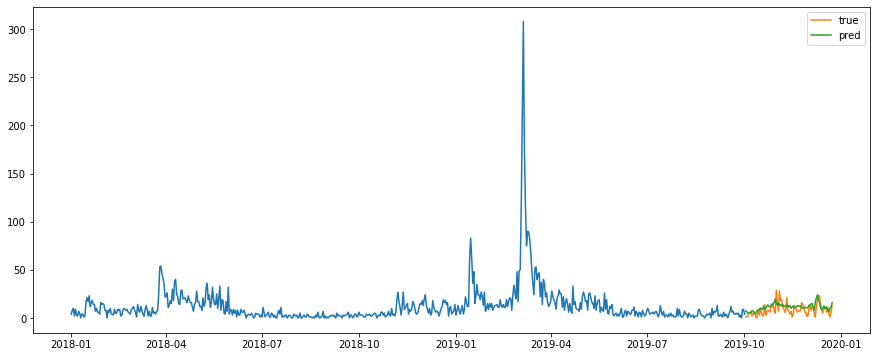

Test MSE: 35.985
Test RMSE: 5.999
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


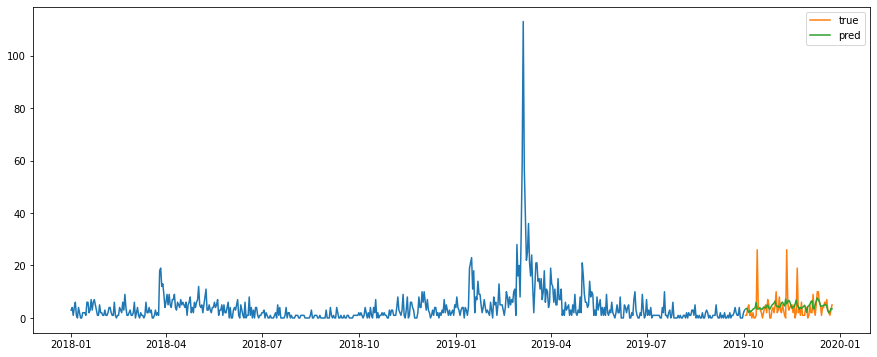

Test MSE: 20.943
Test RMSE: 4.576
Test MAPE: inf
성별:  여성  , 연령:  20대


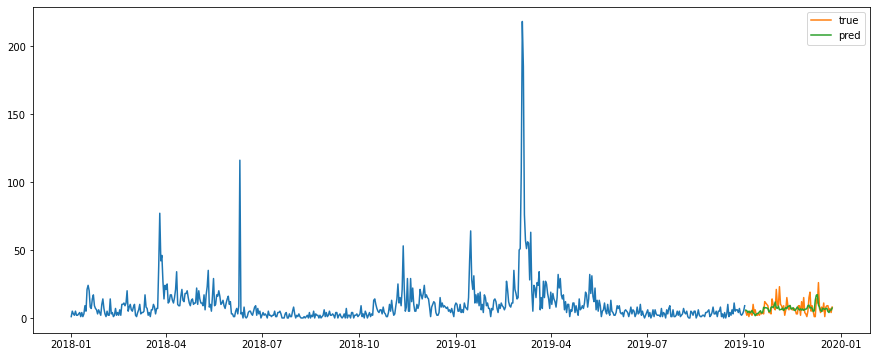

Test MSE: 23.271
Test RMSE: 4.824
Test MAPE: 85.403
성별:  여성  , 연령:  30대


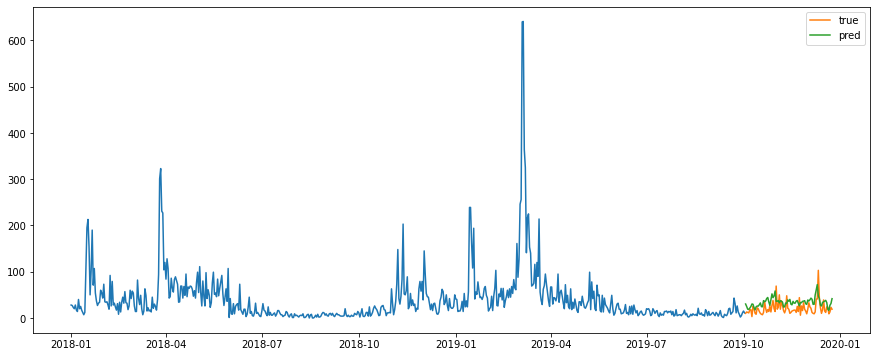

Test MSE: 370.032
Test RMSE: 19.236
Test MAPE: 116.863
성별:  여성  , 연령:  40대


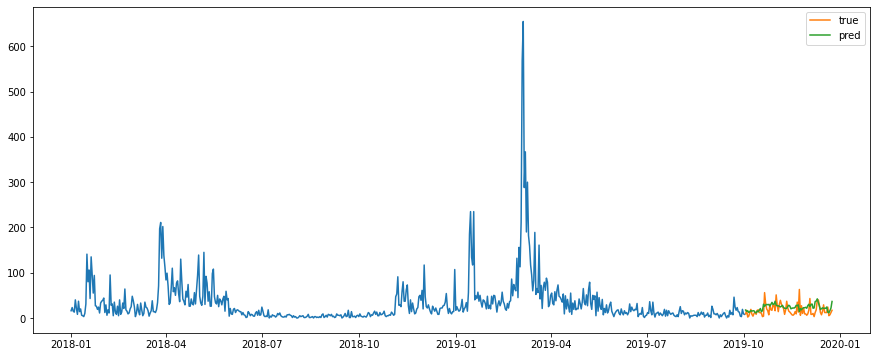

Test MSE: 189.348
Test RMSE: 13.760
Test MAPE: 115.889
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


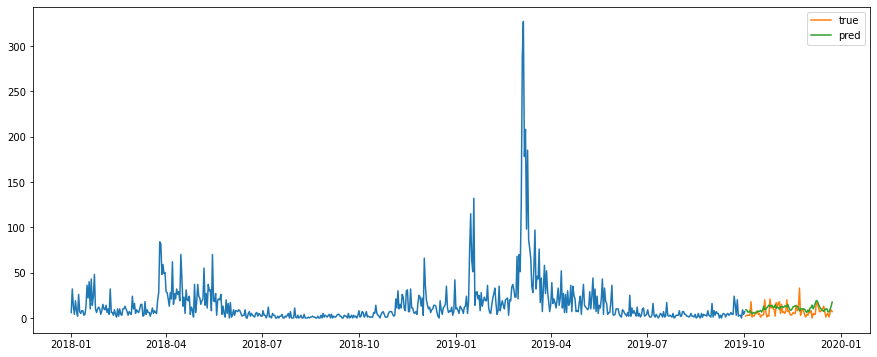

Test MSE: 44.776
Test RMSE: 6.691
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


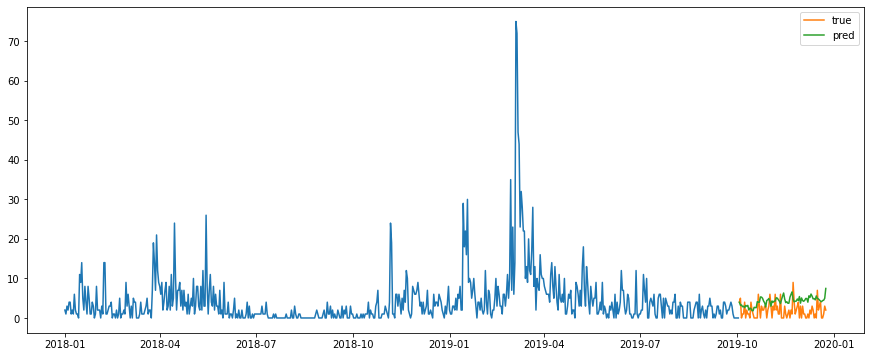

Test MSE: 10.500
Test RMSE: 3.240
Test MAPE: inf
소분류:  과채 음료/주스
성별:  남성 , 연령:  20대


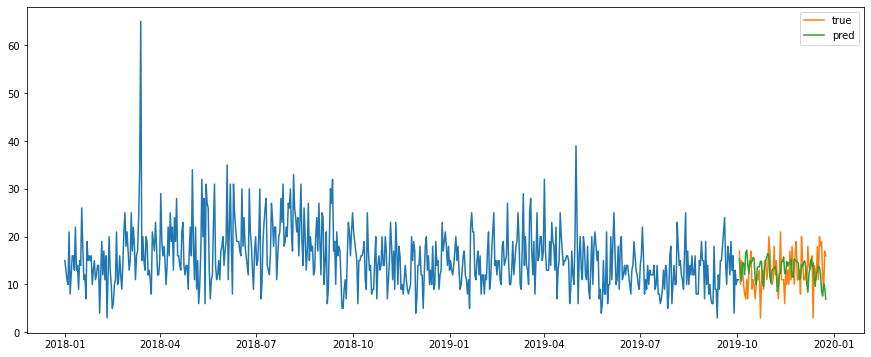

Test MSE: 21.067
Test RMSE: 4.590
Test MAPE: 38.350
성별:  남성 , 연령:  30대


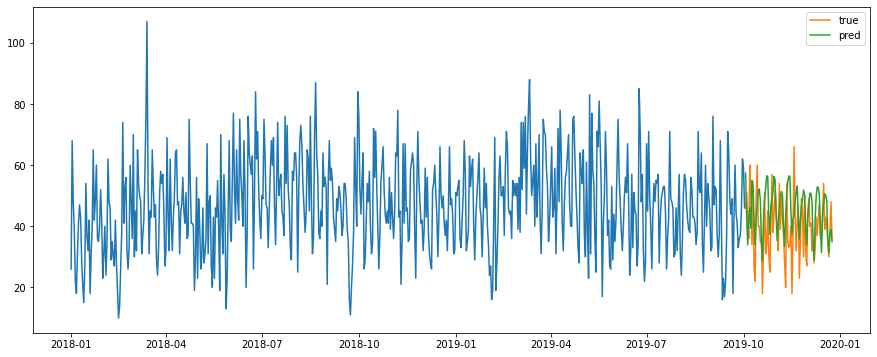

Test MSE: 124.216
Test RMSE: 11.145
Test MAPE: 26.309
성별:  남성 , 연령:  40대


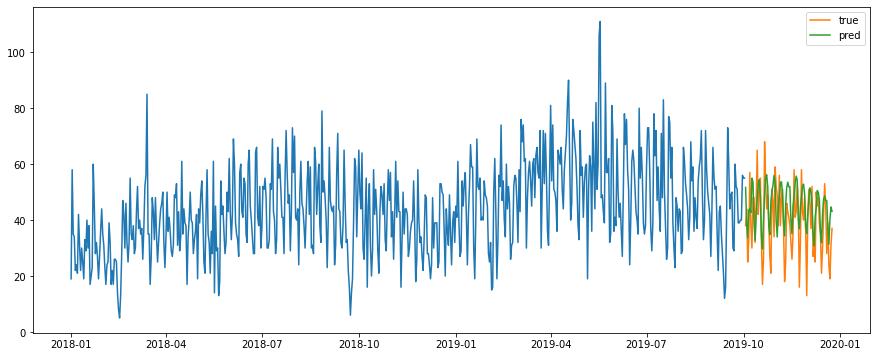

Test MSE: 121.599
Test RMSE: 11.027
Test MAPE: 28.982
성별:  남성 , 연령:  50대


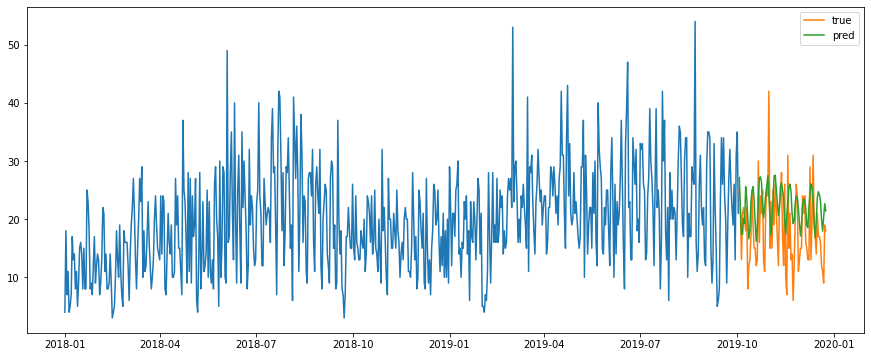

Test MSE: 45.502
Test RMSE: 6.746
Test MAPE: 39.694
성별:  남성 , 연령:  60대


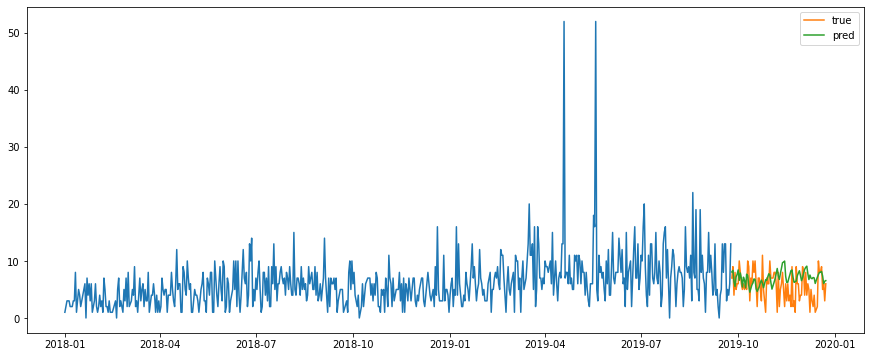

Test MSE: 9.458
Test RMSE: 3.075
Test MAPE: 89.513
성별:  여성  , 연령:  20대


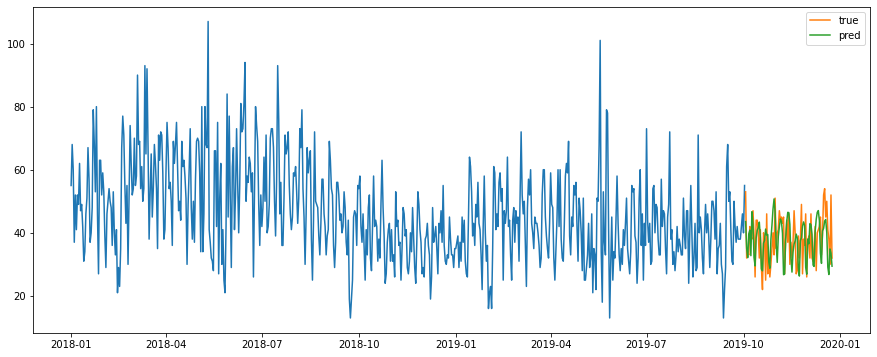

Test MSE: 62.805
Test RMSE: 7.925
Test MAPE: 17.153
성별:  여성  , 연령:  30대


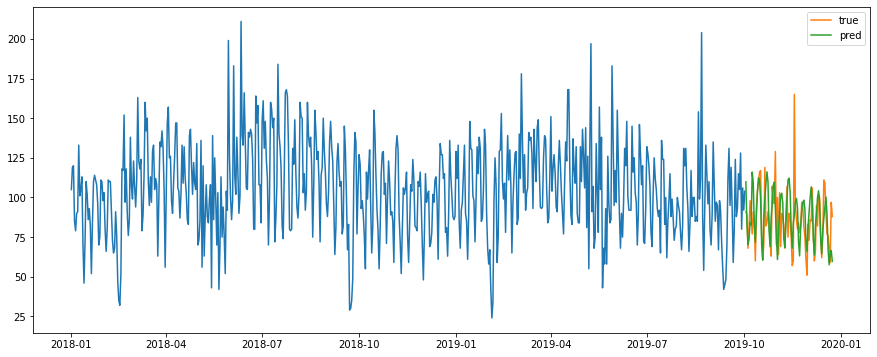

Test MSE: 321.386
Test RMSE: 17.927
Test MAPE: 15.638
성별:  여성  , 연령:  40대


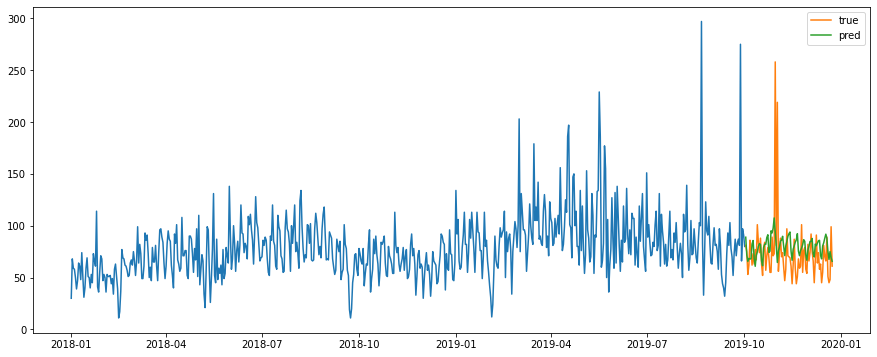

Test MSE: 932.973
Test RMSE: 30.545
Test MAPE: 25.816
성별:  여성  , 연령:  50대


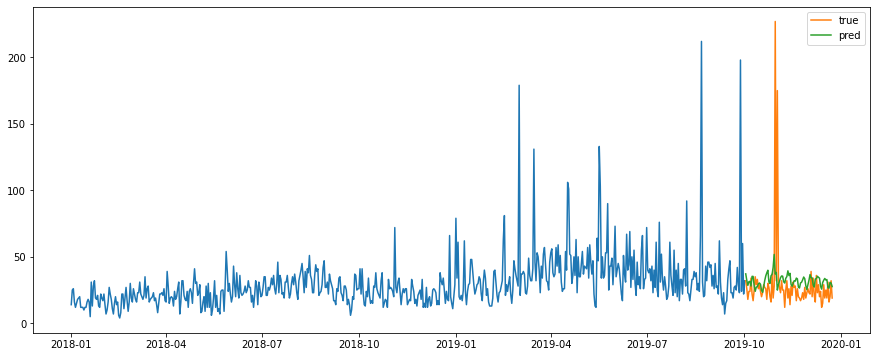

Test MSE: 814.586
Test RMSE: 28.541
Test MAPE: 44.406
성별:  여성  , 연령:  60대


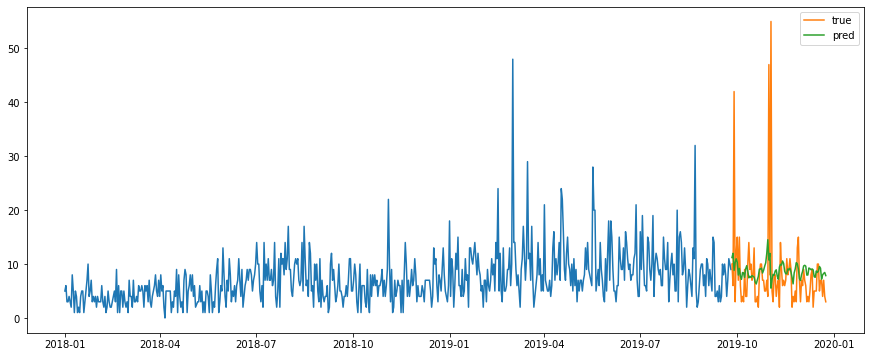

Test MSE: 68.510
Test RMSE: 8.277
Test MAPE: 74.599
소분류:  기능성 링클케어 화장품
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


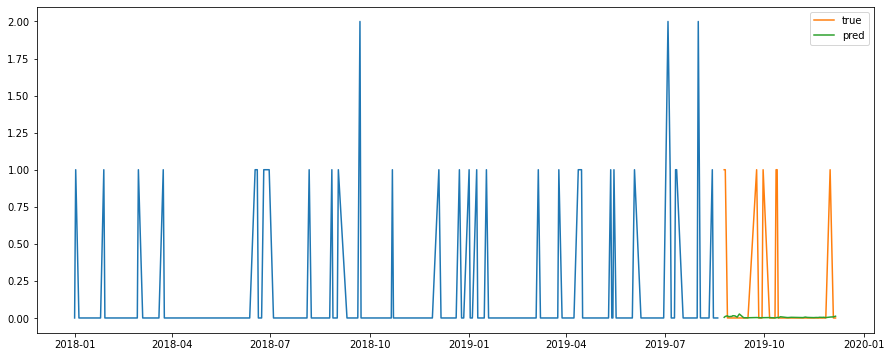

Test MSE: 0.161
Test RMSE: 0.402
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


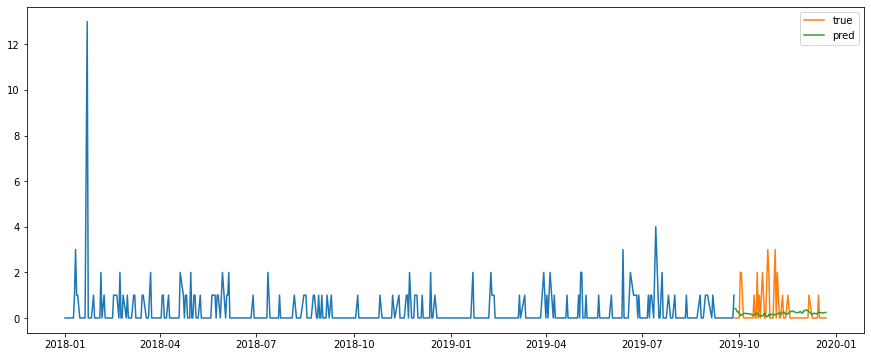

Test MSE: 0.701
Test RMSE: 0.837
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


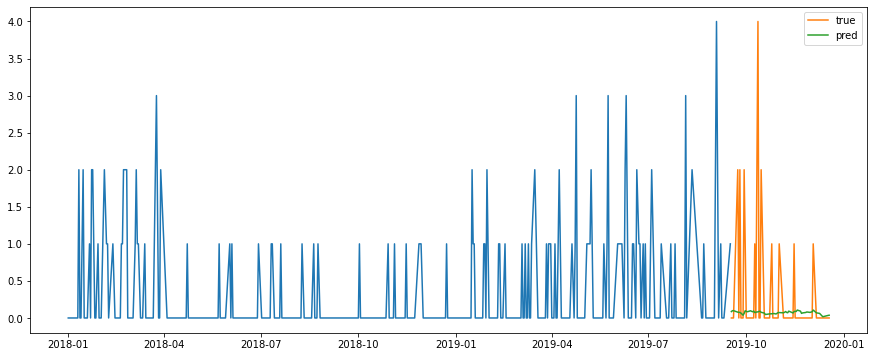

Test MSE: 0.700
Test RMSE: 0.837
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


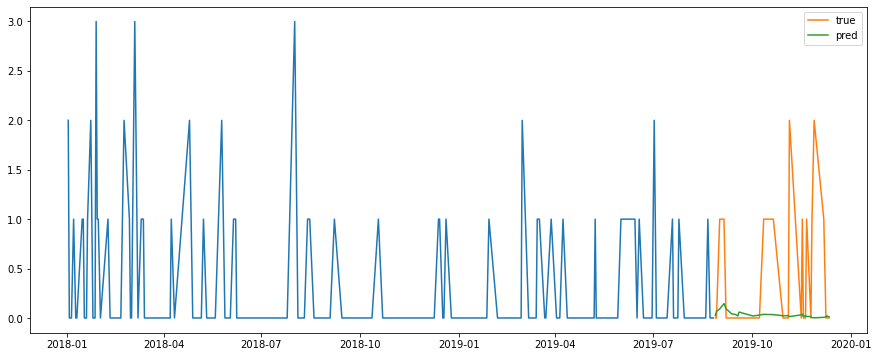

Test MSE: 0.526
Test RMSE: 0.725
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: invalid value encountered in true_divide
  


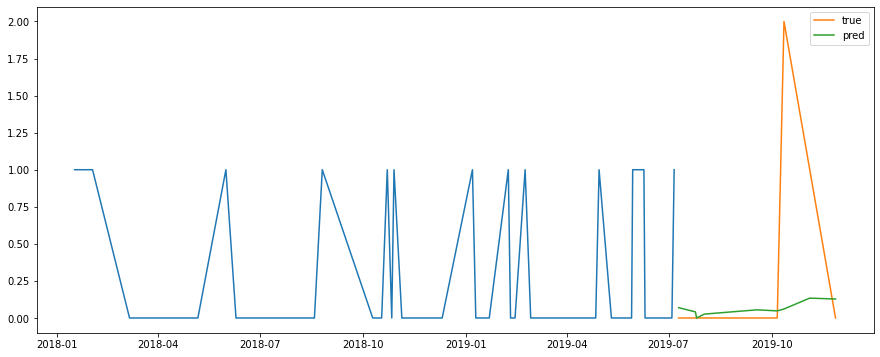

Test MSE: 0.504
Test RMSE: 0.710
Test MAPE: nan
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


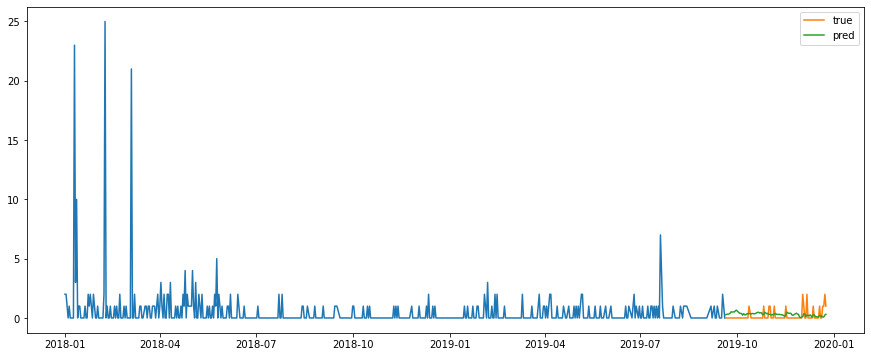

Test MSE: 0.294
Test RMSE: 0.542
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


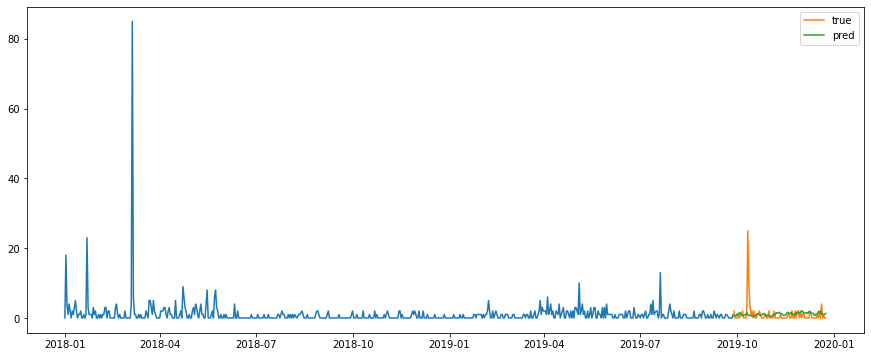

Test MSE: 8.836
Test RMSE: 2.973
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


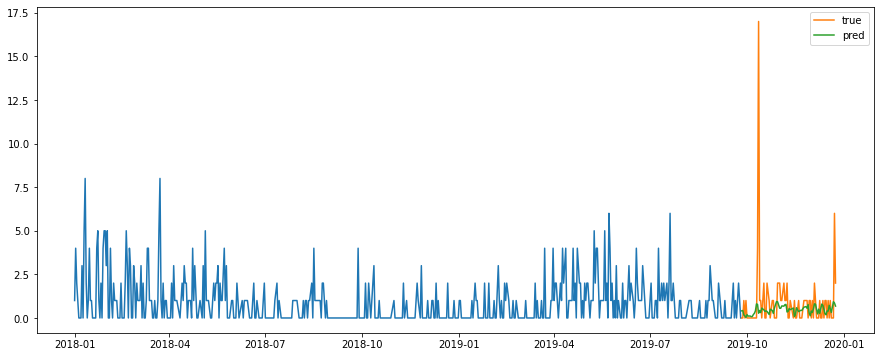

Test MSE: 4.417
Test RMSE: 2.102
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


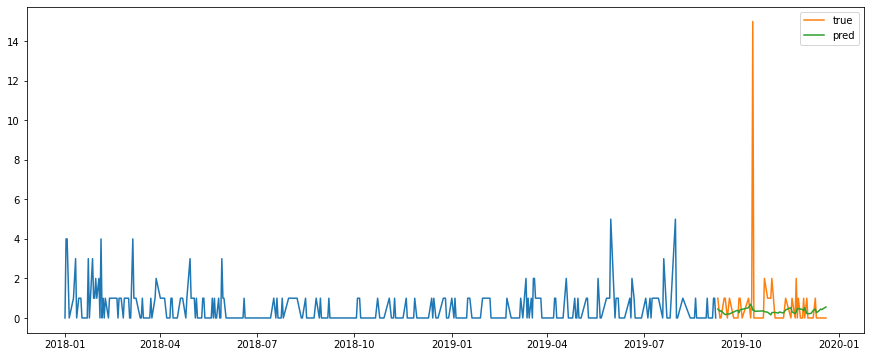

Test MSE: 4.765
Test RMSE: 2.183
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


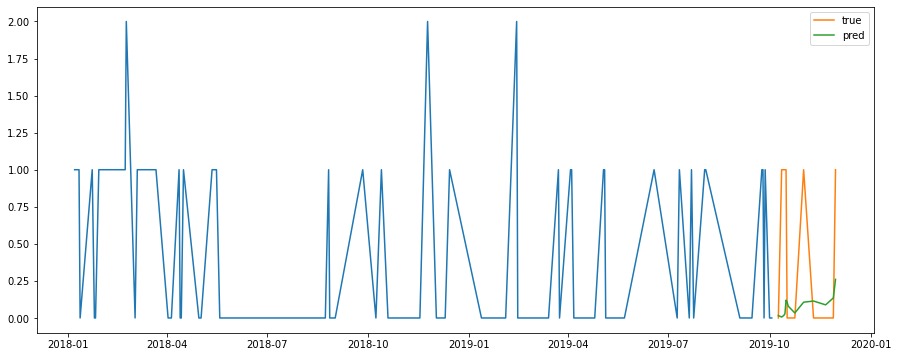

Test MSE: 0.390
Test RMSE: 0.625
Test MAPE: inf
소분류:  기능성 영양보습 화장품
성별:  남성 , 연령:  20대


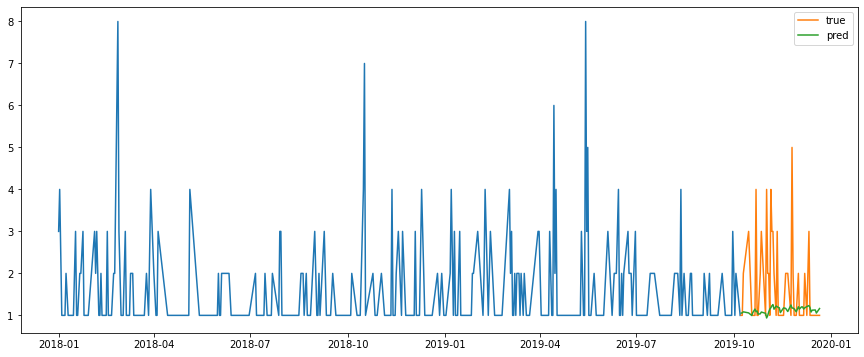

Test MSE: 1.435
Test RMSE: 1.198
Test MAPE: 30.566
성별:  남성 , 연령:  30대


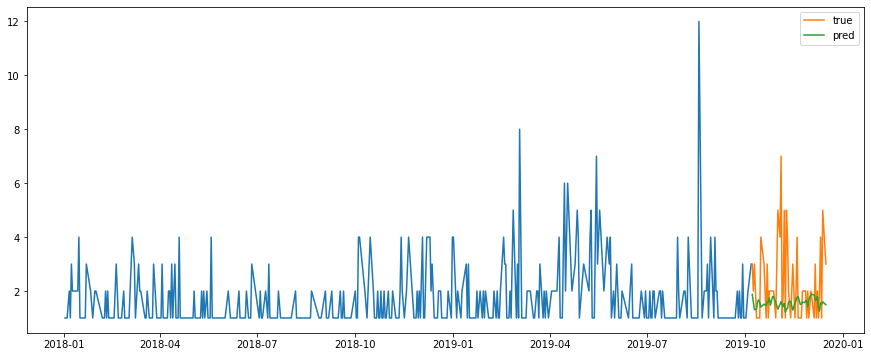

Test MSE: 2.599
Test RMSE: 1.612
Test MAPE: 46.621
성별:  남성 , 연령:  40대


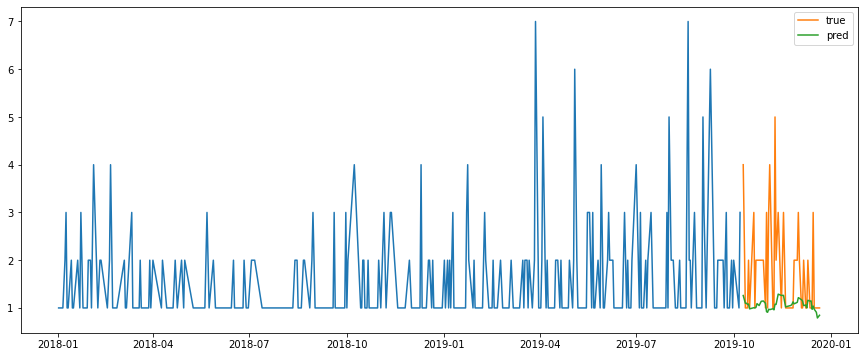

Test MSE: 1.423
Test RMSE: 1.193
Test MAPE: 30.714
성별:  남성 , 연령:  50대


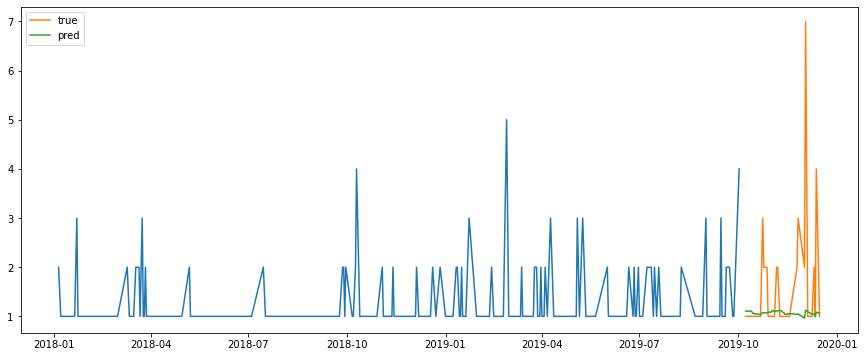

Test MSE: 1.722
Test RMSE: 1.312
Test MAPE: 23.775
성별:  남성 , 연령:  60대


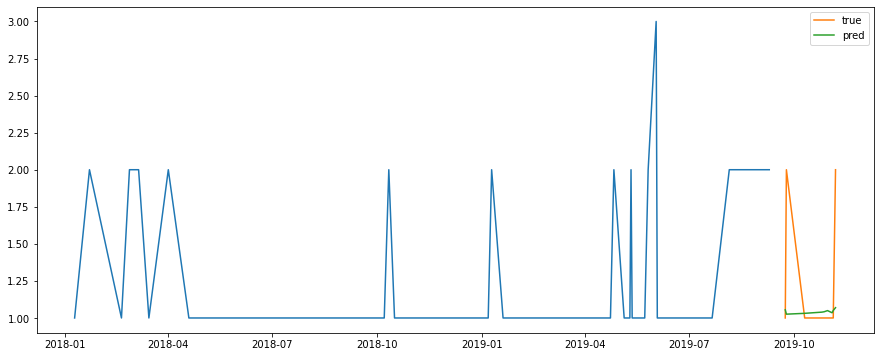

Test MSE: 0.203
Test RMSE: 0.451
Test MAPE: 13.950
성별:  여성  , 연령:  20대


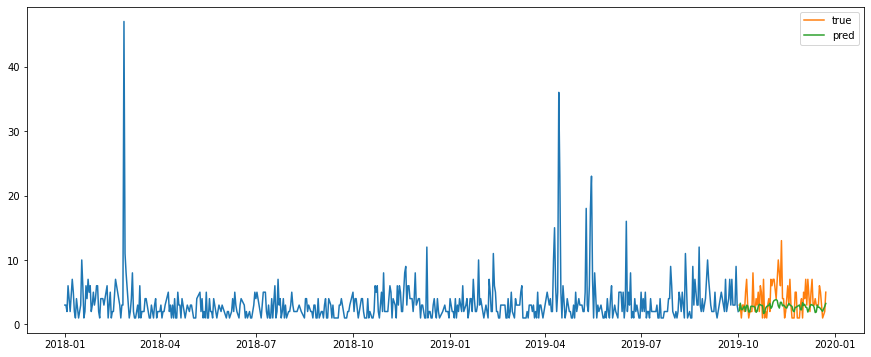

Test MSE: 6.764
Test RMSE: 2.601
Test MAPE: 58.490
성별:  여성  , 연령:  30대


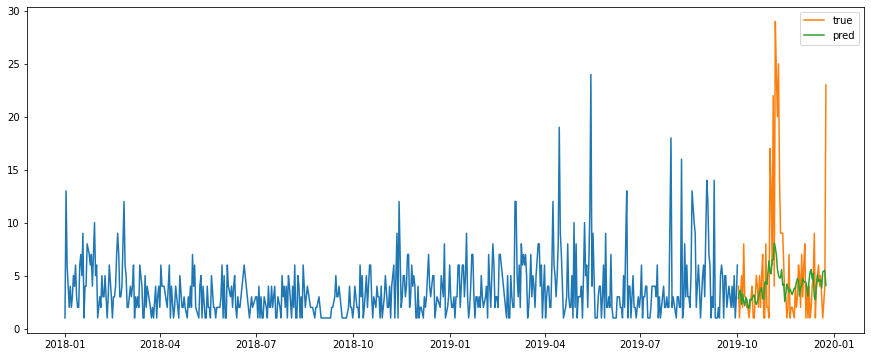

Test MSE: 32.610
Test RMSE: 5.710
Test MAPE: 90.941
성별:  여성  , 연령:  40대


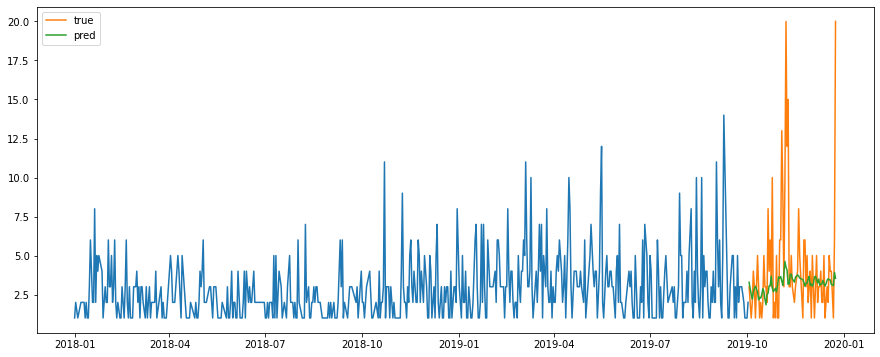

Test MSE: 14.717
Test RMSE: 3.836
Test MAPE: 65.231
성별:  여성  , 연령:  50대


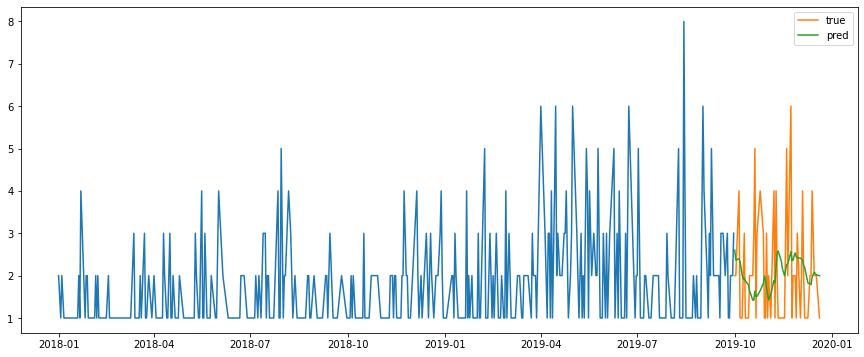

Test MSE: 1.680
Test RMSE: 1.296
Test MAPE: 61.998
성별:  여성  , 연령:  60대


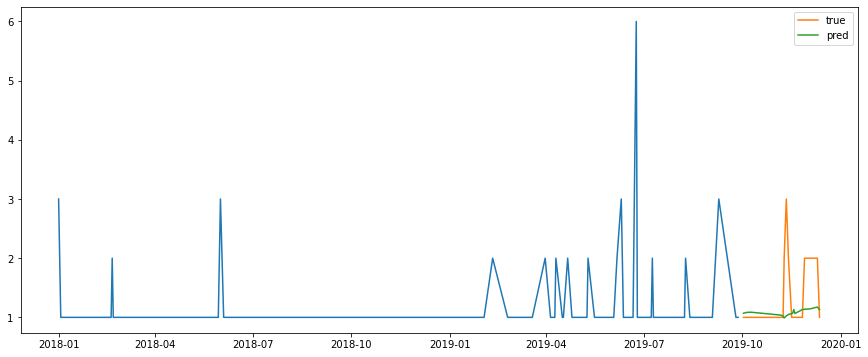

Test MSE: 0.426
Test RMSE: 0.653
Test MAPE: 20.916
소분류:  기초 화장용 오일/앰플
성별:  남성 , 연령:  20대


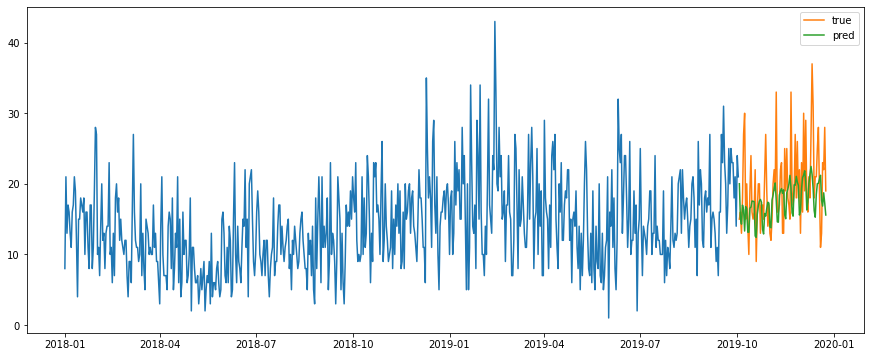

Test MSE: 33.698
Test RMSE: 5.805
Test MAPE: 21.527
성별:  남성 , 연령:  30대


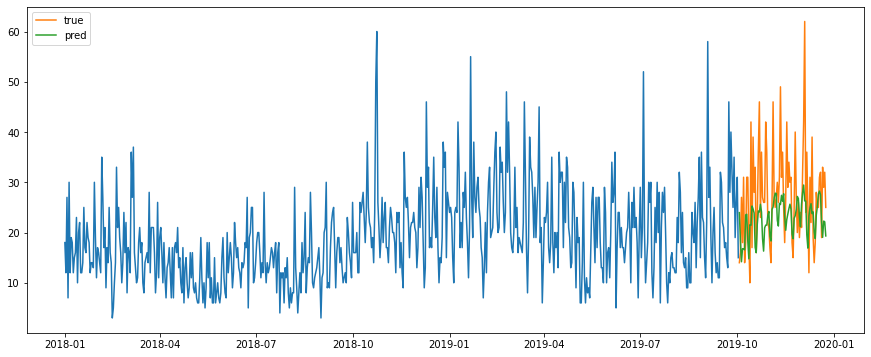

Test MSE: 101.212
Test RMSE: 10.060
Test MAPE: 26.639
성별:  남성 , 연령:  40대


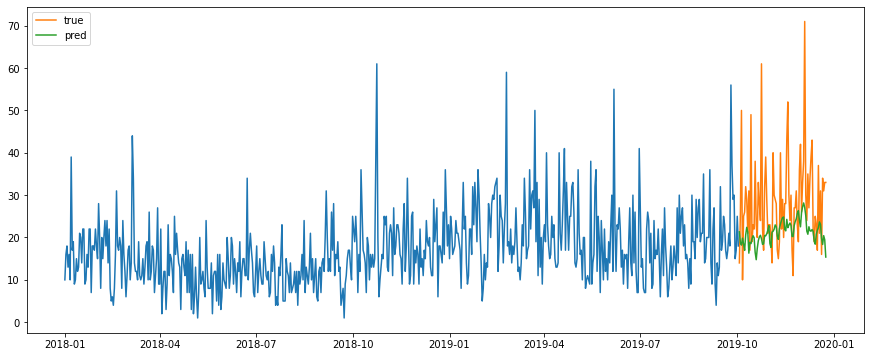

Test MSE: 159.762
Test RMSE: 12.640
Test MAPE: 28.910
성별:  남성 , 연령:  50대


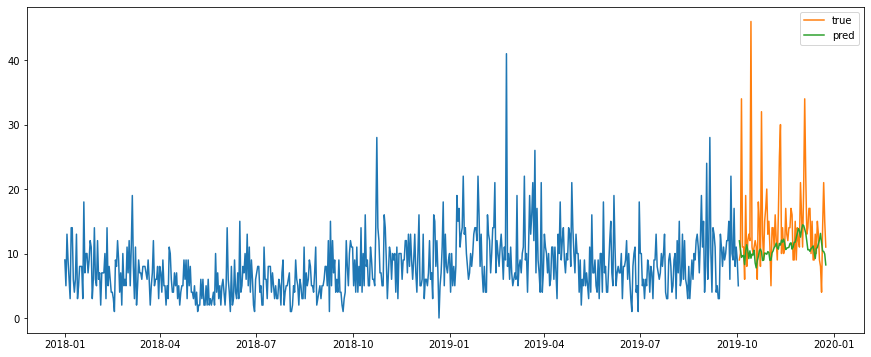

Test MSE: 57.026
Test RMSE: 7.552
Test MAPE: 30.722
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


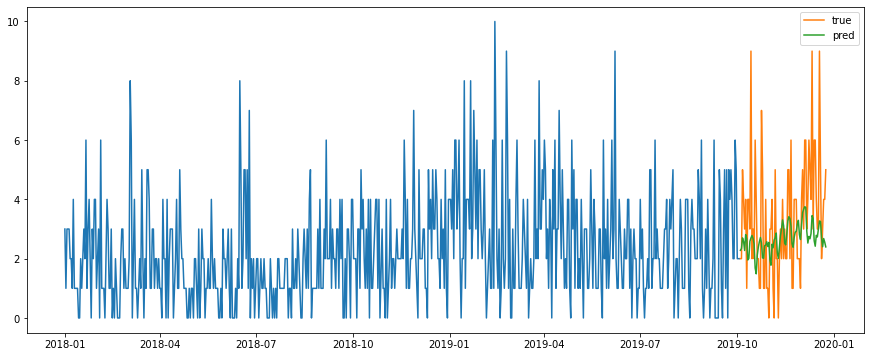

Test MSE: 4.052
Test RMSE: 2.013
Test MAPE: inf
성별:  여성  , 연령:  20대


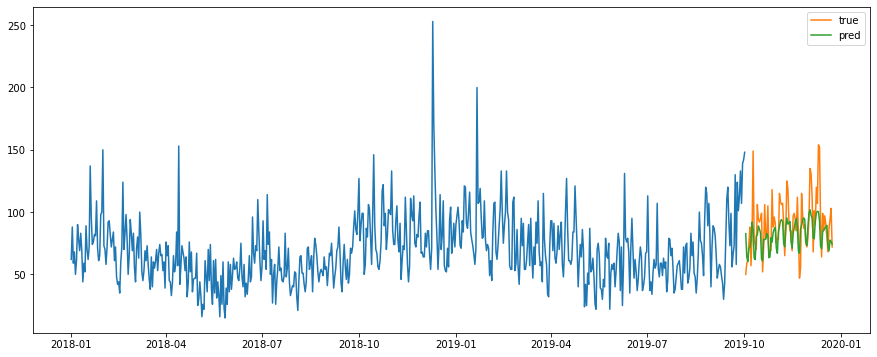

Test MSE: 375.115
Test RMSE: 19.368
Test MAPE: 15.156
성별:  여성  , 연령:  30대


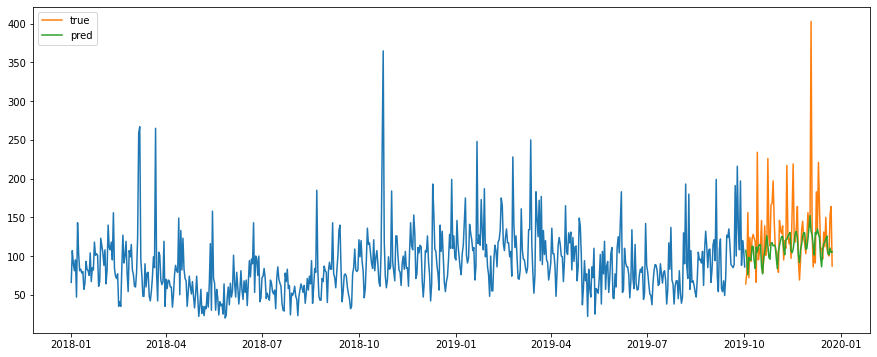

Test MSE: 2323.089
Test RMSE: 48.198
Test MAPE: 19.937
성별:  여성  , 연령:  40대


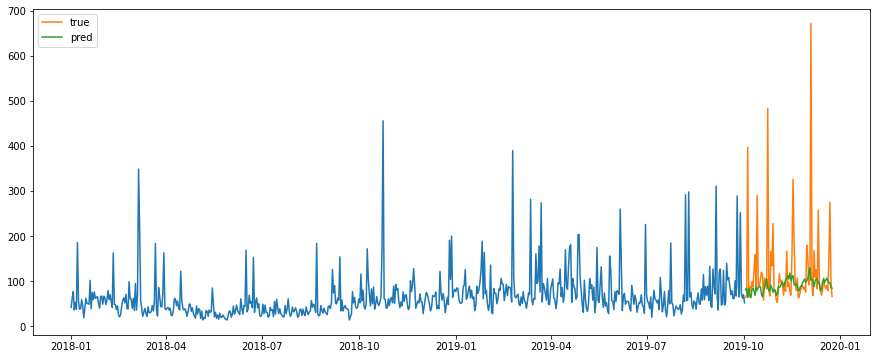

Test MSE: 10084.936
Test RMSE: 100.424
Test MAPE: 26.795
성별:  여성  , 연령:  50대


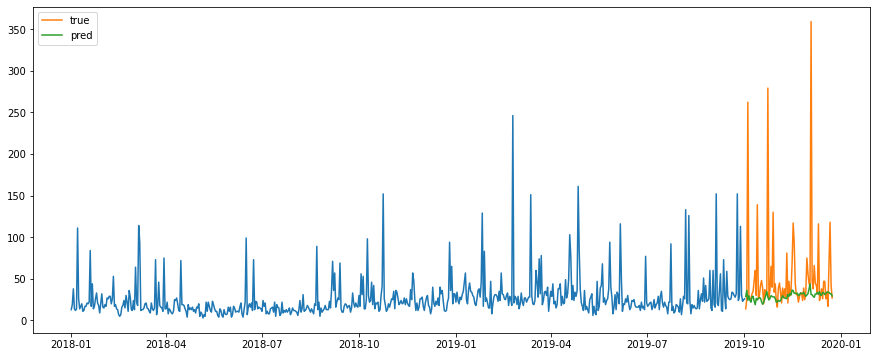

Test MSE: 3545.074
Test RMSE: 59.541
Test MAPE: 32.904
성별:  여성  , 연령:  60대


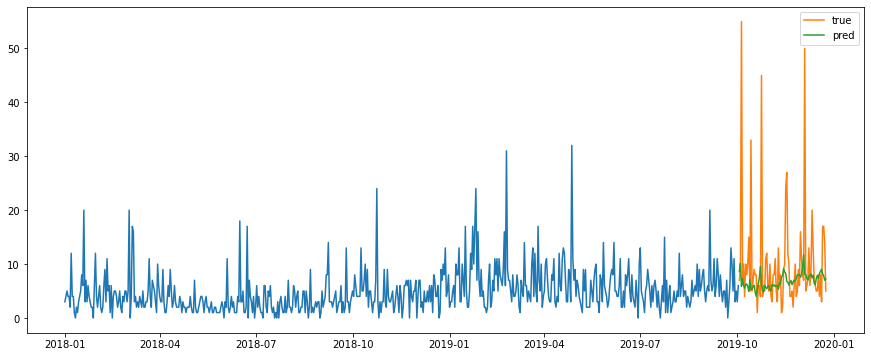

Test MSE: 100.990
Test RMSE: 10.049
Test MAPE: 60.145
소분류:  기타 농산물
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


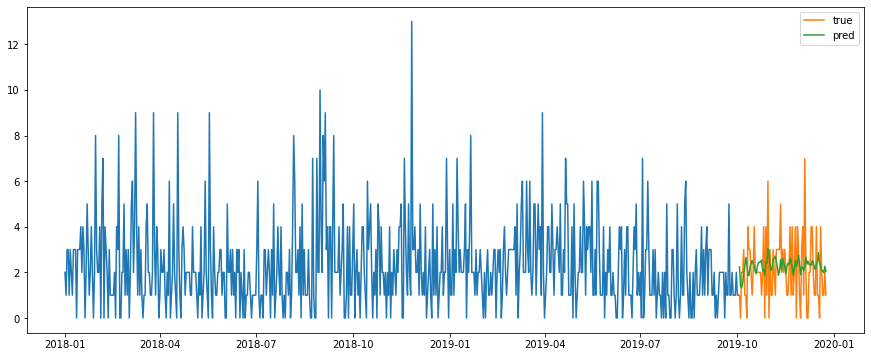

Test MSE: 2.051
Test RMSE: 1.432
Test MAPE: inf
성별:  남성 , 연령:  30대


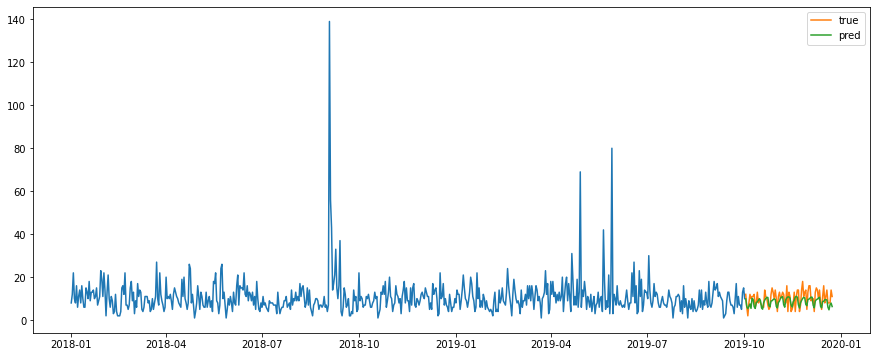

Test MSE: 12.168
Test RMSE: 3.488
Test MAPE: 30.311
성별:  남성 , 연령:  40대


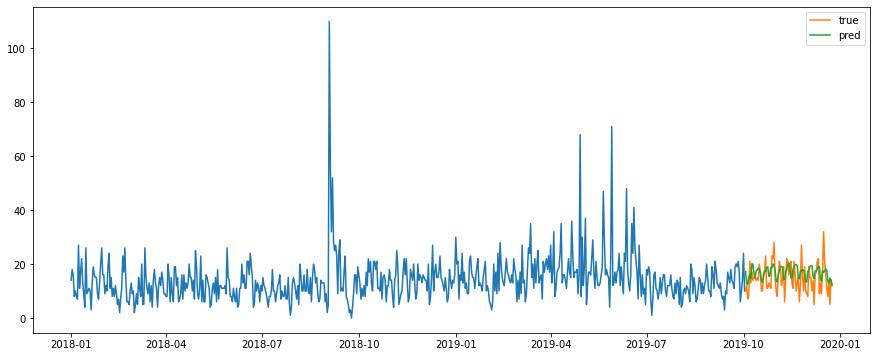

Test MSE: 27.713
Test RMSE: 5.264
Test MAPE: 38.011
성별:  남성 , 연령:  50대


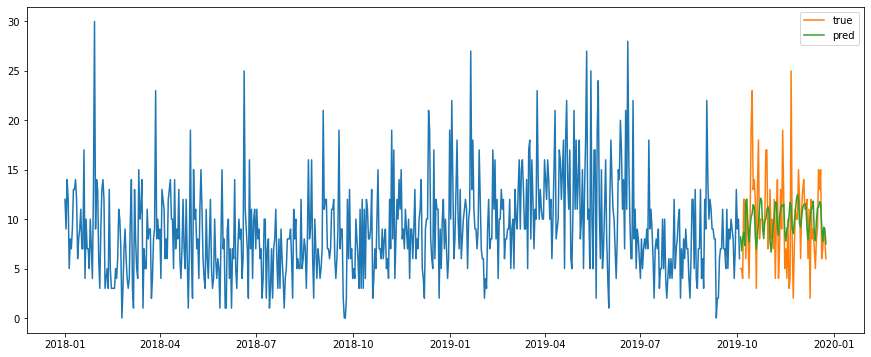

Test MSE: 17.467
Test RMSE: 4.179
Test MAPE: 47.039
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


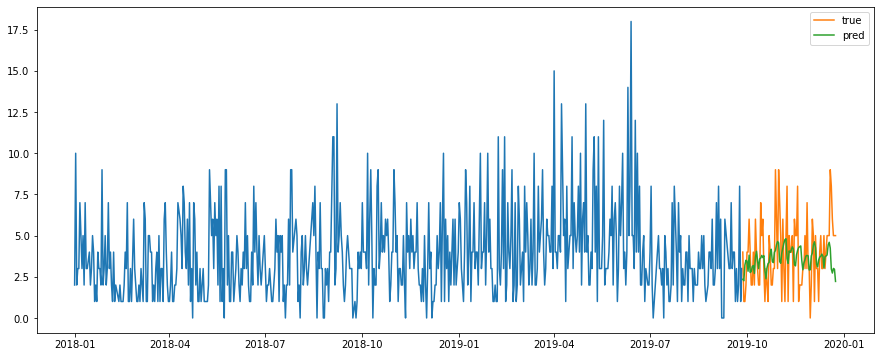

Test MSE: 4.376
Test RMSE: 2.092
Test MAPE: inf
성별:  여성  , 연령:  20대


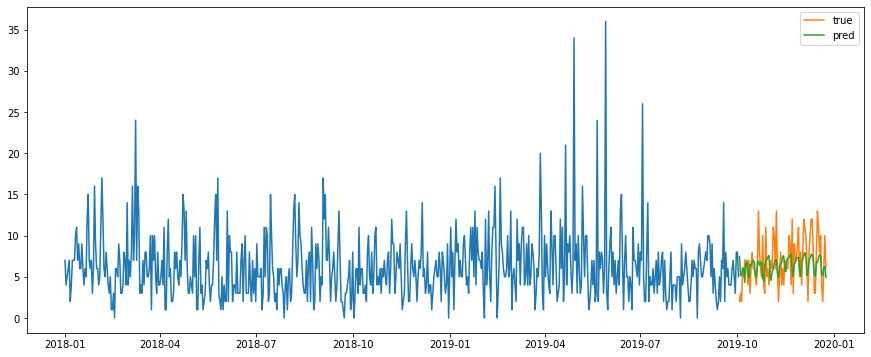

Test MSE: 7.426
Test RMSE: 2.725
Test MAPE: 40.691
성별:  여성  , 연령:  30대


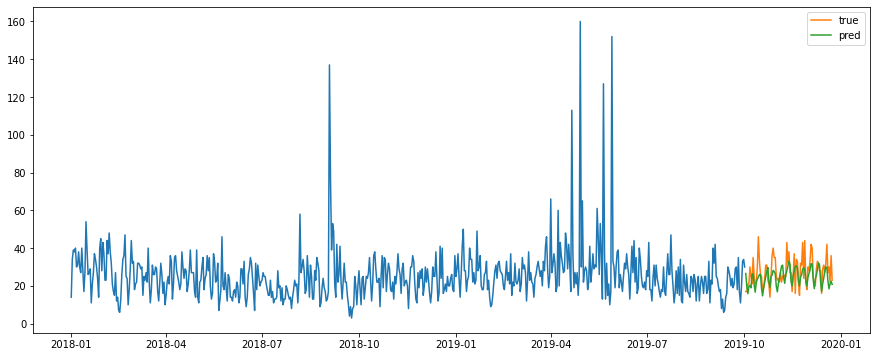

Test MSE: 46.043
Test RMSE: 6.785
Test MAPE: 18.683
성별:  여성  , 연령:  40대


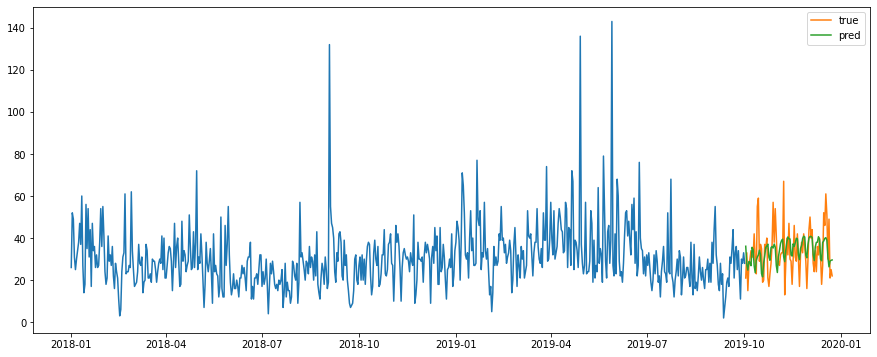

Test MSE: 109.116
Test RMSE: 10.446
Test MAPE: 26.479
성별:  여성  , 연령:  50대


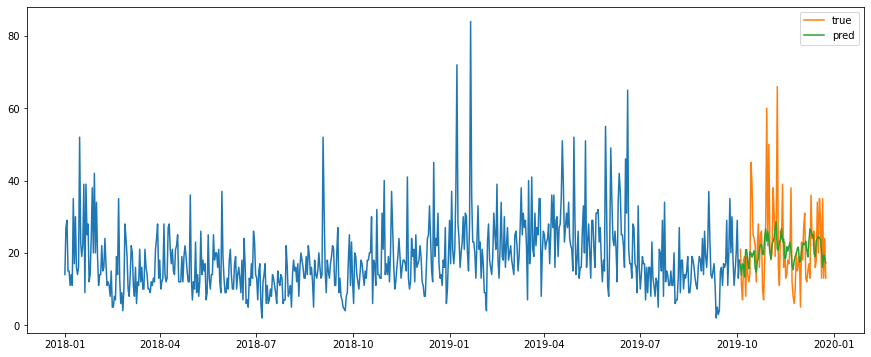

Test MSE: 113.977
Test RMSE: 10.676
Test MAPE: 42.389
성별:  여성  , 연령:  60대


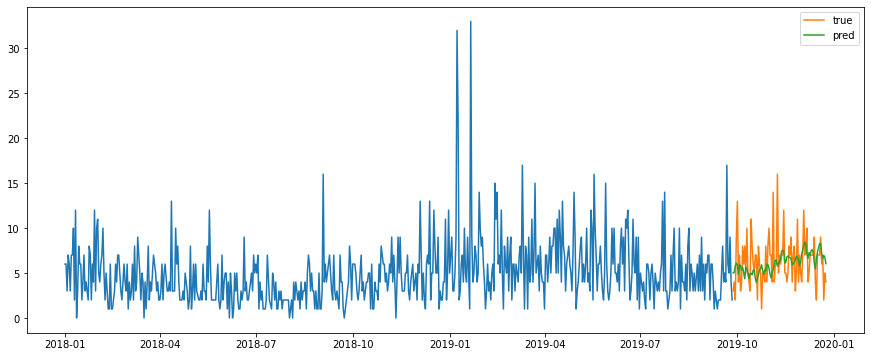

Test MSE: 7.659
Test RMSE: 2.768
Test MAPE: 42.425
소분류:  기타 한방/환제품
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


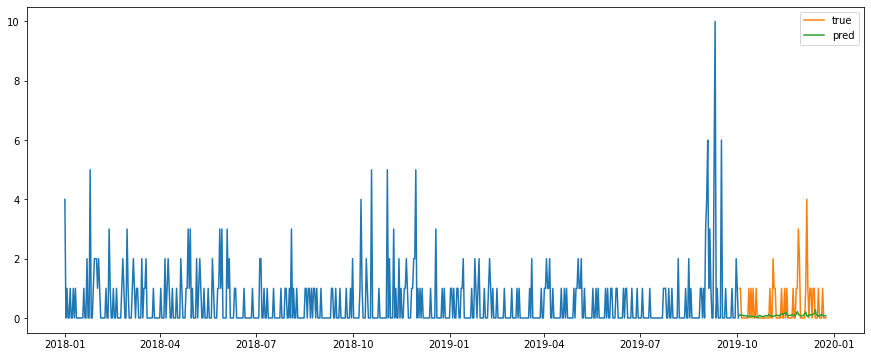

Test MSE: 0.605
Test RMSE: 0.778
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


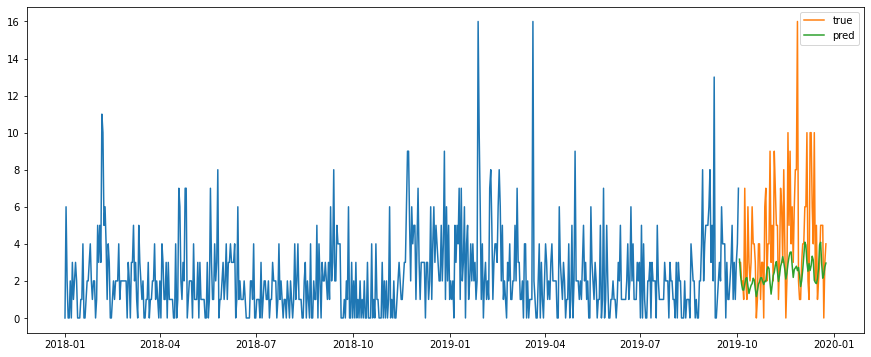

Test MSE: 11.487
Test RMSE: 3.389
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


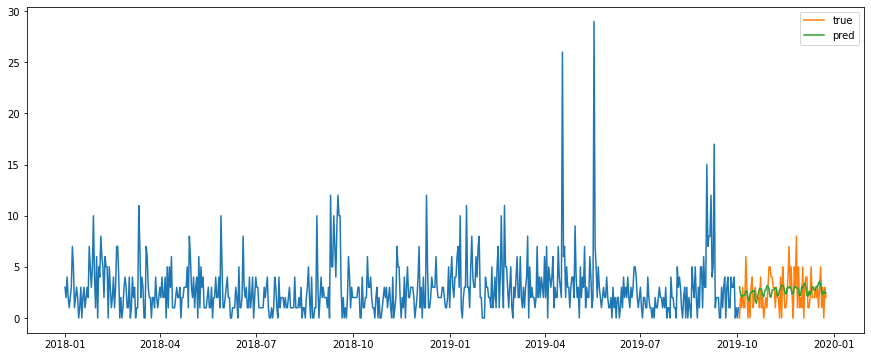

Test MSE: 2.858
Test RMSE: 1.691
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


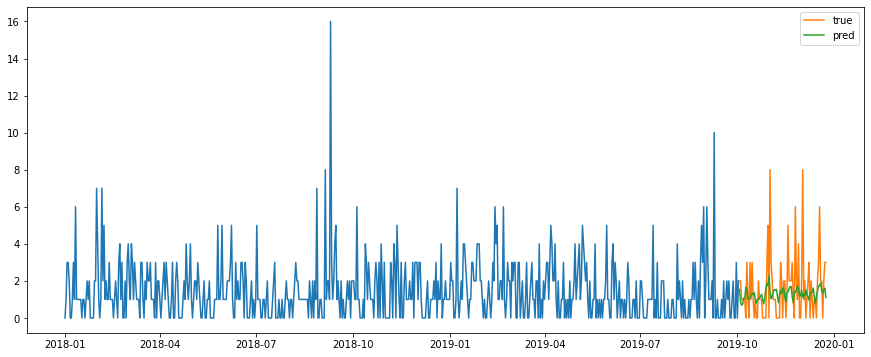

Test MSE: 2.916
Test RMSE: 1.708
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


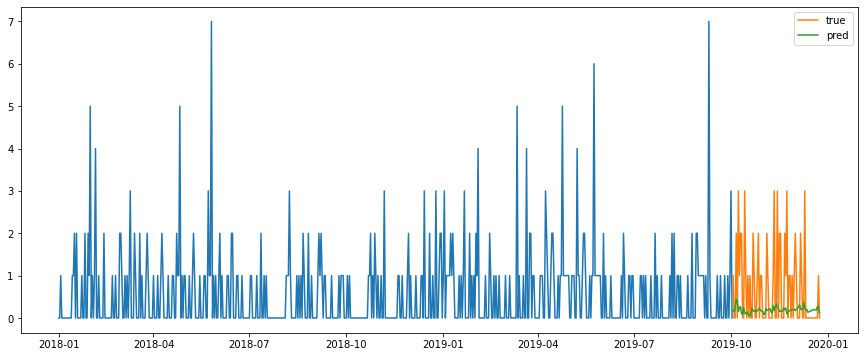

Test MSE: 1.186
Test RMSE: 1.089
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


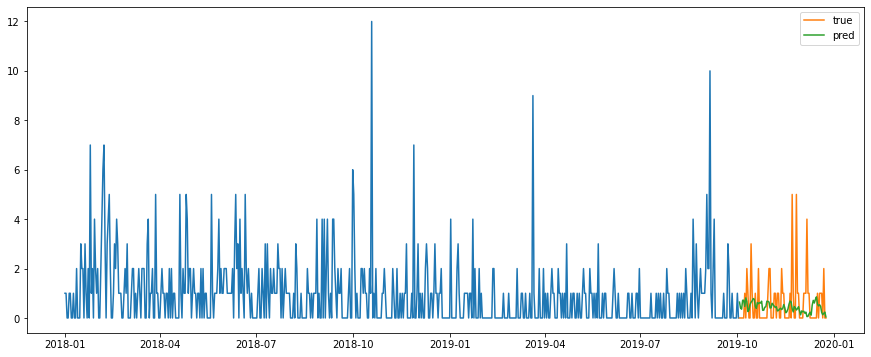

Test MSE: 1.214
Test RMSE: 1.102
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


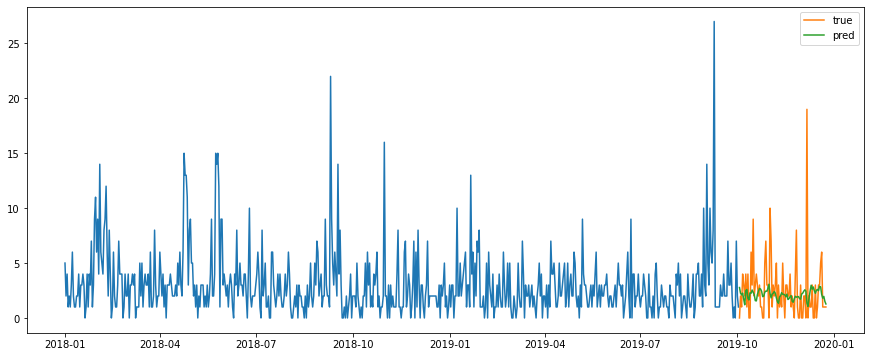

Test MSE: 8.579
Test RMSE: 2.929
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


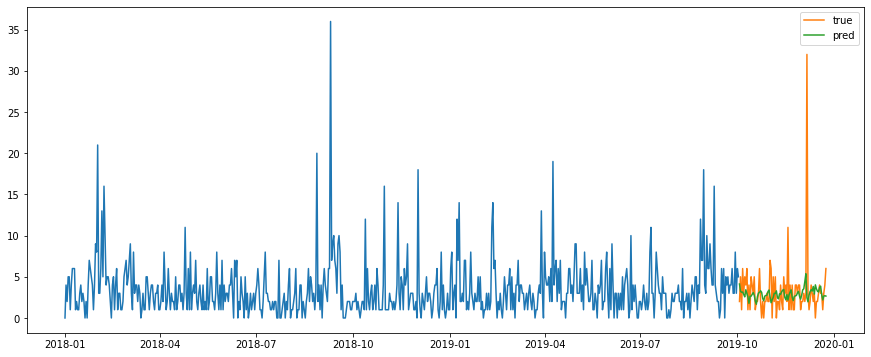

Test MSE: 14.499
Test RMSE: 3.808
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


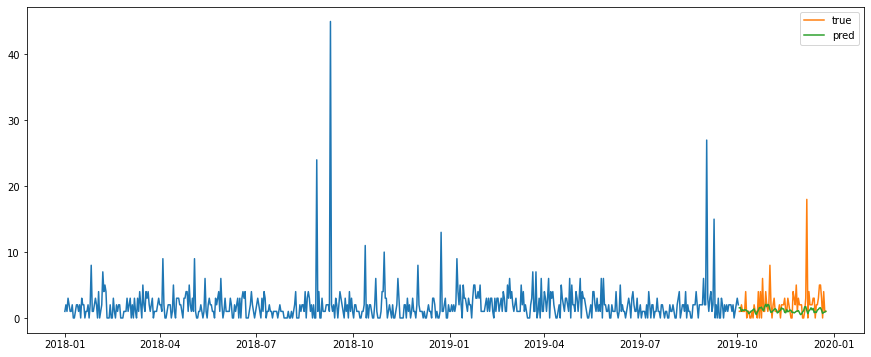

Test MSE: 6.277
Test RMSE: 2.505
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


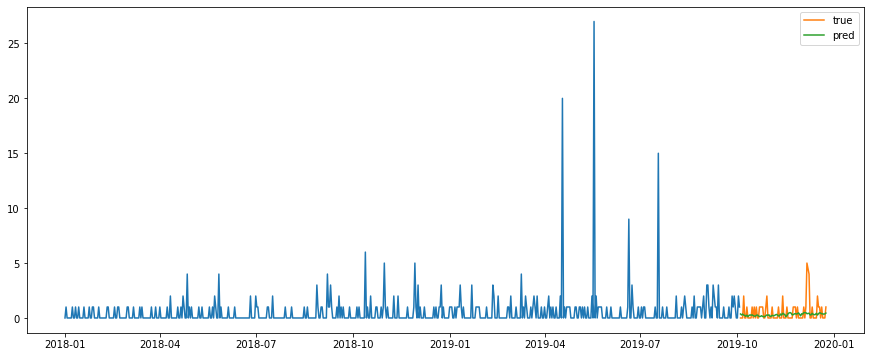

Test MSE: 0.764
Test RMSE: 0.874
Test MAPE: inf
소분류:  나물
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


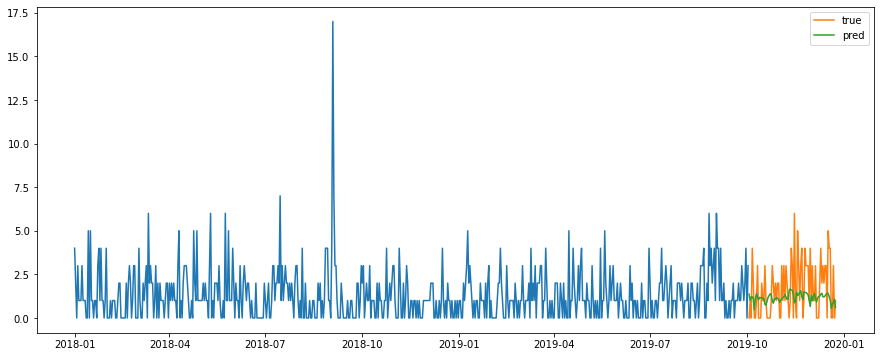

Test MSE: 2.588
Test RMSE: 1.609
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


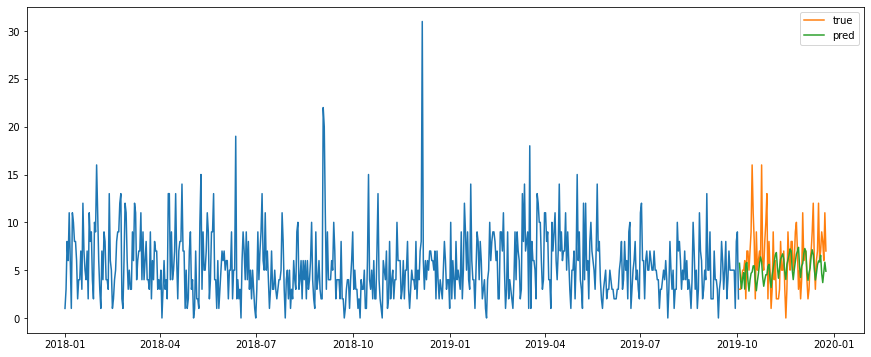

Test MSE: 10.686
Test RMSE: 3.269
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


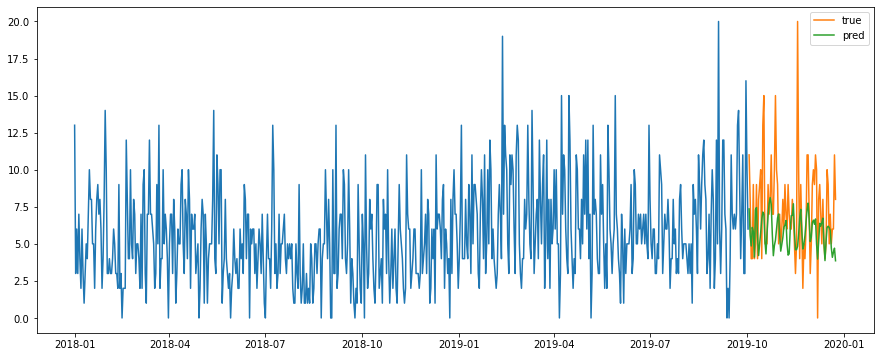

Test MSE: 11.039
Test RMSE: 3.322
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


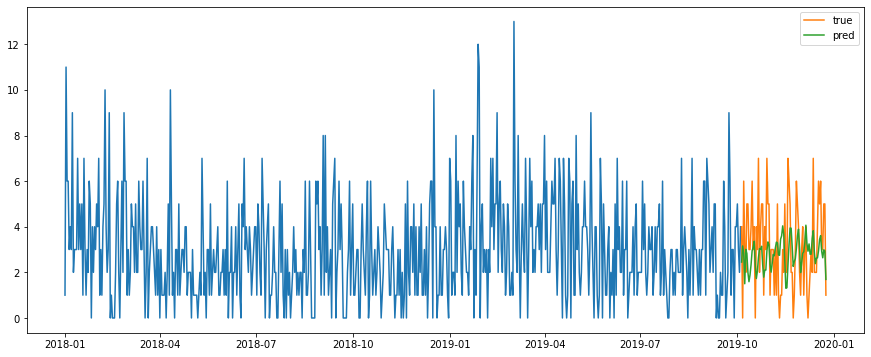

Test MSE: 3.672
Test RMSE: 1.916
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


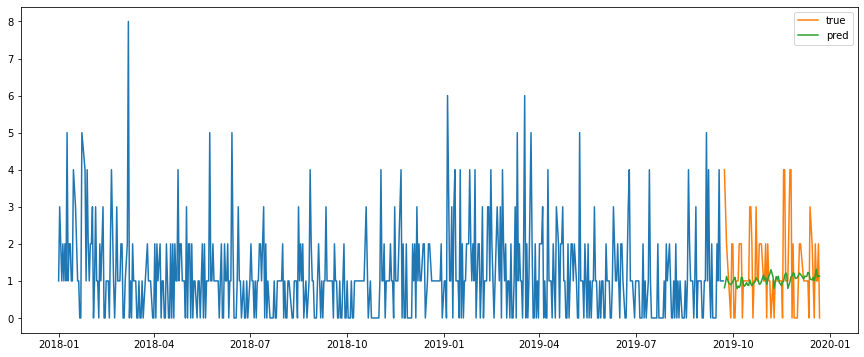

Test MSE: 1.258
Test RMSE: 1.122
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


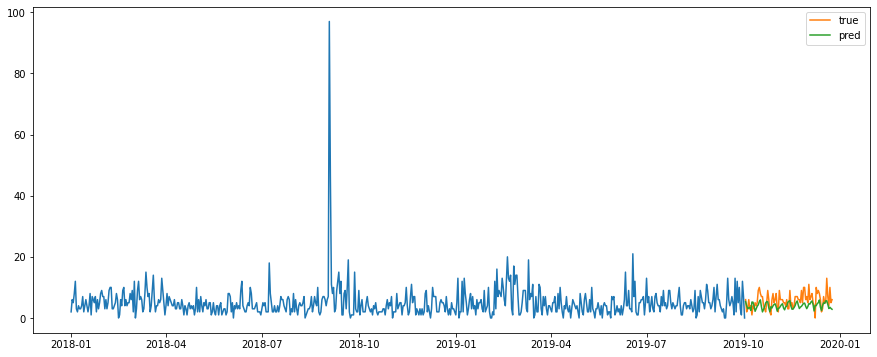

Test MSE: 8.378
Test RMSE: 2.894
Test MAPE: inf
성별:  여성  , 연령:  30대


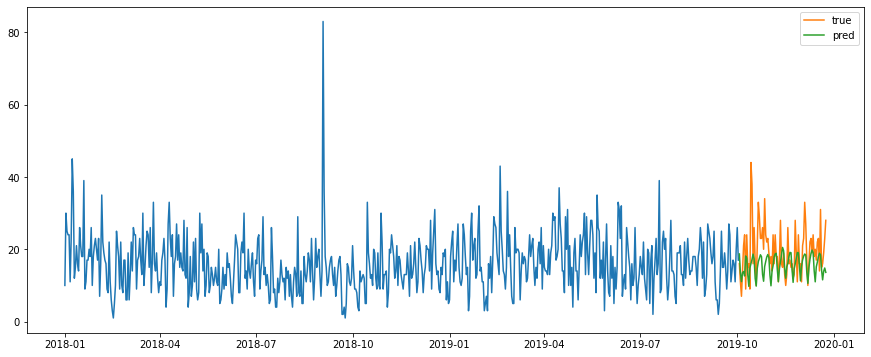

Test MSE: 57.281
Test RMSE: 7.568
Test MAPE: 26.884
성별:  여성  , 연령:  40대


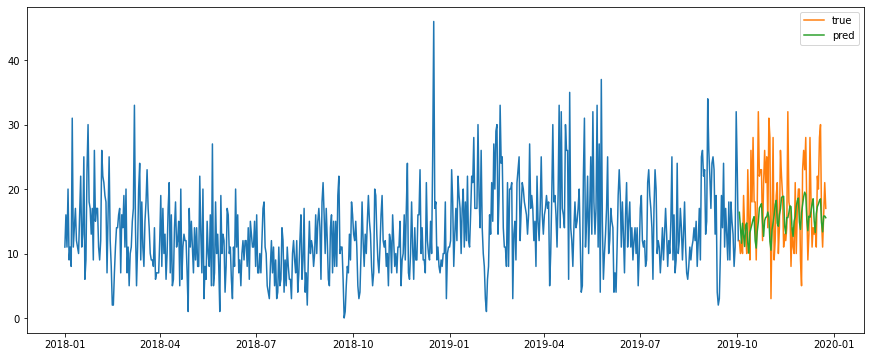

Test MSE: 45.868
Test RMSE: 6.773
Test MAPE: 34.713
성별:  여성  , 연령:  50대


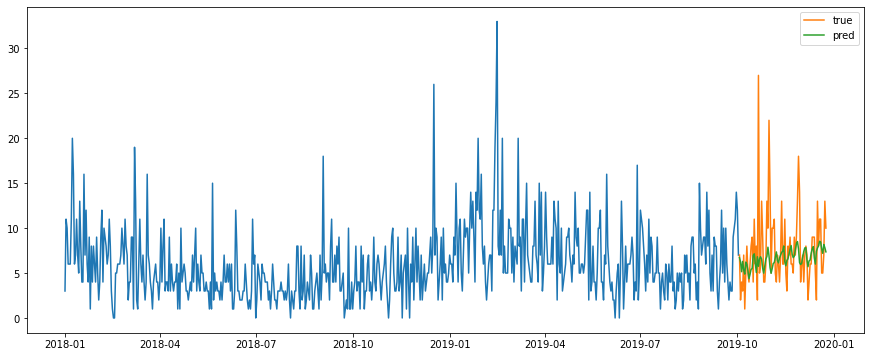

Test MSE: 18.136
Test RMSE: 4.259
Test MAPE: 45.117
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


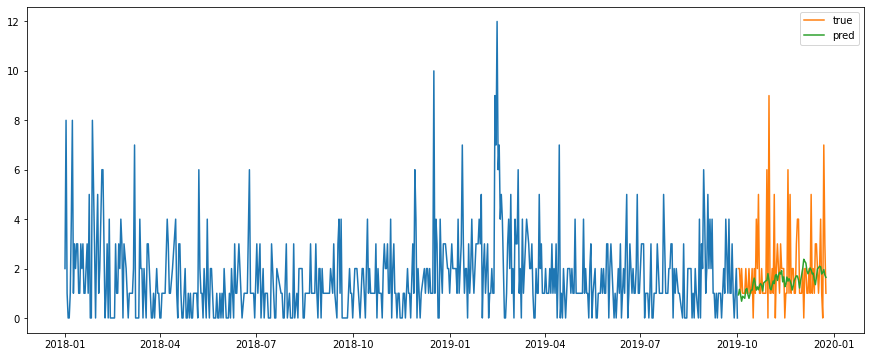

Test MSE: 2.989
Test RMSE: 1.729
Test MAPE: inf
소분류:  남성 스킨
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


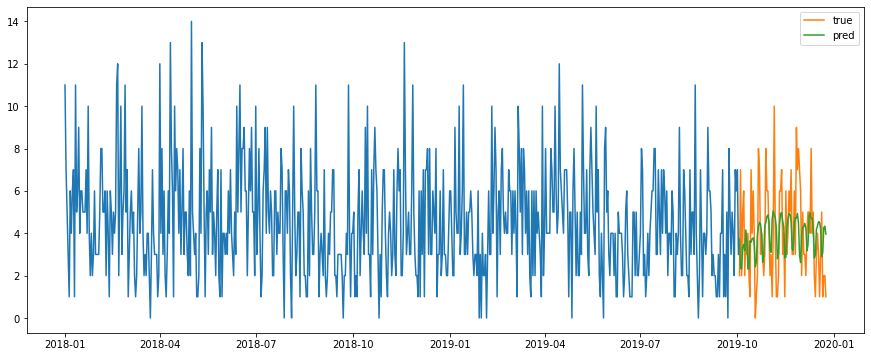

Test MSE: 4.258
Test RMSE: 2.064
Test MAPE: inf
성별:  남성 , 연령:  30대


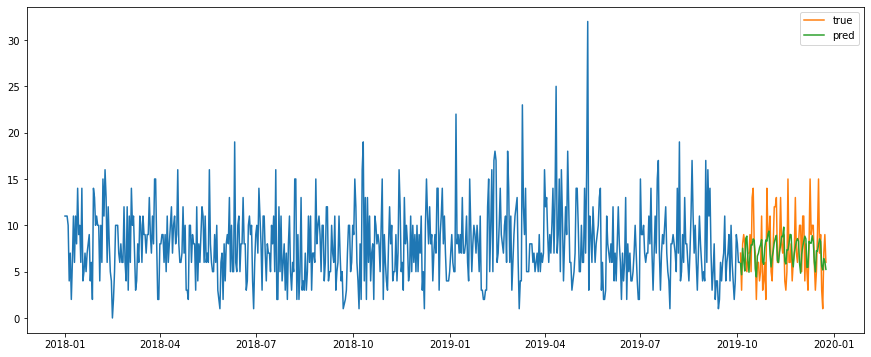

Test MSE: 8.826
Test RMSE: 2.971
Test MAPE: 42.002
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


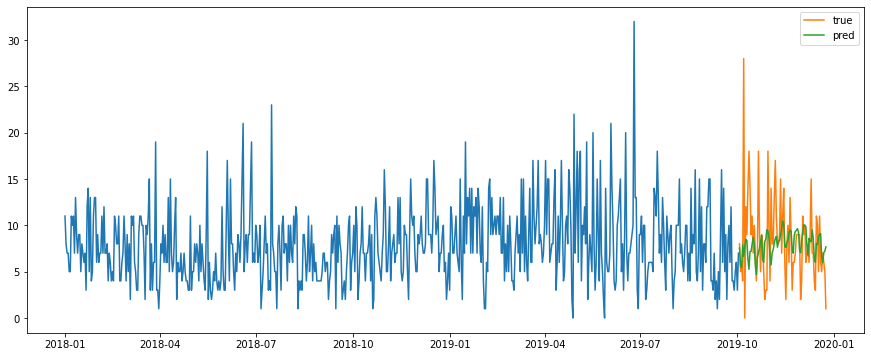

Test MSE: 20.851
Test RMSE: 4.566
Test MAPE: inf
성별:  남성 , 연령:  50대


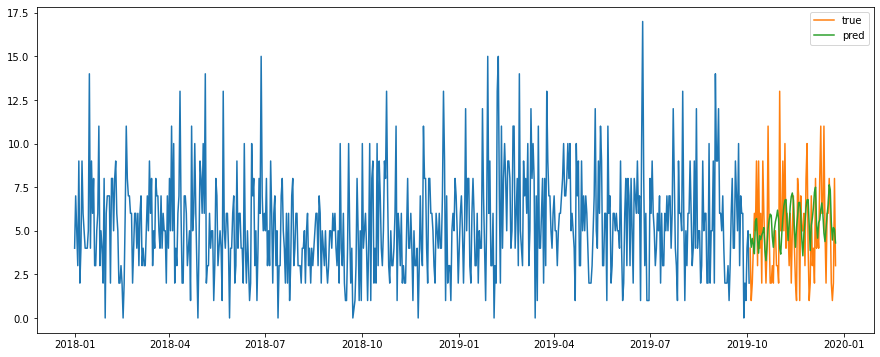

Test MSE: 7.687
Test RMSE: 2.773
Test MAPE: 75.772
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


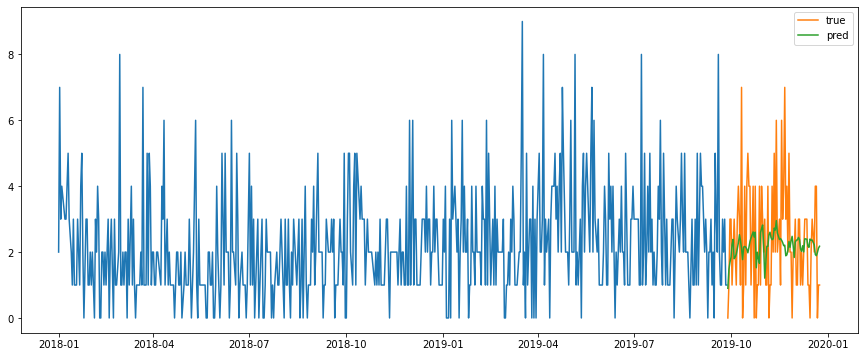

Test MSE: 2.656
Test RMSE: 1.630
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


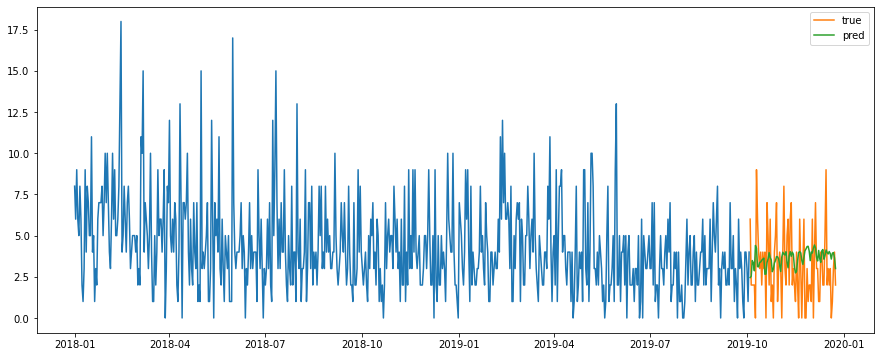

Test MSE: 5.291
Test RMSE: 2.300
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


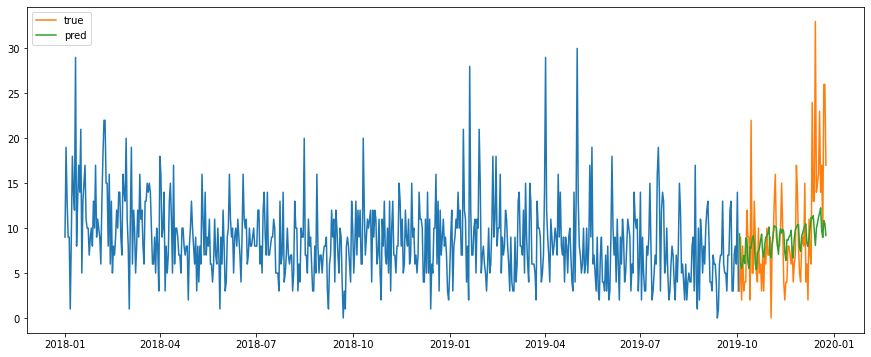

Test MSE: 31.558
Test RMSE: 5.618
Test MAPE: inf
성별:  여성  , 연령:  40대


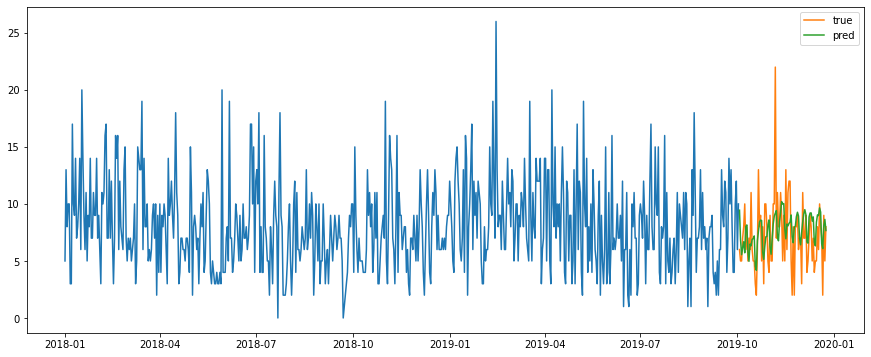

Test MSE: 8.786
Test RMSE: 2.964
Test MAPE: 41.288
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


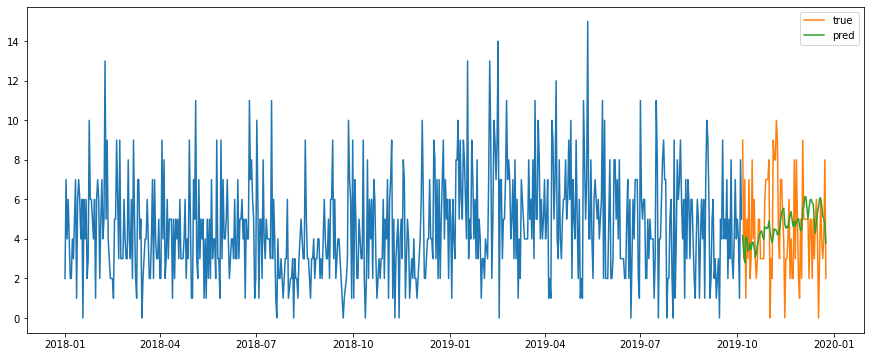

Test MSE: 6.146
Test RMSE: 2.479
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


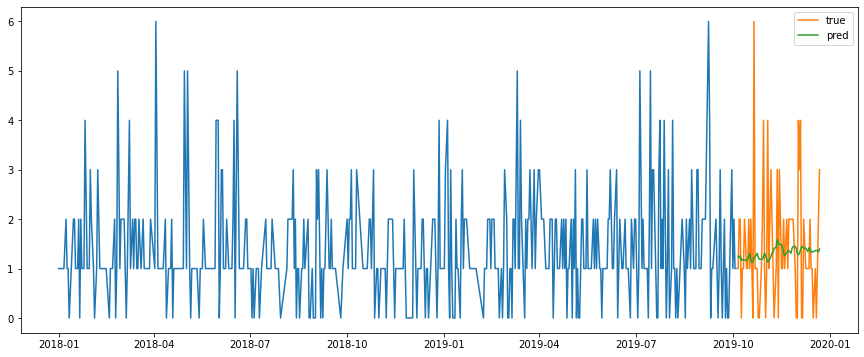

Test MSE: 1.492
Test RMSE: 1.222
Test MAPE: inf
소분류:  남성 크림
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


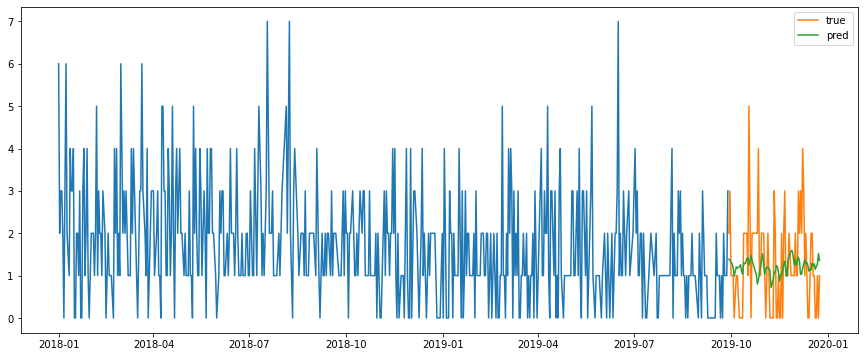

Test MSE: 1.163
Test RMSE: 1.079
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


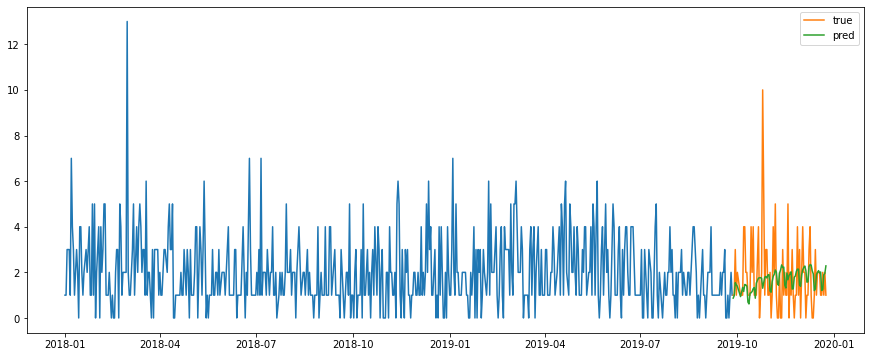

Test MSE: 2.634
Test RMSE: 1.623
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


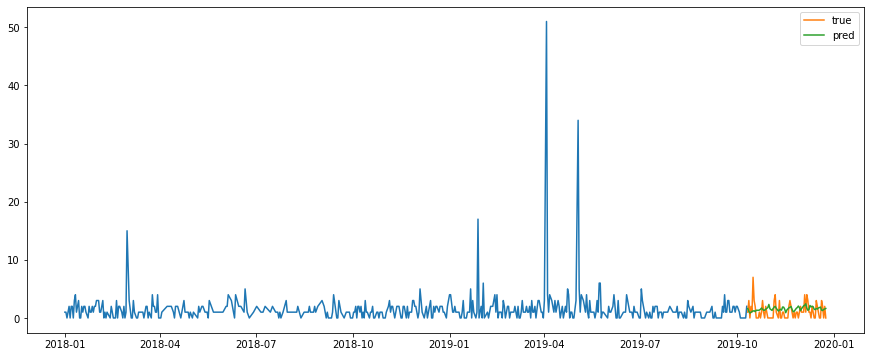

Test MSE: 2.075
Test RMSE: 1.441
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


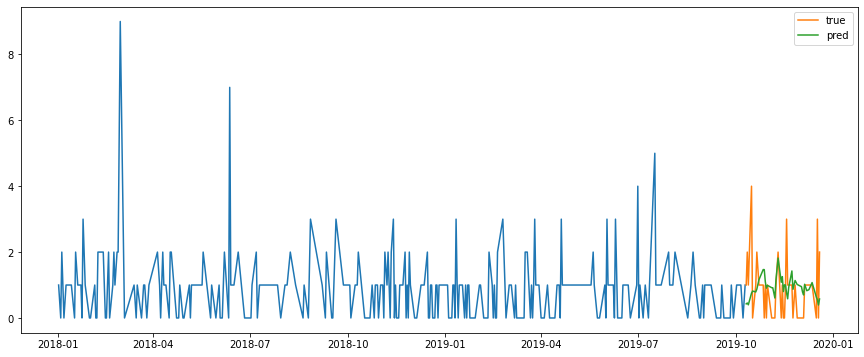

Test MSE: 1.016
Test RMSE: 1.008
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


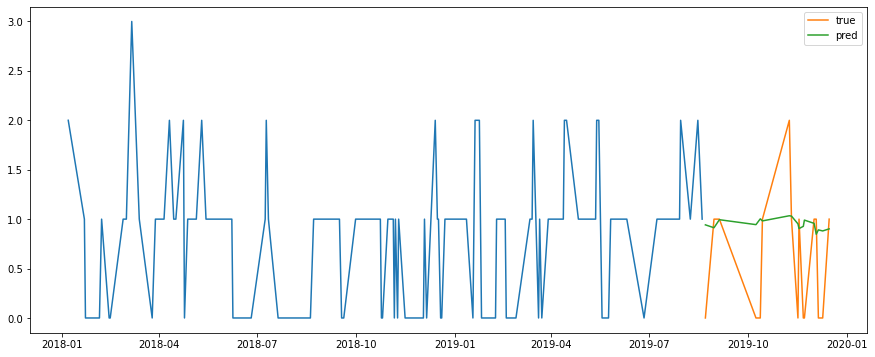

Test MSE: 0.476
Test RMSE: 0.690
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


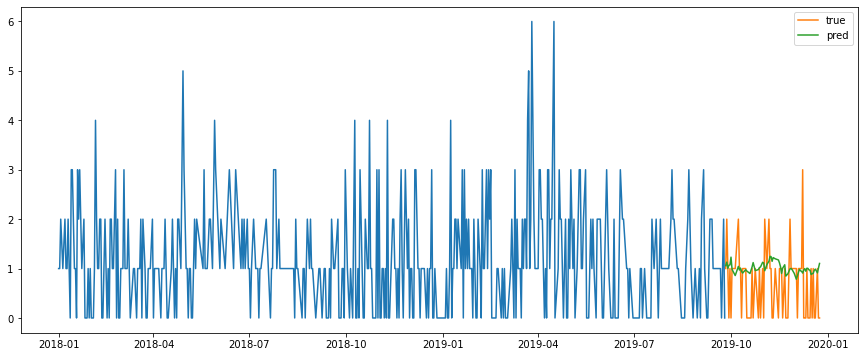

Test MSE: 0.568
Test RMSE: 0.754
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


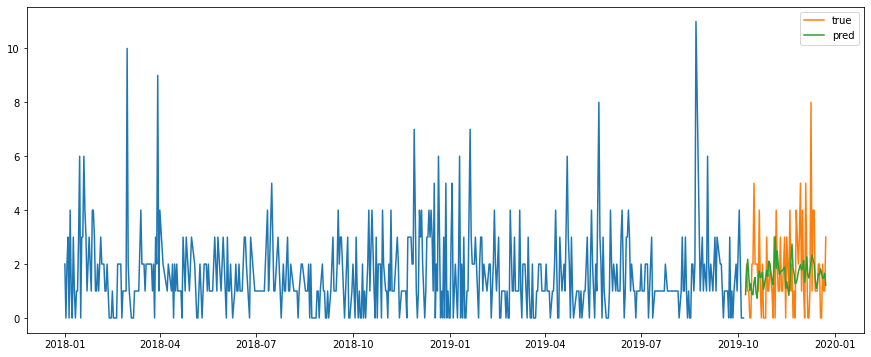

Test MSE: 2.440
Test RMSE: 1.562
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


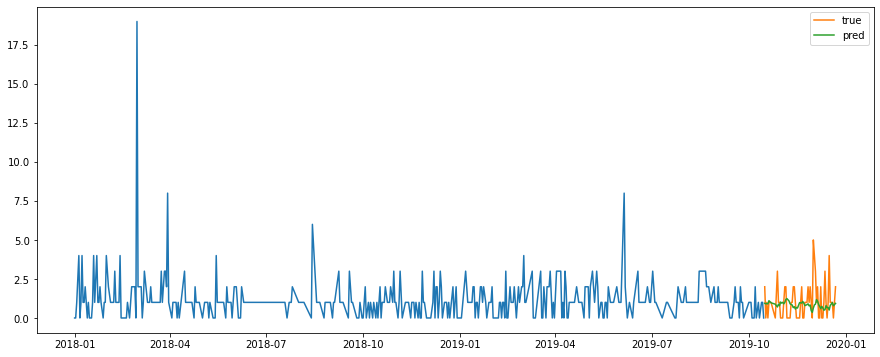

Test MSE: 1.549
Test RMSE: 1.244
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


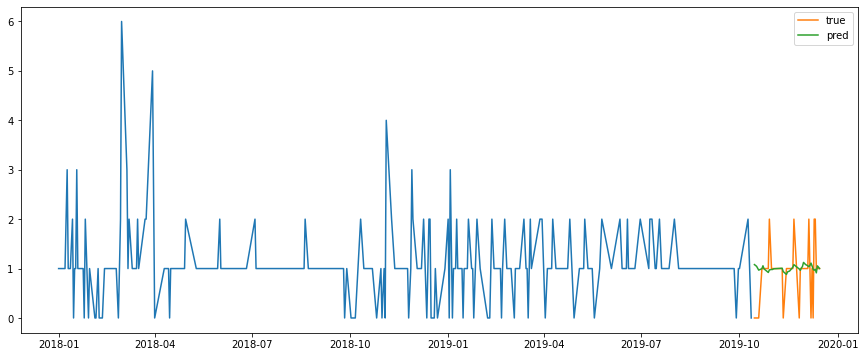

Test MSE: 0.350
Test RMSE: 0.592
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


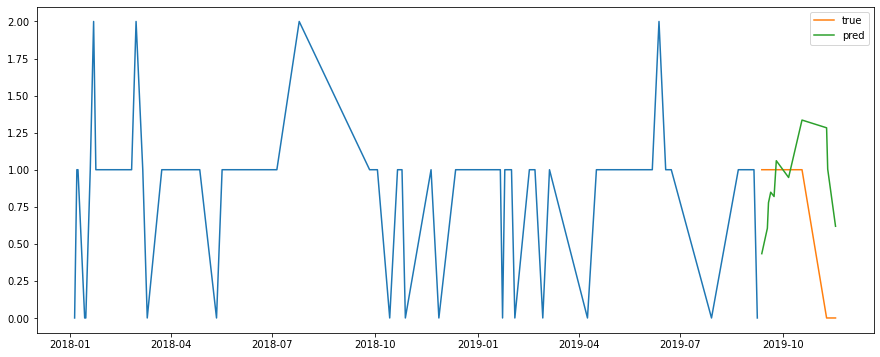

Test MSE: 0.340
Test RMSE: 0.583
Test MAPE: inf
소분류:  남성 클렌징
성별:  남성 , 연령:  20대


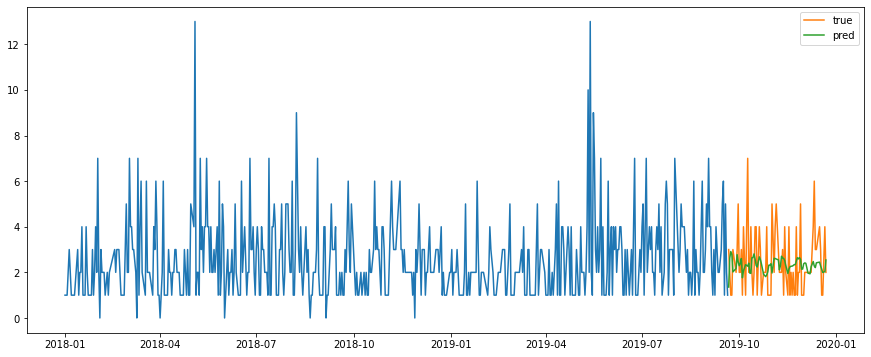

Test MSE: 1.963
Test RMSE: 1.401
Test MAPE: 58.961
성별:  남성 , 연령:  30대


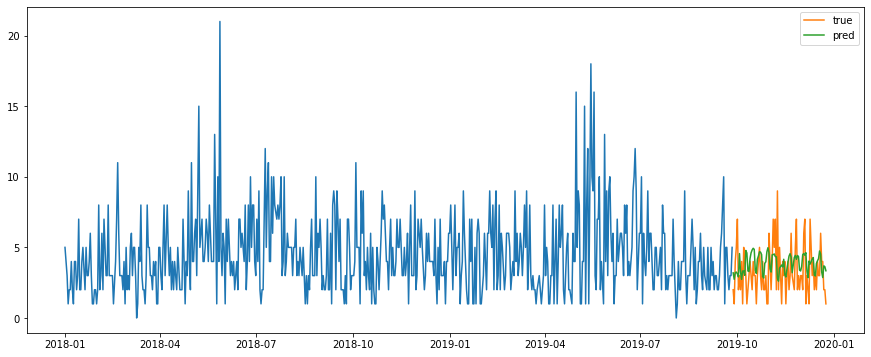

Test MSE: 3.550
Test RMSE: 1.884
Test MAPE: 73.513
성별:  남성 , 연령:  40대


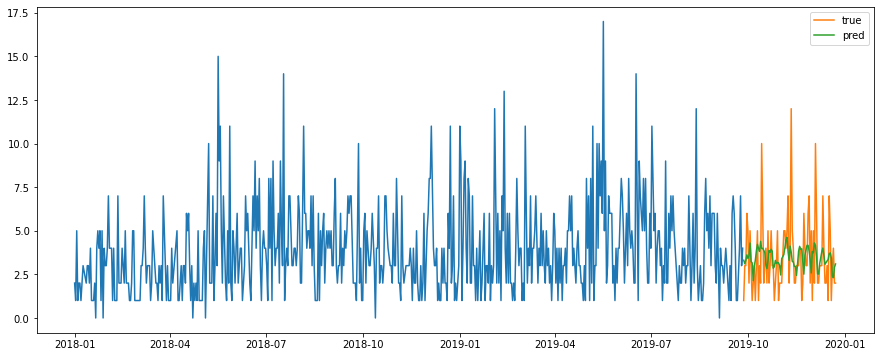

Test MSE: 4.035
Test RMSE: 2.009
Test MAPE: 59.702
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


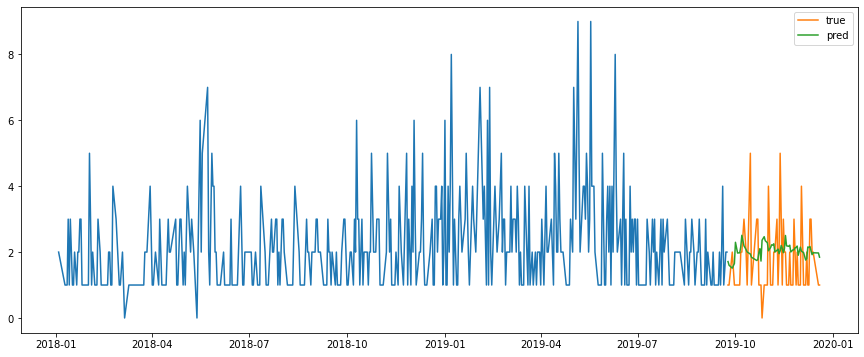

Test MSE: 1.258
Test RMSE: 1.122
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


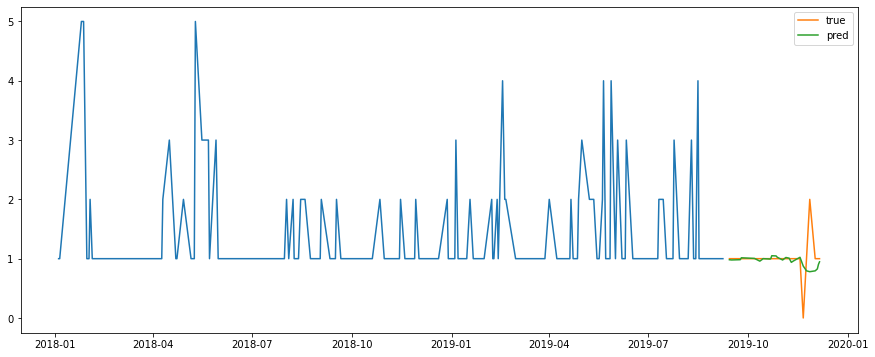

Test MSE: 0.089
Test RMSE: 0.298
Test MAPE: inf
성별:  여성  , 연령:  20대


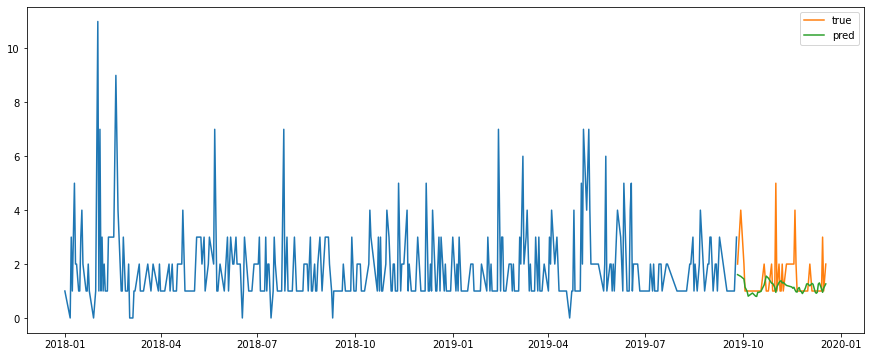

Test MSE: 0.829
Test RMSE: 0.911
Test MAPE: 26.058
성별:  여성  , 연령:  30대


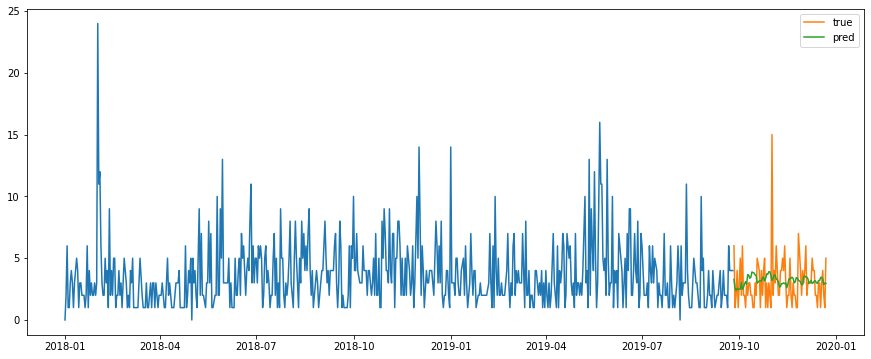

Test MSE: 4.243
Test RMSE: 2.060
Test MAPE: 72.457
성별:  여성  , 연령:  40대


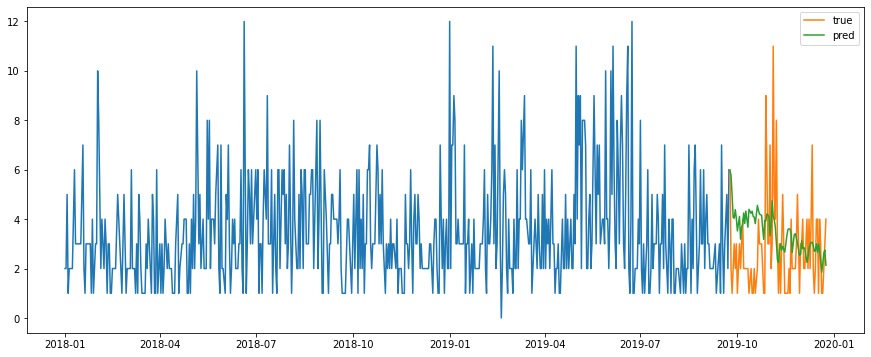

Test MSE: 4.355
Test RMSE: 2.087
Test MAPE: 91.012
성별:  여성  , 연령:  50대


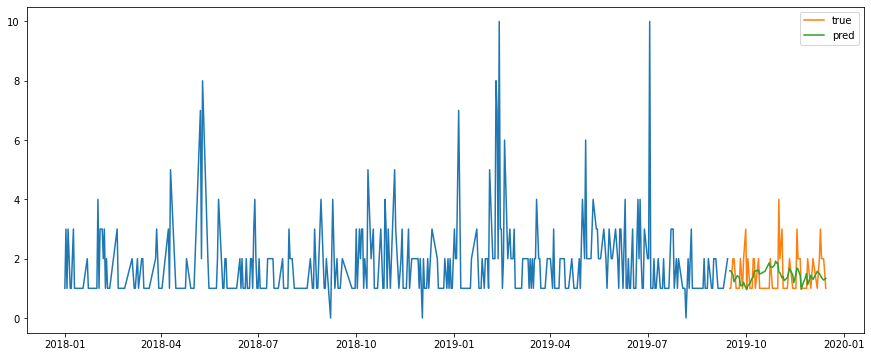

Test MSE: 0.587
Test RMSE: 0.766
Test MAPE: 41.162
성별:  여성  , 연령:  60대


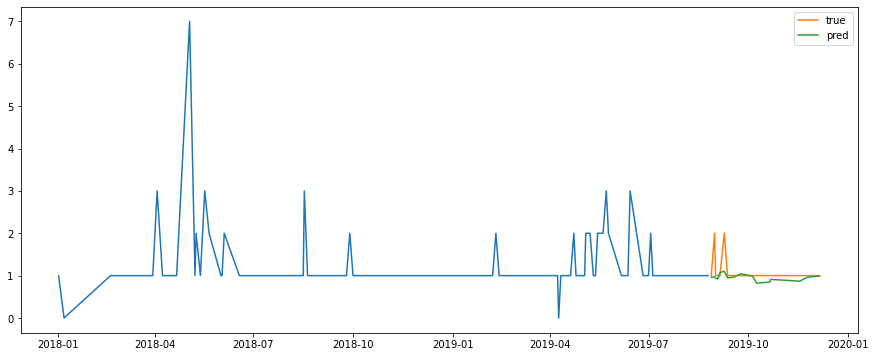

Test MSE: 0.116
Test RMSE: 0.340
Test MAPE: 12.133
소분류:  네일리무버
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


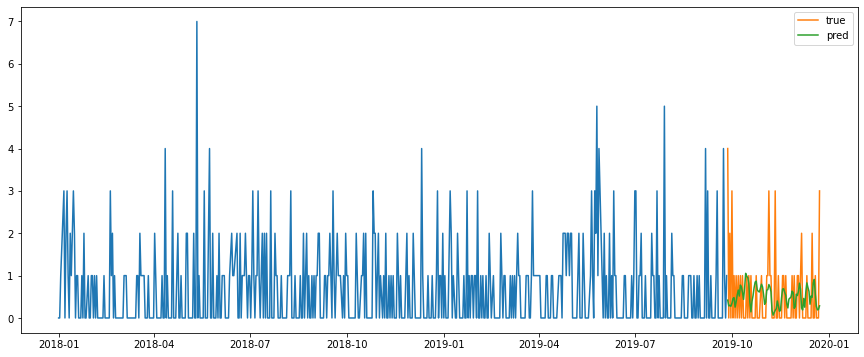

Test MSE: 0.782
Test RMSE: 0.884
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


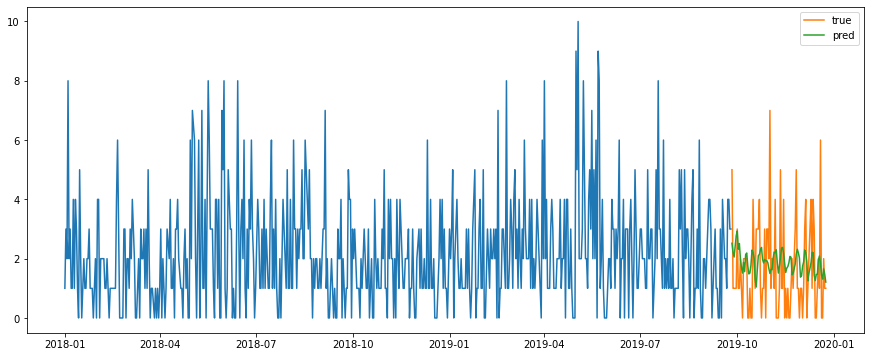

Test MSE: 2.389
Test RMSE: 1.546
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


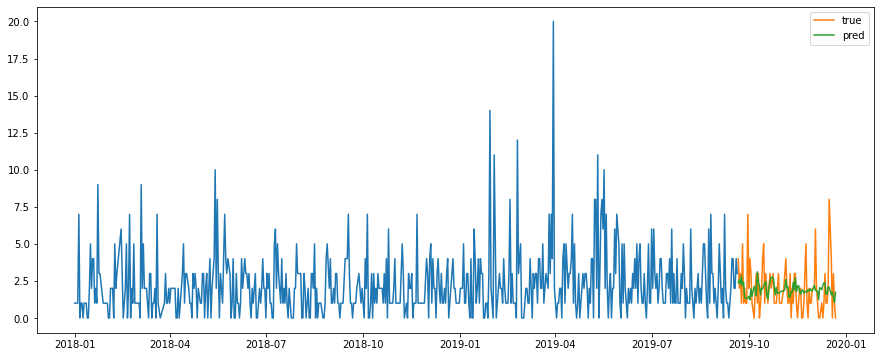

Test MSE: 2.618
Test RMSE: 1.618
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


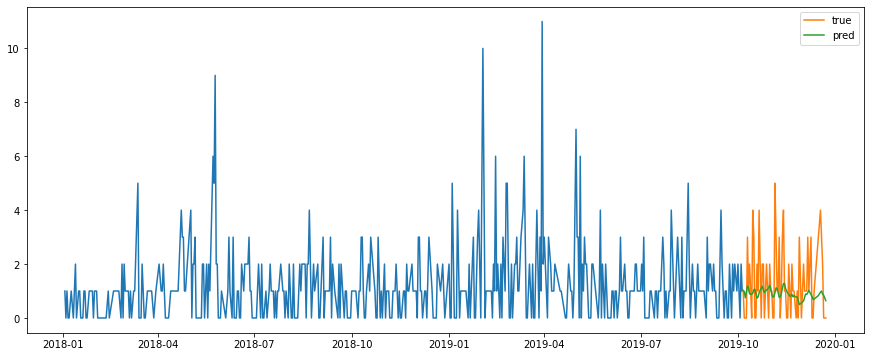

Test MSE: 1.807
Test RMSE: 1.344
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


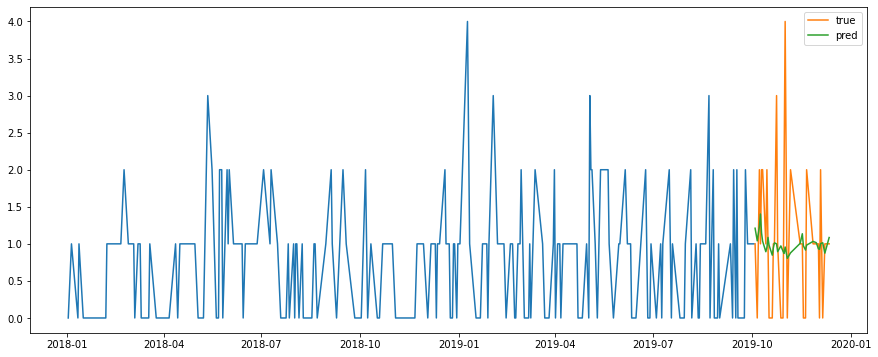

Test MSE: 0.891
Test RMSE: 0.944
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


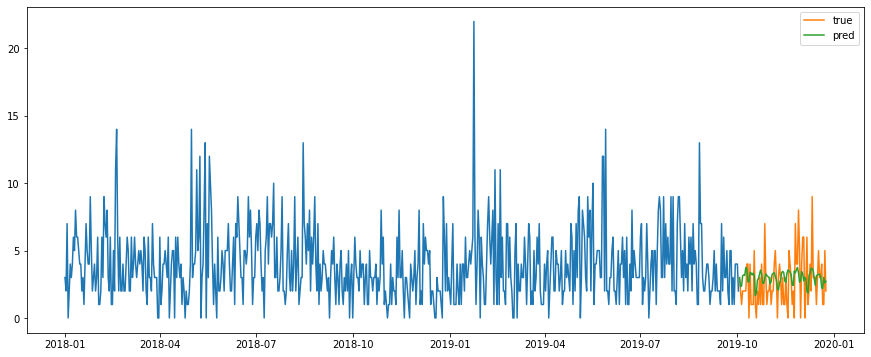

Test MSE: 3.598
Test RMSE: 1.897
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


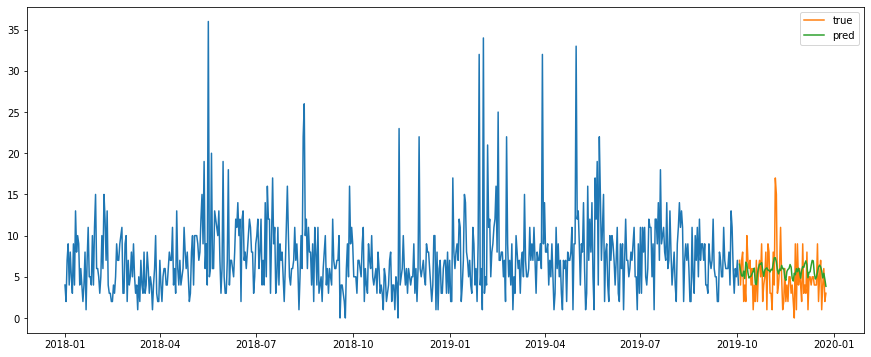

Test MSE: 9.252
Test RMSE: 3.042
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


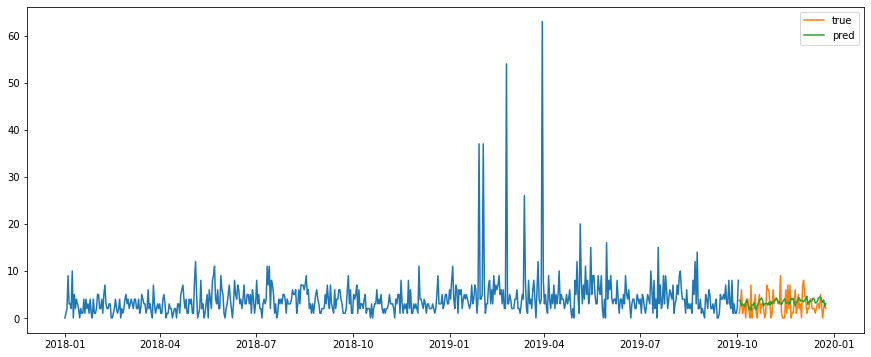

Test MSE: 5.650
Test RMSE: 2.377
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


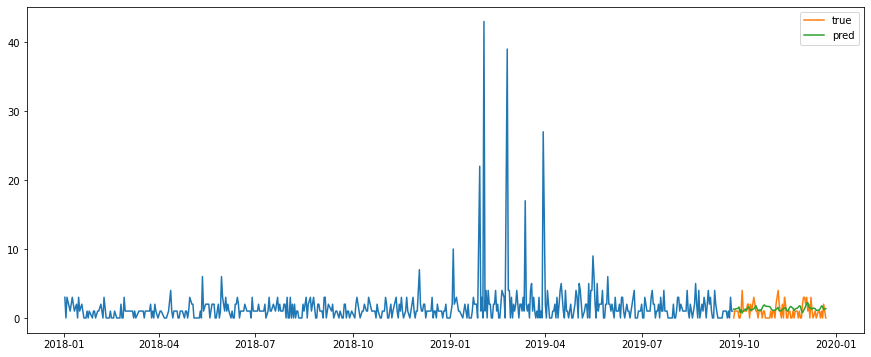

Test MSE: 1.254
Test RMSE: 1.120
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


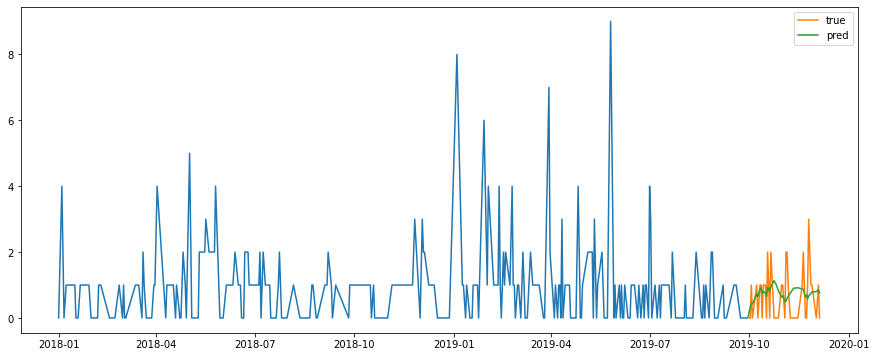

Test MSE: 0.625
Test RMSE: 0.790
Test MAPE: inf
소분류:  네일세트
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


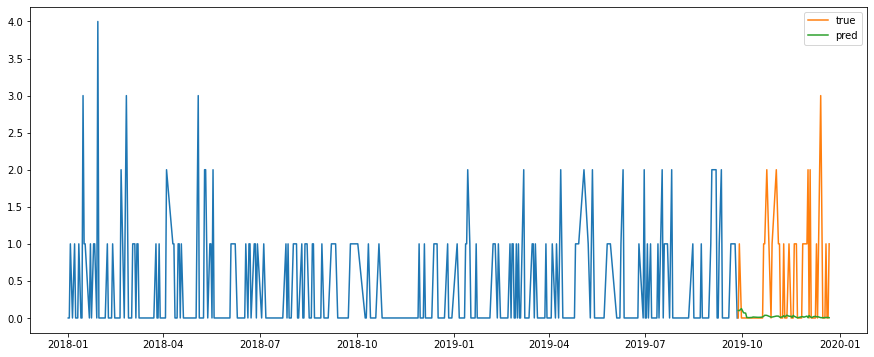

Test MSE: 0.740
Test RMSE: 0.860
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


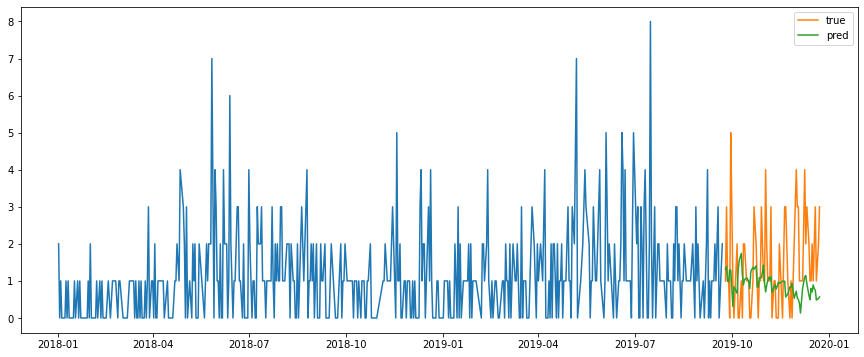

Test MSE: 1.910
Test RMSE: 1.382
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


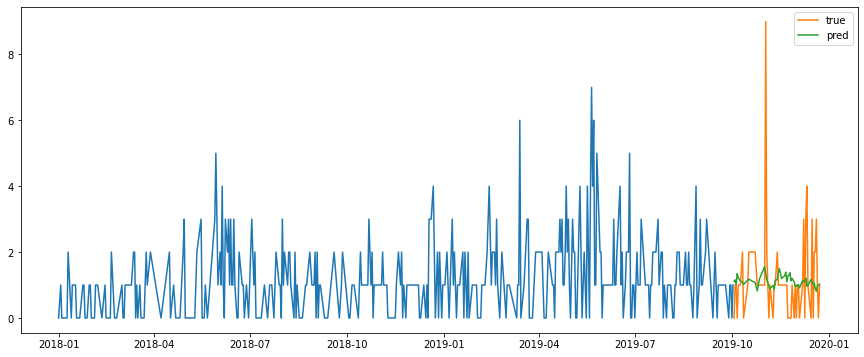

Test MSE: 2.007
Test RMSE: 1.417
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


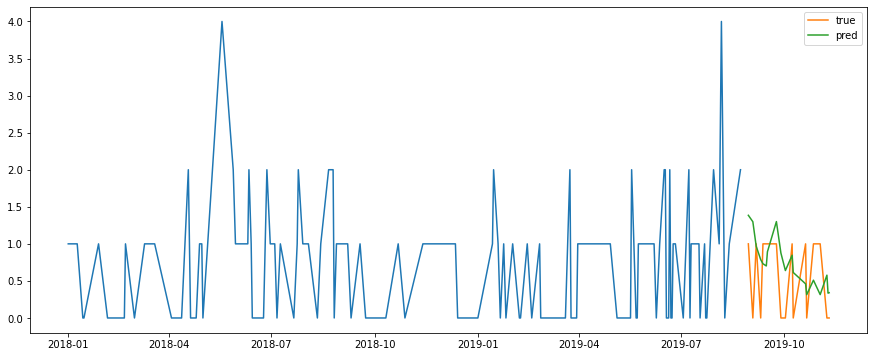

Test MSE: 0.314
Test RMSE: 0.560
Test MAPE: inf
성별:  남성 , 연령:  60대


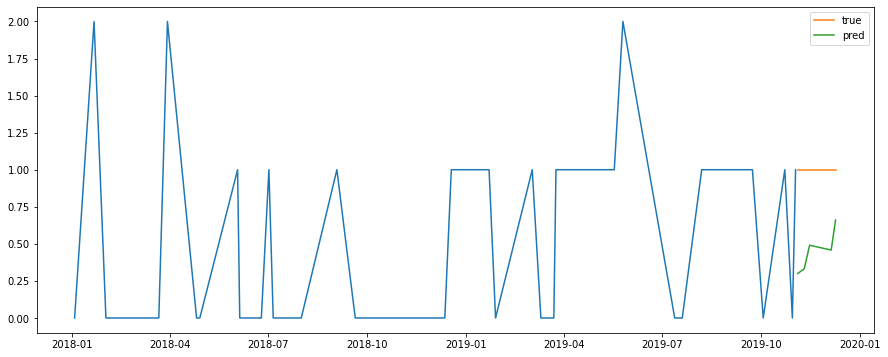

Test MSE: 0.321
Test RMSE: 0.567
Test MAPE: 55.171
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


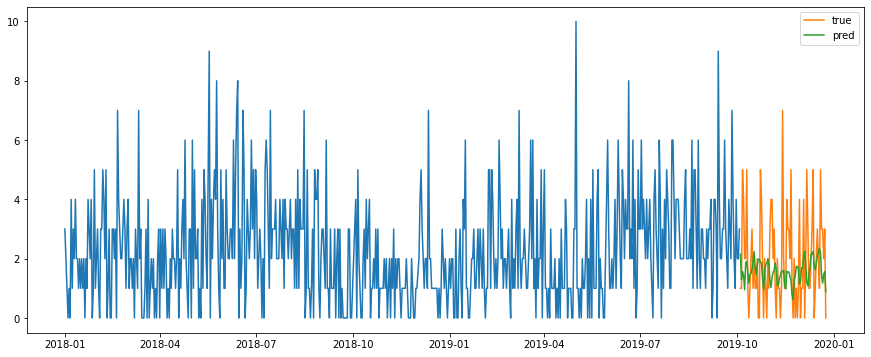

Test MSE: 2.720
Test RMSE: 1.649
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


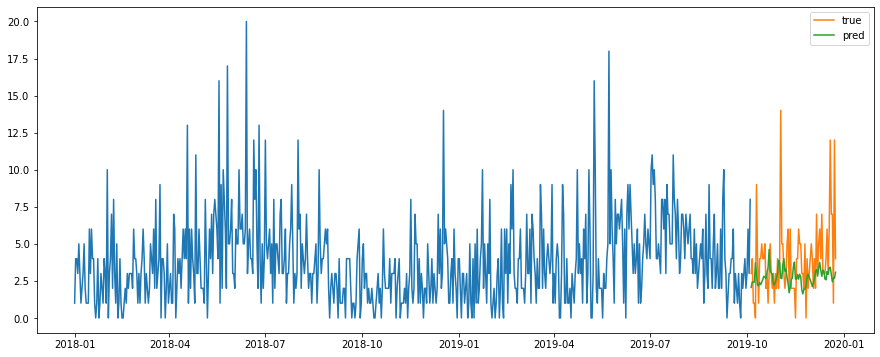

Test MSE: 7.492
Test RMSE: 2.737
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


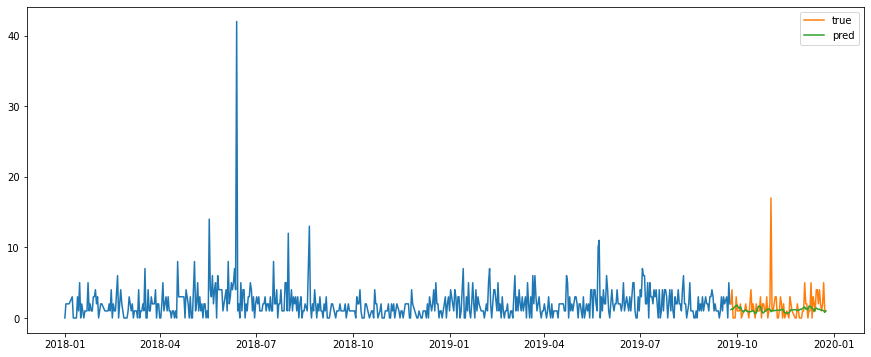

Test MSE: 4.832
Test RMSE: 2.198
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


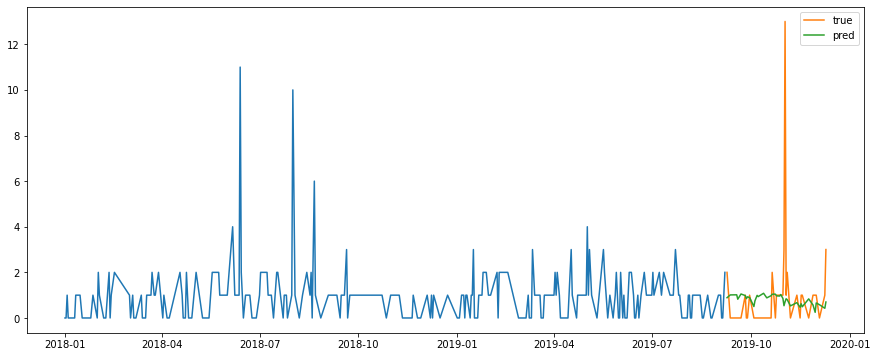

Test MSE: 4.773
Test RMSE: 2.185
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


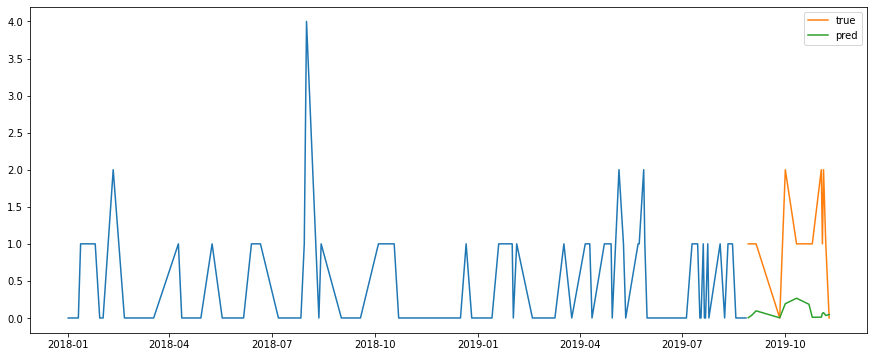

Test MSE: 1.360
Test RMSE: 1.166
Test MAPE: inf
소분류:  네일아트
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


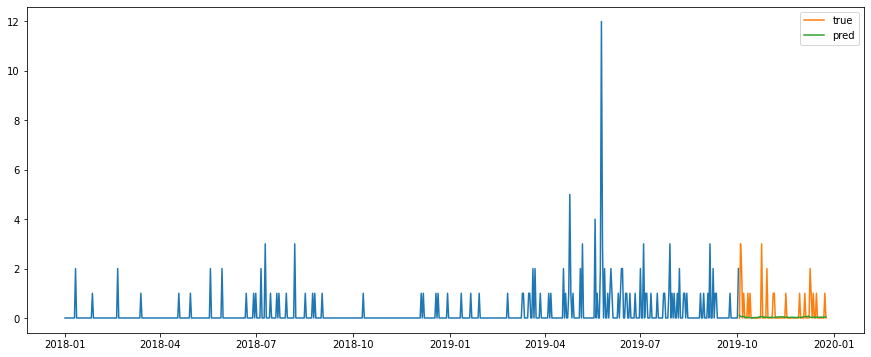

Test MSE: 0.486
Test RMSE: 0.697
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


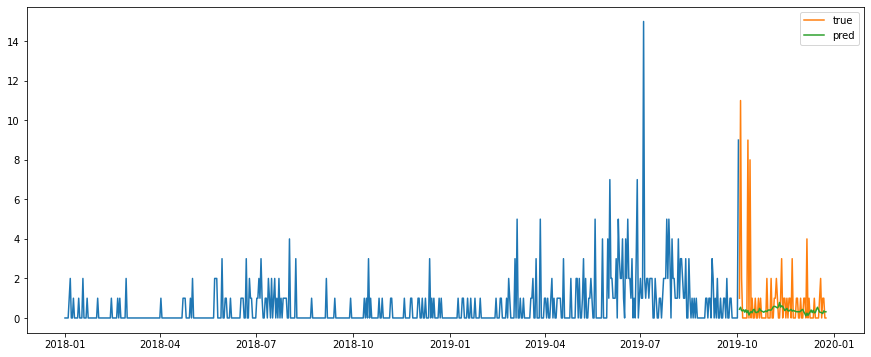

Test MSE: 3.623
Test RMSE: 1.904
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


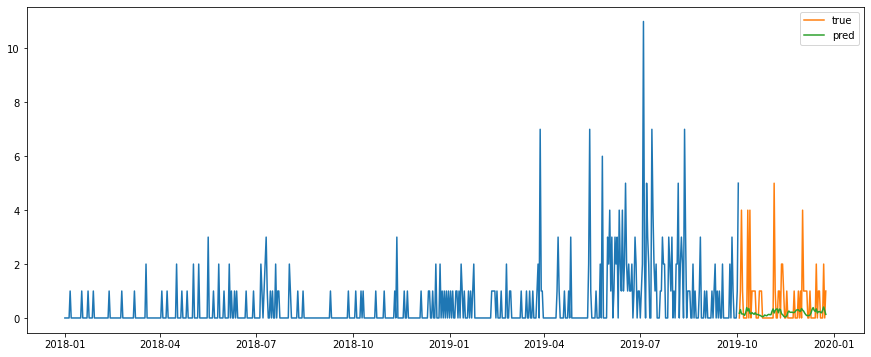

Test MSE: 1.349
Test RMSE: 1.162
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


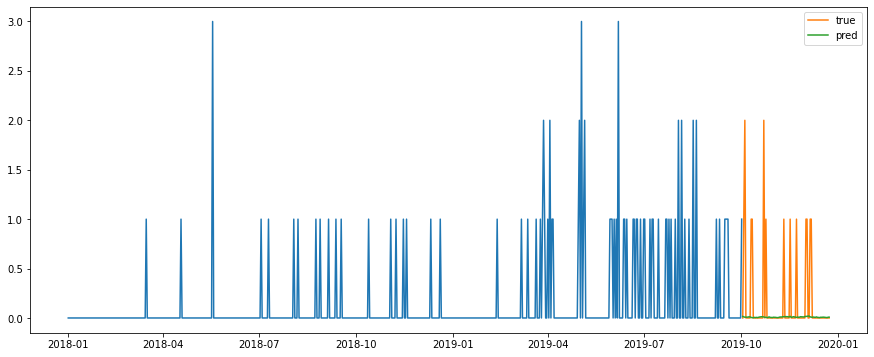

Test MSE: 0.225
Test RMSE: 0.475
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


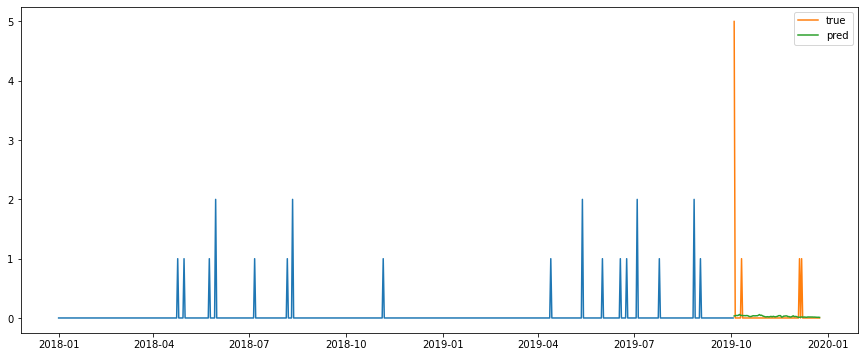

Test MSE: 0.336
Test RMSE: 0.580
Test MAPE: inf
성별:  여성  , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


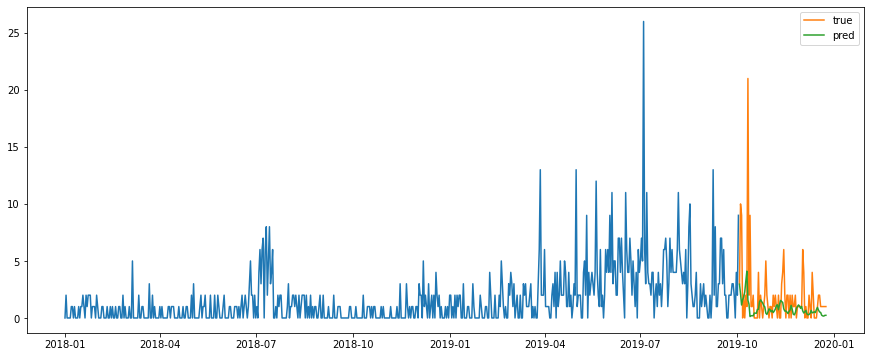

Test MSE: 9.390
Test RMSE: 3.064
Test MAPE: inf
성별:  여성  , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


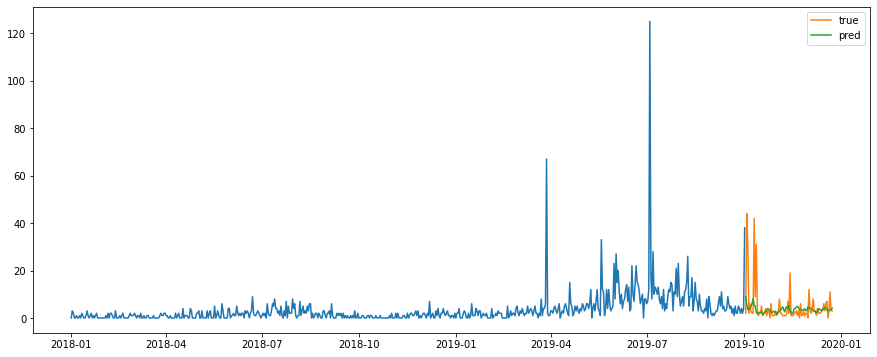

Test MSE: 62.022
Test RMSE: 7.875
Test MAPE: inf
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


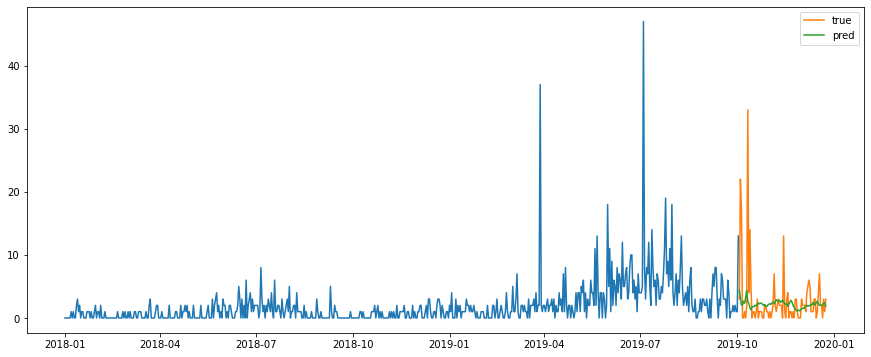

Test MSE: 24.457
Test RMSE: 4.945
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


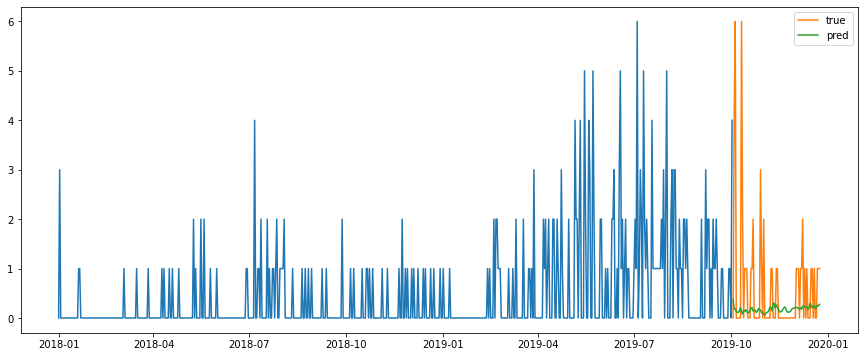

Test MSE: 1.461
Test RMSE: 1.209
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


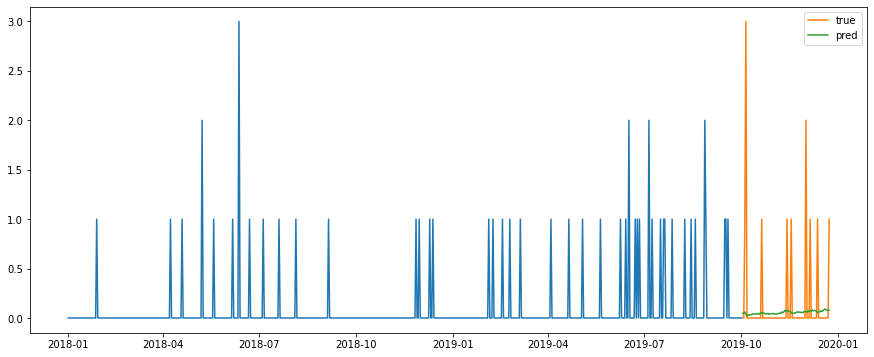

Test MSE: 0.228
Test RMSE: 0.477
Test MAPE: inf
소분류:  네일컬러
성별:  남성 , 연령:  20대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


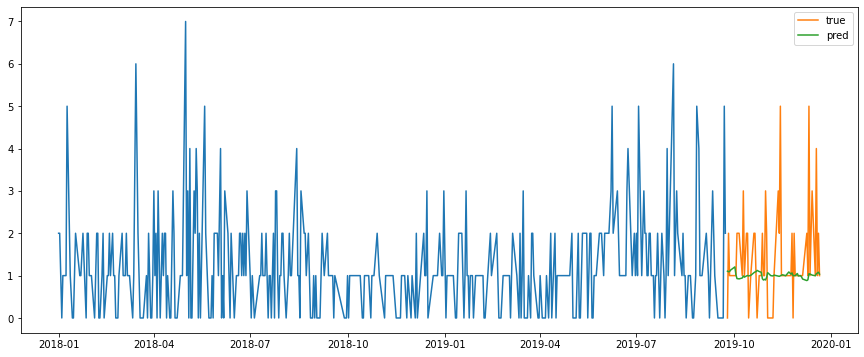

Test MSE: 1.381
Test RMSE: 1.175
Test MAPE: inf
성별:  남성 , 연령:  30대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


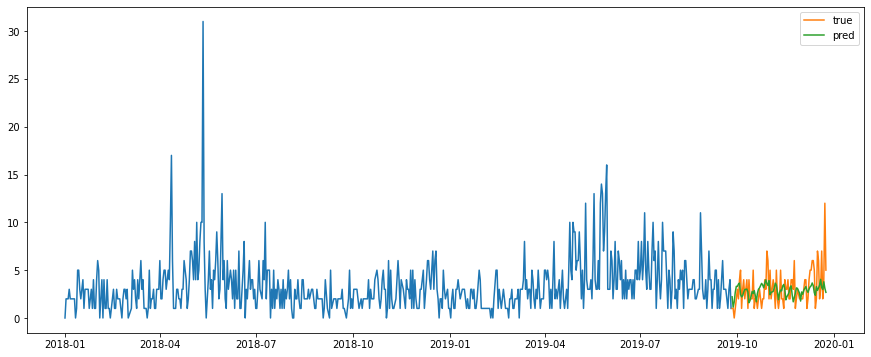

Test MSE: 3.553
Test RMSE: 1.885
Test MAPE: inf
성별:  남성 , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


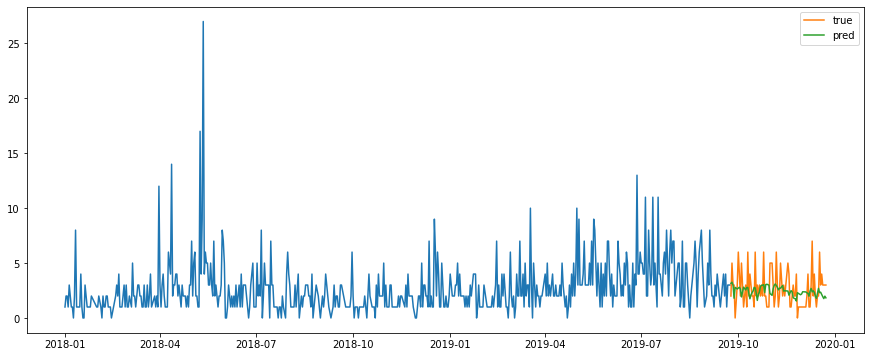

Test MSE: 2.813
Test RMSE: 1.677
Test MAPE: inf
성별:  남성 , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


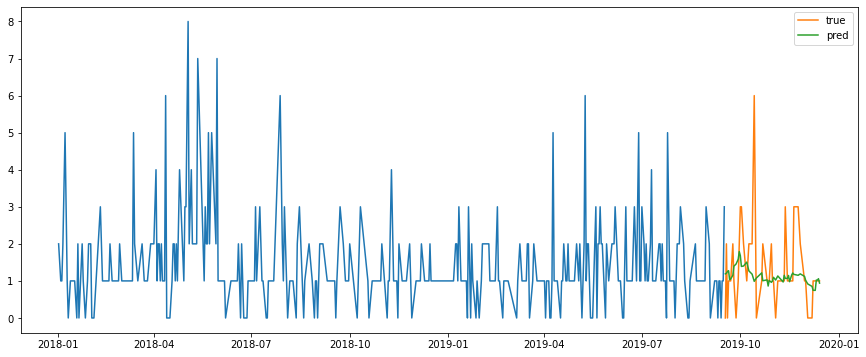

Test MSE: 1.114
Test RMSE: 1.055
Test MAPE: inf
성별:  남성 , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


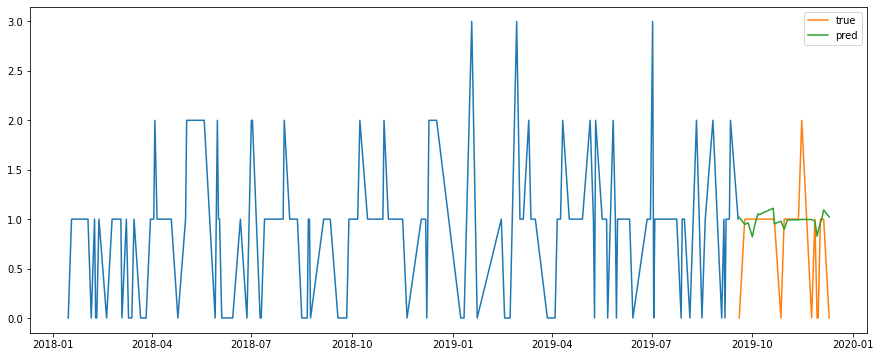

Test MSE: 0.299
Test RMSE: 0.547
Test MAPE: inf
성별:  여성  , 연령:  20대


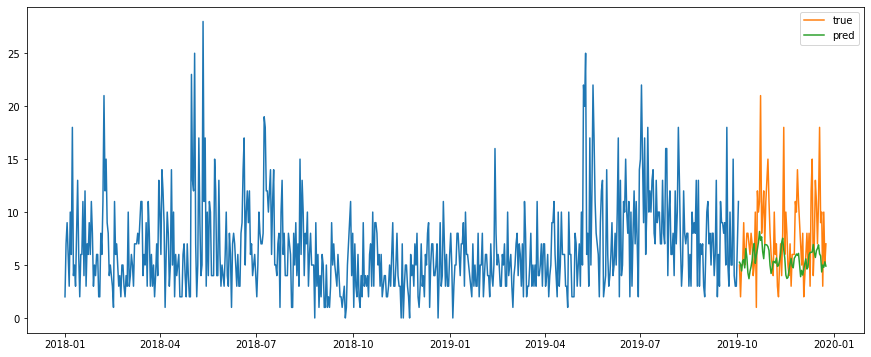

Test MSE: 17.595
Test RMSE: 4.195
Test MAPE: 45.013
성별:  여성  , 연령:  30대


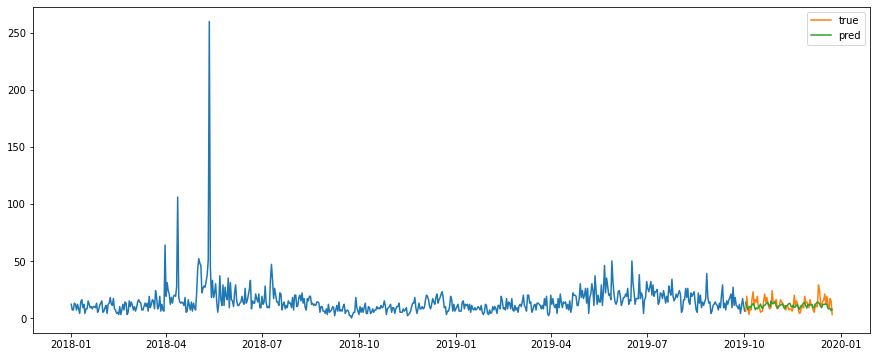

Test MSE: 25.955
Test RMSE: 5.095
Test MAPE: 35.974
성별:  여성  , 연령:  40대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


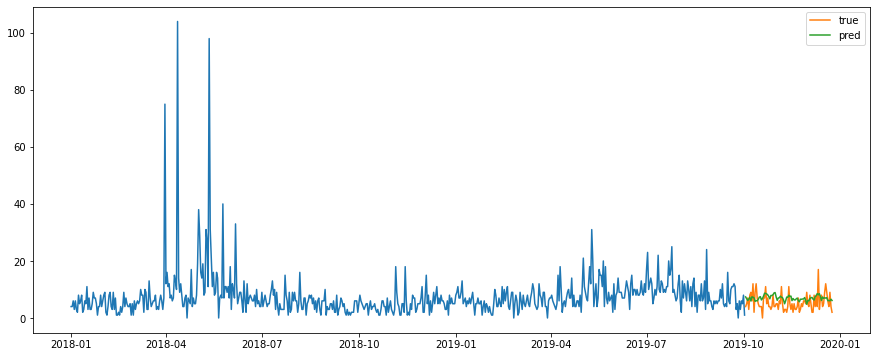

Test MSE: 10.920
Test RMSE: 3.305
Test MAPE: inf
성별:  여성  , 연령:  50대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


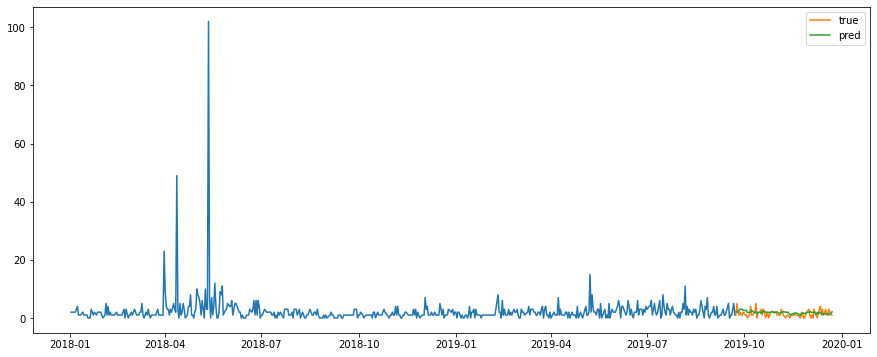

Test MSE: 1.482
Test RMSE: 1.217
Test MAPE: inf
성별:  여성  , 연령:  60대


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


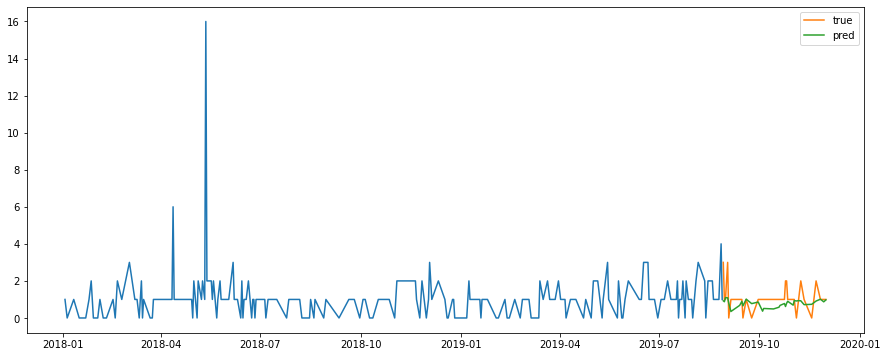

Test MSE: 0.585
Test RMSE: 0.765
Test MAPE: inf


In [27]:
# 숫자만 맞춰서 돌려주세요 감삼당..
for sm_cats in df_lstm['sm_cat'].unique()[:29]:
    print('소분류: ', sm_cats)
    ## 데이터 전처리 ##
    # 각 소분류에 대하여
    df_ex = df_group[df_group['sm_cat']==sm_cats]

    # 성별 1: "여성", 0: "남성"
    for sex in [0,1]:
        df_sex = df_ex[df_ex['sex']==sex]
        
        # 연령
        for age in [[1,0,0,0,0], [0,1,0,0,0], [0,0,1,0,0], [0,0,0,1,0], [0,0,0,0,1]]:
            age_20, age_30, age_40, age_50, age_60 = age[0], age[1], age[2], age[3], age[4]
            df_select = df_sex[(df_sex['age_20']==age_20)&(df_sex['age_30']==age_30)&(df_sex['age_40']==age_40)&(df_sex['age_50']==age_50)&(df_sex['age_60']==age_60)]

            성별 = "여성 "if sex == 1 else "남성"
            연령 = "20대" if age_20 == 1 else "30대" if age_30 == 1 else "40대" if age_40 == 1 else "50대" if age_50 == 1 else "60대"
            print('성별: ', 성별, ", 연령: ", 연령)

            # 지역
            for regions in ['서울','강릉','대구','부산','광주','전주','대전','청주','제주']:
                # 사용할 변수만 선택
                df_select = df_select.rename(columns={"date" : "날짜"})
                default = ['qty', 'ratio','오늘날씨','미세먼지검색량','오늘 비', '기상정보', '태풍정보', 'cnt', '공휴일여부', '주말여부', '날짜']
                causal = []
                df_var = df_causal[df_causal['sm_cat']==sm_cats]
                for cols in df_var.columns.tolist():
                    if len(df_var[df_var[cols]=='causality'])>=1:
                        causal.append(cols)
                default.extend(causal)
                df_use = df_select[default]

                # 지역
                df_merge = df_use.merge(region_weather(regions), on="날짜", how='left')
                df_merge.index = df_merge['날짜']
                df_merge = df_merge.drop(['날짜'], axis=1)

                # 스케일링
                scaler = MinMaxScaler(feature_range=(0, 1))
                df_scale = scaler.fit_transform(df_merge)

                # 데이터 프레임
                n_hours = 7; n_features = df_merge.shape[1]
                df_reframe = series_to_supervised(df_scale, n_hours, 1)

                # 트테분리
                values = df_reframe.values
                n_train_hours = round(df_reframe.shape[0]*0.875) if df_reframe.shape[0] < 720 else 730 - 90
                train = values[:n_train_hours, :]
                test = values[n_train_hours:, :]
                # split into input and outputs
                n_obs = n_hours * n_features
                train_X, train_y = train[:, :n_obs], train[:, -n_features]
                test_X, test_y = test[:, :n_obs], test[:, -n_features]
                # reshape input to be 3D [samples, timesteps, features]
                train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
                test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
                
                ## 모델링 ##
                # design network
                model = Sequential()
                model.add(LSTM(50, input_shape=(train_X.shape[1], train_X.shape[2])))
                model.add(Dense(1))
                model.compile(loss='mae', optimizer='adam')

                # fit network
                # verbose = 0: 결과 출력 안하는 옵션
                history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=0, shuffle=False)

                # make a prediction
                yhat = model.predict(test_X)
                test_X = test_X.reshape((test_X.shape[0], n_hours*n_features))
                # invert scaling for forecast
                inv_yhat = np.concatenate((yhat, test_X[:, -(n_features-1):]), axis=1)
                inv_yhat = scaler.inverse_transform(inv_yhat)
                inv_yhat = inv_yhat[:,0]
                inv_yhat = list([0  if  x<0 else x for x in inv_yhat])
                locals()['pred_'+regions] = inv_yhat
                # invert scaling for actual
                test_y = test_y.reshape((len(test_y), 1))
                inv_y = np.concatenate((test_y, test_X[:, -(n_features-1):]), axis=1)
                inv_y = scaler.inverse_transform(inv_y)
                inv_y = inv_y[:,0]

            # 지역별 가중치 합
            y_pred = loc_weighted_sum(pred_서울, pred_강릉, pred_대구, pred_부산, pred_광주, pred_전주, pred_대전, pred_청주, pred_제주)

            # calculate RMSE
            mse = mean_squared_error(inv_y, y_pred)
            rmse = np.sqrt(mean_squared_error(inv_y, y_pred))
            mape = MAPE(inv_y, y_pred)
            mse_ls.append(mse); rmse_ls.append(rmse); mape_ls.append(mape)

            # plot predict
            plt.figure(figsize=(15,6))
            plt.plot(df_use.iloc[:n_train_hours,:]['qty'])
            plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, inv_y, label='true')
            plt.plot(df_use.iloc[n_train_hours:-n_hours,:].index, y_pred, label='pred')
            plt.legend()
            plt.show()
            
            print('Test MSE: %.3f' % mse)
            print('Test RMSE: %.3f' % rmse)
            print('Test MAPE: %.3f' % mape)
            print('=========='*10)

            # result
            date.append(df_use.iloc[n_train_hours:-n_hours,:].index)
            sex_ls.append(성별)
            age_ls.append(연령)
            sm_cat.append(sm_cats)
            pred.append(inv_yhat) 
            

In [28]:
# prediction
df_result = pd.DataFrame(columns=['date','sex','age','sm_cat','pred'])
for i in range(len(sm_cat)):
    df_result = pd.concat([df_result, pd.DataFrame({'date':date[i],'pred':pred[i],'sm_cat':sm_cat[i],'sex':sex_ls[i],'age':age_ls[i]})])

df_result.reset_index(drop=True).to_csv('df_pred.csv', encoding='CP949', index=False)

In [29]:
# metric
df_metric = pd.DataFrame({'age':age_ls,'sex':sex_ls,'sm_cat':sm_cat,'mse':mse_ls,'rmse':rmse_ls,'mape':mape_ls})
df_metric.to_csv('df_metric.csv', encoding='CP949', index=False)